
# Projet 6 - Classification Automatique des Biens de Consommation

## Partie 2 de 3

# 1. Introduction

## 1.1 Le Contexte

L’entreprise "Place de marché", qui souhaite lancer une marketplace e-commerce, voudrait mettre en place un moteur de classification: la catégorie d'un article est attribuée automatiquement après le téléchargement d'une photo de l'article. L'entreprise attend que un tel moteur de classification a les bénéfices suivantes :
* augmenter la fiabilité de la classification
* une facilité d'utilisation 
    * pour les vendeurs (qui entrent pour l'instant entrent cette info manuellement)
    * pour les achêteurs pour leur recherche de produit

## 1.2 Objectif

* **Etudier la faisabilité d'un moteur de classification** 
    * analyse de jeu de données
    * prétraitement des déscriptions (texte) et des images
    * réduction de dimension
    * clustering

## 1.3 Résumé de ce Notebook

Dans ce notebook, on traite le texte tokenisé et lemmatisé de de la description du produit, réduit les dimensions (le nombre de tokens/features, fait des projections en 2-D) et fait du clustering pour évaluer la faisabilité d'un moteur de classification basé sur une description de produit.
Finalement, on fait des premiers modèles de classifications.

Conclusions:
* Après des règles de selection (stopwords du corpus, mots infréquents, p_value), on va de environ 4600-4800 tokens à environ 800 tokens.
* Après un PCA(0.99), on arrive à environ 450 features.
* Les catégories sont plutôt groupées dans une projection T-SNE.
* Les clustings donne des valeurs de RAND ajusté entre 0.2 à 0.45 et des accuracies de 0.53 à 0.74.
* Les modèles de classification donnent des accuracies d'environ 0.9.
* Une classification avec une déscription de produit est faisable.
* Faut adapter les dictionaires et stopwords au corpus. Appliquer des dictionnaires de métier pour amméliorer la lemmatisation, etc.

# 2. Les Imports

## 2.1 Les Bibliothèques et Styles

In [1]:
import re, os, random

from time import time

from math import ceil
# a convenient module for punctuation signs
import string

from itertools import zip_longest

#data modules
import numpy as np
import pandas as pd
import scipy as sp
from scipy.stats import chisquare
from scipy.sparse import csr_matrix

#graphic modules
import matplotlib.pyplot as plt
from matplotlib.image import imread
from matplotlib.colors import ListedColormap


#import matplotlib.dates as dates
import seaborn as sns

In [2]:
# import the wordcloud library
from wordcloud import WordCloud

In [3]:
from collections import defaultdict
from collections import Counter

In [4]:
from sklearn.model_selection import StratifiedKFold, train_test_split, GridSearchCV, cross_validate
from sklearn.preprocessing import LabelEncoder, FunctionTransformer, MinMaxScaler

from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer, TfidfTransformer
from sklearn.feature_selection import SelectKBest, SelectFpr, chi2

from sklearn.decomposition import TruncatedSVD, PCA
from sklearn.manifold import MDS, Isomap, LocallyLinearEmbedding, TSNE, SpectralEmbedding
from sklearn.random_projection import SparseRandomProjection

from sklearn.pipeline import Pipeline, make_pipeline

from sklearn.discriminant_analysis import LinearDiscriminantAnalysis

from sklearn.naive_bayes import MultinomialNB, ComplementNB, GaussianNB
from sklearn.neighbors import KNeighborsClassifier, NeighborhoodComponentsAnalysis
from sklearn.mixture import GaussianMixture
from sklearn.cluster import KMeans, AgglomerativeClustering, Birch, DBSCAN, MiniBatchKMeans, OPTICS, SpectralClustering
from sklearn.ensemble import RandomTreesEmbedding


from sklearn.metrics import accuracy_score, classification_report
from sklearn import metrics

In [5]:
%matplotlib inline

## 2.2 Les Fonctions

#### Traitement de Texte Tokenisé

In [6]:
def token_counter(doc_srs):
    '''Create a Counter object, which counts the occurences of the tokens in a corpus.'''
    all_tokens = ' '.join(doc_srs).split()
    return Counter(all_tokens)

#### Visualisation des Données / Projection en 2d

In [7]:
def plot_embedding(X, y, title, ax):
    X = MinMaxScaler().fit_transform(X)
    scatter = ax.scatter(X[:,0], X[:,1], c=y, cmap=ListedColormap(sns.color_palette('tab10'), N=len(set(y))), s=6)
    ax.set_title(title)
    ax.axis("off")
    return scatter

#### Transformers Customisés

In [8]:
toarray_transformer = FunctionTransformer(func = lambda x : x.toarray(), 
                                          inverse_func = csr_matrix, accept_sparse=True, check_inverse=True,)

#### Optimisation des Modèles

In [9]:
def gridsearch_evaluation(X_train, y_train, pipeline, param_grid, cv = None, 
                          scoring_tple = None, refit = 'accuracy') :
    
    grid = GridSearchCV(pipeline, param_grid, cv = cv, 
                        scoring = scoring_tple,
                        return_train_score = True, refit=refit, verbose=1)
    #print(grid.__dict__)
    grid.fit(X_train, np.ravel((y_train)))
    
    eval_dict = {}
    test_scoring_dict ={}
    train_scoring_dict = {}
    if refit :
        for i in scoring_tple :
            test_scoring_dict[i] = (grid.cv_results_["mean_test_" + i][grid.best_index_], 
                                    grid.cv_results_["std_test_" + i][grid.best_index_])
            train_scoring_dict[i] = (grid.cv_results_["mean_train_" + i][grid.best_index_], 
                                     grid.cv_results_["std_train_" + i][grid.best_index_])

        train_time = (grid.cv_results_["mean_fit_time"][grid.best_index_],
                      grid.cv_results_["std_fit_time"][grid.best_index_])

        eval_dict = {'estimator' : grid.best_estimator_,
                     'eval_method' : 'grid',
                     'best_grid_params' : grid.best_params_,
                     'train_scores' : train_scoring_dict, 
                     'test_scores' : test_scoring_dict, 
                     'train_time' : train_time }
    return eval_dict

#### Collections du Data, des Résultats

In [10]:
vocabulary_sets = {}
X_datas = {}
preprocessors = {}
X_projections = {}
X_labels = {}

## 2.3 Les Données

In [11]:
PATH = os.getcwd() + '\\Data\\'
filename = 'Text_Tokenized.csv'
text_df = pd.read_csv(PATH + filename)

In [12]:
text_df

,Unnamed: 0,image_id,product_name,category_level1,category_level2,document_nltk,document_spacy,document_nltk_2,document_spacy_2,document_nltk_3,document_spacy_3
0,0,55b85ea15a1536d46b7190ad6fff8ce7,Elegance Polyester Multicolor Abstract Eyelet ...,Home Furnishing,Curtains & Accessories,key features elegance polyester multicolor abs...,key features elegance polyester multicolor abs...,key features elegance polyester multicolor abs...,key features elegance polyester multicolor abs...,key elegance polyester multicolor abstract eye...,key elegance polyester multicolor abstract eye...
1,1,7b72c92c2f6c40268628ec5f14c6d590,Sathiyas Cotton Bath Towel,Baby Care,Baby Bath & Skin,specifications sathiyas cotton bath towel 3 ba...,specification sathiyas cotton bath towel 3 bat...,specifications sathiyas cotton bath towel bath...,specification sathiyas cotton bath towel bath ...,sathiyas cotton bath towel bath towel red yell...,sathiyas cotton bath towel bath towel red yell...
2,2,64d5d4a258243731dc7bbb1eef49ad74,Eurospa Cotton Terry Face Towel Set,Baby Care,Baby Bath & Skin,key features eurospa cotton terry face towel s...,key features eurospa cotton terry face towel s...,key features eurospa cotton terry face towel s...,key features eurospa cotton terry face towel s...,key eurospa cotton terry face towel set small ...,key eurospa cotton terry face towel set small ...
3,3,d4684dcdc759dd9cdf41504698d737d8,SANTOSH ROYAL FASHION Cotton Printed King size...,Home Furnishing,Bed Linen,key features santosh royal fashion cotton prin...,key features santosh royal fashion cotton prin...,key features santosh royal fashion cotton prin...,key features santosh royal fashion cotton prin...,key santosh royal fashion cotton printed king ...,key santosh royal fashion cotton printed king ...
4,4,6325b6870c54cd47be6ebfbffa620ec7,Jaipur Print Cotton Floral King sized Double B...,Home Furnishing,Bed Linen,key features jaipur print cotton floral king s...,key features jaipur print cotton floral king s...,key features jaipur print cotton floral king s...,key features jaipur print cotton floral king s...,key jaipur print cotton floral king double bed...,key jaipur print cotton floral king double bed...
...,...,...,...,...,...,...,...,...,...,...,...
1045,1045,958f54f4c46b53c8a0a9b8167d9140bc,Oren Empower Extra Large Self Adhesive Sticker,Baby Care,Baby & Kids Gifts,oren empower extra large self adhesive sticker...,oren empower extra large self adhesive sticker...,oren empower extra large self adhesive sticker...,oren empower extra large self adhesive sticker...,oren empower extra large self adhesive sticker...,oren empower extra large self adhesive sticker...
1046,1046,fd6cbcc22efb6b761bd564c28928483c,Wallmantra Large Vinyl Sticker Sticker,Baby Care,Baby & Kids Gifts,wallmantra large vinyl sticker sticker pack 1 ...,wallmantra large vinyl sticker sticker pack 1 ...,wallmantra large vinyl sticker sticker pack pr...,wallmantra large vinyl sticker sticker pack pr...,wallmantra large vinyl sticker sticker bring h...,wallmantra large vinyl sticker sticker bring h...
1047,1047,5912e037d12774bb73a2048f35a00009,Uberlyfe Extra Large Pigmented Polyvinyl Films...,Baby Care,Baby & Kids Gifts,buy uberlyfe extra large pigmented polyvinyl f...,buy uberlyfe extra large pigment polyvinyl fil...,buy uberlyfe extra large pigmented polyvinyl f...,buy uberlyfe extra large pigment polyvinyl fil...,uberlyfe extra large pigmented polyvinyl films...,uberlyfe extra large pigment polyvinyl films i...
1048,1048,c3edc504d1b4f0ba6224fa53a43a7ad6,Wallmantra Medium Vinyl Sticker Sticker,Baby Care,Baby & Kids Gifts,buy wallmantra medium vinyl sticker sticker rs...,buy wallmantra medium vinyl sticker sticker rs...,buy wallmantra medium vinyl sticker sticker rs...,buy wallmantra medium vinyl sticker sticker rs...,wallmantra medium vinyl sticker sticker wallma...,wallmantra medium vinyl sticker sticker wallma...


In [13]:
text_df = text_df.drop(columns = ['Unnamed: 0'])

In [14]:
token_counter(text_df['document_spacy_2'])['good']

254

# 3. Prétraitement - Version 1

## 3.1 Les Categories - le target

In [15]:
le = LabelEncoder()
cat = 'category_level1'
y = le.fit_transform(text_df[cat])

## 3.2 Les Documents - les variables

In [16]:
X = pd.DataFrame()
tokenizer_versions = ['nltk', 'spacy']
for tok_ver in tokenizer_versions:
    X[tok_ver] = text_df['document_' + tok_ver + '_2']

## 3.3 Le Prétraitement - réduction de Vocabulaire et de Dimension

In [17]:
preprocessor_ver = 'Version1'
ngram_range = (1,1)
max_df = 2/7
min_df = 0.03/7
alpha = 0.01
n_components = 0.99

In [18]:
vectorizer = CountVectorizer(max_df = max_df, min_df = min_df)
selector = SelectFpr(chi2, alpha=alpha)
transformer = TfidfTransformer()
pca = PCA(n_components=n_components, svd_solver = 'full')

### 3.3.1 Réduction de Vocabulaire avec CountVectorizer et SelectFpr(alpha=0.01)

In [19]:
X_vec = {}
X_prep = {}

In [20]:
for tok_ver in tokenizer_versions :
    X_vec[tok_ver] = vectorizer.fit_transform(X[tok_ver])
    X_vec[tok_ver] = selector.fit_transform(X_vec[tok_ver], y)
    vocab_dict = vectorizer.vocabulary_
    vocab_dict_rev = {v:k for k,v in vocab_dict.items()}
    reduced_vocab_dict = { vocab_dict_rev[int(x.lstrip('x'))]  : int(x.lstrip('x')) for x in selector.get_feature_names_out()}
    data_ver = '_'.join([tok_ver, preprocessor_ver])
    vocabulary_sets[data_ver] = vocab_dict.copy()
    vocabulary_sets[data_ver+'_red'] = reduced_vocab_dict.copy()
    print(f"The vocabulary for the {tok_ver} tokenized data was reduced from " +
          f"{len(vocab_dict)} to {len(reduced_vocab_dict)} words.")

The vocabulary for the nltk tokenized data was reduced from 951 to 814 words.
The vocabulary for the spacy tokenized data was reduced from 925 to 785 words.


### 3.3.2 Réduction de Dimension avec TfidfTransformer et PCA(n_components=0.99)

In [21]:
for tok_ver in tokenizer_versions :
    X_vec[tok_ver] = transformer.fit_transform(X_vec[tok_ver])
    X_prep[tok_ver] = pca.fit_transform(X_vec[tok_ver].toarray())
    data_ver = '_'.join([tok_ver, preprocessor_ver])
    print(f"The number of dimensions the {tok_ver} tokenized data was reduced from " +
          f"{len(vocabulary_sets[data_ver+'_red'])} to {X_prep[tok_ver].shape[1]}.")

The number of dimensions the nltk tokenized data was reduced from 814 to 440.
The number of dimensions the spacy tokenized data was reduced from 785 to 433.


## 3.4 Le Preprocessor - rationalisation du prétraitement

In [22]:
preprocessor = Pipeline(steps=[('vectorizer', vectorizer),
                               ('selector', selector),
                               ('transformer', transformer),
                               ('toarray', toarray_transformer),
                               ('pca', pca),
                               ])

In [23]:
for tok_ver in tokenizer_versions :
    data_ver = '_'.join([tok_ver, preprocessor_ver])
    X_datas[data_ver] = preprocessor.fit_transform(X[tok_ver], y)
    preprocessors[data_ver] = preprocessor

## 3.5 Projection en 2D 

### 3.5.0 Initialisation

In [24]:
preprocessor_ver = 'Version1'
for tok_ver in tokenizer_versions :
    data_ver = '_'.join([tok_ver, preprocessor_ver])
    X_projections[data_ver] = {}

### 3.5.1 Les Différentes Projections

#### PCA

In [25]:
proj_name = "PCA"
proj = PCA(n_components=2)
for tok_ver in tokenizer_versions :
    data_ver = '_'.join([tok_ver, preprocessor_ver])
    X_tmp = proj.fit_transform(X_datas[data_ver])
    X_projections[data_ver][proj_name] = {"X_proj" : X_tmp}

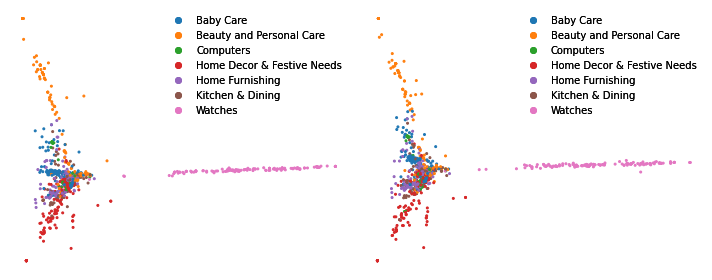

In [26]:
fig, axs = plt.subplots(1,2, figsize=(10,4))
for i, tok_ver in enumerate(tokenizer_versions) :
    data_ver = '_'.join([tok_ver, preprocessor_ver])
    X_tmp = X_projections[data_ver][proj_name]["X_proj"]
    output = axs[i].scatter(X_tmp[:,0], X_tmp[:,1], c=y, 
            cmap=ListedColormap(sns.color_palette('tab10'), N=len(set(y))), s=4)
    legend1 = axs[i].legend(output.legend_elements()[0], le.inverse_transform([i for i in range(7)]),
                    loc="upper right", frameon=False)
    axs[i].add_artist(legend1)
    axs[i].axis('off')
    #plt.xlim(-0.0005, 0.0005)
    #plt.ylim(-0.001, 0.0005)
plt.tight_layout()

#### MDS

In [27]:
proj_name = "MDS"
proj = MDS(n_components=2, random_state = 33)
for tok_ver in tokenizer_versions :
    data_ver = '_'.join([tok_ver, preprocessor_ver])
    X_tmp = proj.fit_transform(X_datas[data_ver])
    X_projections[data_ver][proj_name] = {"X_proj" : X_tmp}

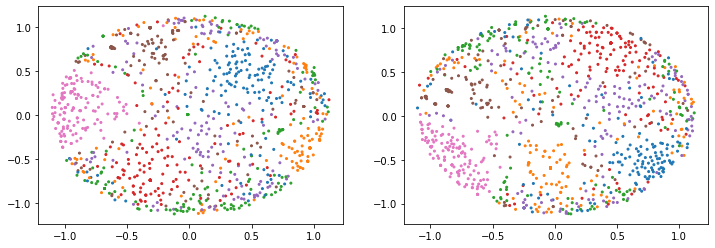

In [28]:
fig, axs = plt.subplots(1,2, figsize=(12,4))
for i, tok_ver in enumerate(tokenizer_versions) :
    data_ver = '_'.join([tok_ver, preprocessor_ver])
    X_tmp = X_projections[data_ver][proj_name]["X_proj"]
    axs[i].scatter(X_tmp[:,0], X_tmp[:,1], c=y, 
            cmap=ListedColormap(sns.color_palette('tab10'), N=len(set(y))), s=4)
    #plt.xlim(-0.0005, 0.0005)
    #plt.ylim(-0.001, 0.0005)
plt.show()

#### Isomap

In [29]:
proj_name = "Isomap"
proj = Isomap(n_components=2, eigen_solver='dense', n_neighbors=80)
for tok_ver in tokenizer_versions :
    data_ver = '_'.join([tok_ver, preprocessor_ver])
    X_tmp = proj.fit_transform(X_datas[data_ver])
    X_projections[data_ver][proj_name] = {"X_proj" : X_tmp}

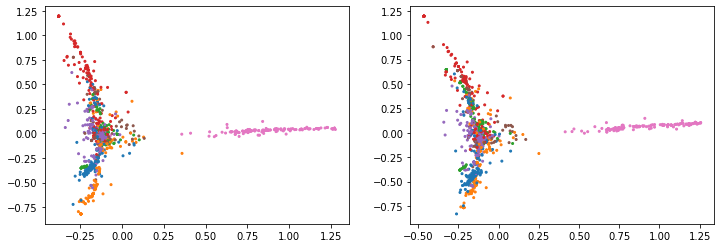

In [30]:
fig, axs = plt.subplots(1,2, figsize=(12,4))
for i, tok_ver in enumerate(tokenizer_versions) :
    data_ver = '_'.join([tok_ver, preprocessor_ver])
    X_tmp = X_projections[data_ver][proj_name]["X_proj"]
    axs[i].scatter(X_tmp[:,0], X_tmp[:,1], c=y, 
            cmap=ListedColormap(sns.color_palette('tab10'), N=len(set(y))), s=4)
    #plt.xlim(-0.0005, 0.0005)
    #plt.ylim(-0.001, 0.0005)
plt.show()

#### TSNE0

In [31]:
proj_name = "TSNE0"
proj = TSNE(n_components=2, init='pca',random_state=33, angle=0.85)
for tok_ver in tokenizer_versions :
    data_ver = '_'.join([tok_ver, preprocessor_ver])
    X_tmp = proj.fit_transform(X_datas[data_ver])
    X_projections[data_ver][proj_name] = {"X_proj" : X_tmp}

c:\users\bookj\environments\jupenv\lib\site-packages\sklearn\manifold\_t_sne.py:790: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
c:\users\bookj\environments\jupenv\lib\site-packages\sklearn\manifold\_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(
c:\users\bookj\environments\jupenv\lib\site-packages\sklearn\manifold\_t_sne.py:790: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
c:\users\bookj\environments\jupenv\lib\site-packages\sklearn\manifold\_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


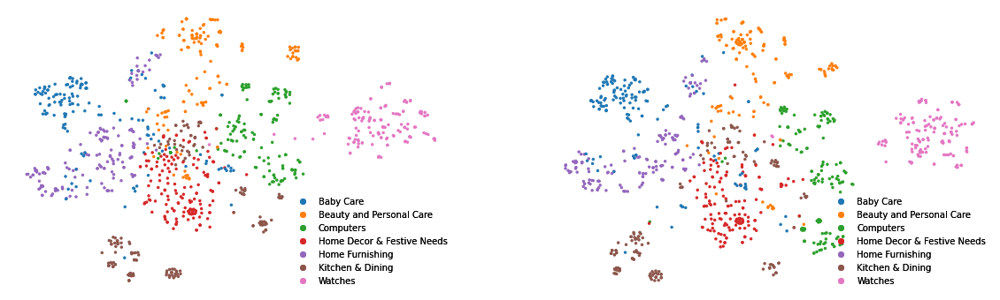

In [32]:
fig, axs = plt.subplots(1,2, figsize=(20,6))
for i, tok_ver in enumerate(tokenizer_versions) :
    data_ver = '_'.join([tok_ver, preprocessor_ver])
    X_tmp = X_projections[data_ver][proj_name]["X_proj"]
    output = axs[i].scatter(X_tmp[:,0], X_tmp[:,1], c=y, 
            cmap=ListedColormap(sns.color_palette('tab10'), N=len(set(y))), s=6)
    legend1 = axs[i].legend(output.legend_elements()[0], le.inverse_transform([i for i in range(7)]),
                    loc="lower right", frameon=False)
    axs[i].add_artist(legend1)
    axs[i].axis('off')
    #plt.xlim(-0.0005, 0.0005)
    #plt.ylim(-0.001, 0.0005)
plt.show()

#### TSNE1

In [33]:
proj_name = "TSNE1"
proj = TSNE(n_components=2, learning_rate='auto', init='pca',random_state=33, angle=0.85)
for tok_ver in tokenizer_versions :
    data_ver = '_'.join([tok_ver, preprocessor_ver])
    X_tmp = proj.fit_transform(X_datas[data_ver])
    X_projections[data_ver][proj_name] = {"X_proj" : X_tmp}

c:\users\bookj\environments\jupenv\lib\site-packages\sklearn\manifold\_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(
c:\users\bookj\environments\jupenv\lib\site-packages\sklearn\manifold\_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


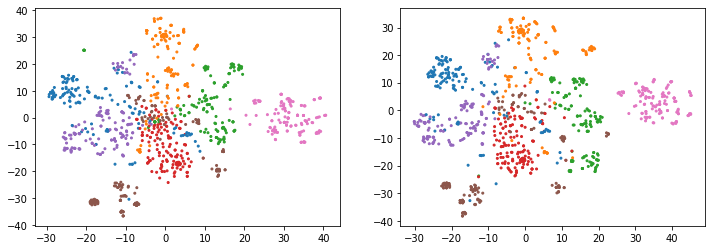

In [34]:
fig, axs = plt.subplots(1,2, figsize=(12,4))
for i, tok_ver in enumerate(tokenizer_versions) :
    data_ver = '_'.join([tok_ver, preprocessor_ver])
    X_tmp = X_projections[data_ver][proj_name]["X_proj"]
    axs[i].scatter(X_tmp[:,0], X_tmp[:,1], c=y, 
            cmap=ListedColormap(sns.color_palette('tab10'), N=len(set(y))), s=4)
    #plt.xlim(-0.0005, 0.0005)
    #plt.ylim(-0.001, 0.0005)
plt.show()

#### TSNE2

In [35]:
proj_name = "TSNE2"
proj = TSNE(n_components=2, perplexity=22, learning_rate=800, early_exaggeration=10, n_iter=5000, min_grad_norm = 1e-10,
            init='pca',random_state=33, angle=0.90)
for tok_ver in tokenizer_versions :
    data_ver = '_'.join([tok_ver, preprocessor_ver])
    X_tmp = proj.fit_transform(X_datas[data_ver])
    X_projections[data_ver][proj_name] = {"X_proj" : X_tmp}

c:\users\bookj\environments\jupenv\lib\site-packages\sklearn\manifold\_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(
c:\users\bookj\environments\jupenv\lib\site-packages\sklearn\manifold\_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


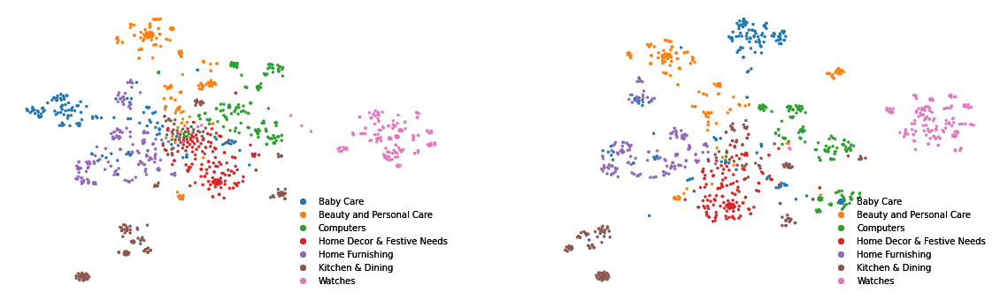

In [36]:
fig, axs = plt.subplots(1,2, figsize=(20,6))
for i, tok_ver in enumerate(tokenizer_versions) :
    data_ver = '_'.join([tok_ver, preprocessor_ver])
    X_tmp = X_projections[data_ver][proj_name]["X_proj"]
    output = axs[i].scatter(X_tmp[:,0], X_tmp[:,1], c=y, 
            cmap=ListedColormap(sns.color_palette('tab10'), N=len(set(y))), s=6)
    legend1 = axs[i].legend(output.legend_elements()[0], le.inverse_transform([i for i in range(7)]),
                    loc="lower right", frameon=False)
    axs[i].add_artist(legend1)
    axs[i].axis('off')
    #plt.xlim(-0.0005, 0.0005)
    #plt.ylim(-0.001, 0.0005)
plt.show()

#### LocallyLinearEmbedding

In [37]:
proj_name = "LLE"
proj = LocallyLinearEmbedding(n_components=2, n_neighbors = 10, eigen_solver='dense', )
for tok_ver in tokenizer_versions :
    data_ver = '_'.join([tok_ver, preprocessor_ver])
    X_tmp = proj.fit_transform(X_datas[data_ver])
    X_projections[data_ver][proj_name] = {"X_proj" : X_tmp}

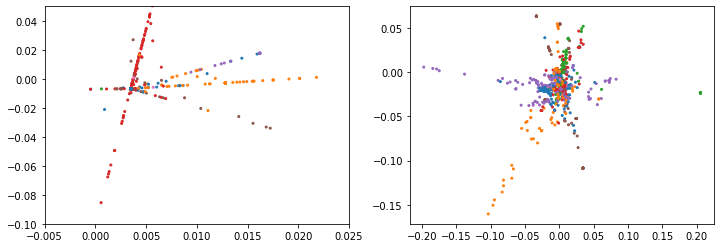

In [38]:
fig, axs = plt.subplots(1,2, figsize=(12,4))
for i, tok_ver in enumerate(tokenizer_versions) :
    data_ver = '_'.join([tok_ver, preprocessor_ver])
    X_tmp = X_projections[data_ver][proj_name]["X_proj"]
    axs[i].scatter(X_tmp[:,0], X_tmp[:,1], c=y, 
            cmap=ListedColormap(sns.color_palette('tab10'), N=len(set(y))), s=4)
axs[0].set_xlim(-0.005, 0.025)
axs[0].set_ylim(-0.1, 0.05)
plt.show()

####  SpectralEmbedding

In [39]:
proj_name = "SpecEmbedding"
proj = SpectralEmbedding(n_components=2, n_neighbors=60)
for tok_ver in tokenizer_versions :
    data_ver = '_'.join([tok_ver, preprocessor_ver])
    X_tmp = proj.fit_transform(X_datas[data_ver])
    X_projections[data_ver][proj_name] = {"X_proj" : X_tmp}

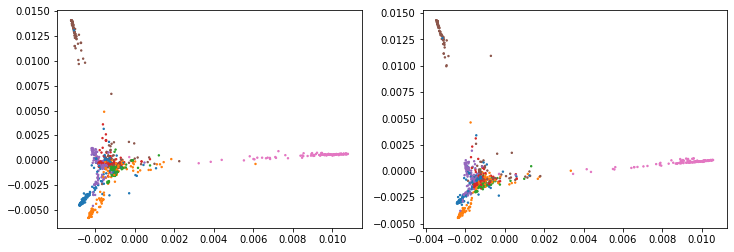

In [40]:
fig, axs = plt.subplots(1,2, figsize=(12,4))
for i, tok_ver in enumerate(tokenizer_versions) :
    data_ver = '_'.join([tok_ver, preprocessor_ver])
    X_tmp = X_projections[data_ver][proj_name]["X_proj"]
    axs[i].scatter(X_tmp[:,0], X_tmp[:,1], c=y, 
            cmap=ListedColormap(sns.color_palette('tab10'), N=len(set(y))), s=2)
    #plt.xlim(-0.0005, 0.0005)
    #plt.ylim(-0.001, 0.0005)
plt.show()

### 3.5.2 Manifold apprentissage

Pris du website de SKlearn : 
https://scikit-learn.org/stable/auto_examples/manifold/plot_lle_digits.html#sphx-glr-auto-examples-manifold-plot-lle-digits-py

In [41]:
n_neighbors = 60

embeddings = {
    "Random projection embedding": SparseRandomProjection(
        n_components=2, random_state=42
    ),
    "Truncated SVD embedding": TruncatedSVD(n_components=2),
    "Linear Discriminant Analysis embedding": LinearDiscriminantAnalysis(
        n_components=2
    ),
    "Isomap embedding": Isomap(n_neighbors=n_neighbors, n_components=2),
    "Standard LLE embedding": LocallyLinearEmbedding(
        n_neighbors=n_neighbors, n_components=2, method="standard"
    ),
    "Modified LLE embedding": LocallyLinearEmbedding(
        n_neighbors=n_neighbors, n_components=2, method="modified"
    ),
    "Hessian LLE embedding": LocallyLinearEmbedding(
        n_neighbors=n_neighbors, n_components=2, method="hessian", eigen_solver="dense"
    ),
    "LTSA LLE embedding": LocallyLinearEmbedding(
        n_neighbors=n_neighbors, n_components=2, method="ltsa", eigen_solver="dense" 
    ),
    "MDS embedding": MDS(n_components=2, n_init=1, max_iter=120, n_jobs=2),
    "Random Trees embedding": make_pipeline(
        RandomTreesEmbedding(n_estimators=200, max_depth=5, random_state=0),
        TruncatedSVD(n_components=2),
    ),
    "Spectral embedding": SpectralEmbedding(
        n_components=2, random_state=0, eigen_solver="arpack"
    ),
    "t-SNE embedding": TSNE(
        n_components=2,
        init="pca",
        learning_rate="auto",
        n_iter=500,
        n_iter_without_progress=150,
        n_jobs=2,
        random_state=0,
    ),
    "NCA embedding": NeighborhoodComponentsAnalysis(
        n_components=2, init="pca", random_state=0
    ),
}

In [42]:
X_prep['nltk'] = preprocessor.fit_transform(X['nltk'], y)

projections_embd, timing = {}, {}
for name, transformer_embd in embeddings.items():
    if name.startswith("Linear Discriminant Analysis"):
        data = X_prep['nltk'].copy()
        data.flat[:: X_prep['nltk'].shape[1] + 1] += 0.01  # Make X invertible
    else:
        data = X_prep['nltk']

    print(f"Computing {name}...")
    start_time = time()
    projections_embd[name] = transformer_embd.fit_transform(data, y)
    timing[name] = time() - start_time

Computing Random projection embedding...
Computing Truncated SVD embedding...
Computing Linear Discriminant Analysis embedding...
Computing Isomap embedding...
Computing Standard LLE embedding...
Computing Modified LLE embedding...
Computing Hessian LLE embedding...
Computing LTSA LLE embedding...
Computing MDS embedding...
Computing Random Trees embedding...
Computing Spectral embedding...
Computing t-SNE embedding...


c:\users\bookj\environments\jupenv\lib\site-packages\sklearn\manifold\_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


Computing NCA embedding...


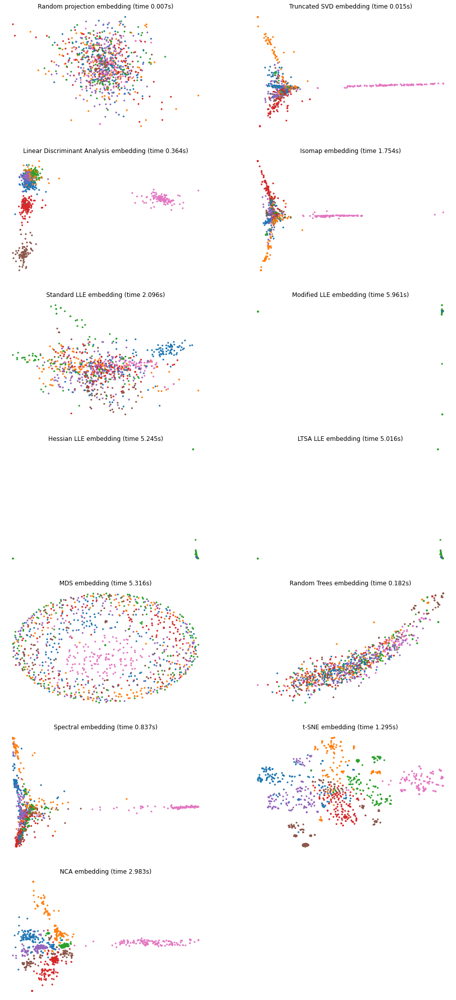

In [43]:
fig, axs = plt.subplots(nrows=7, ncols=2, figsize=(16, 36))

for name, ax in zip_longest(timing, axs.ravel()):
    if name is None:
        ax.axis("off")
        continue
    title = f"{name} (time {timing[name]:.3f}s)"
    plot_embedding(projections_embd[name], y, title, ax)

plt.show()

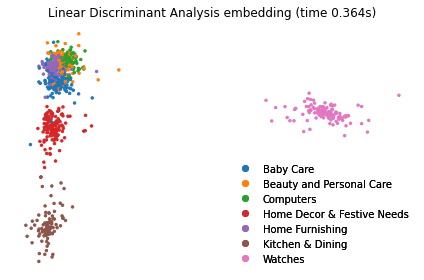

In [44]:
name = "Linear Discriminant Analysis embedding"
fig, ax = plt.subplots(figsize=(6, 4))
title = f"{name} (time {timing[name]:.3f}s)"
scatter = plot_embedding(projections_embd[name], y, title, ax)
legend1 = ax.legend(scatter.legend_elements()[0], le.inverse_transform([i for i in range(7)]),
                    loc="lower right", frameon=False)
ax.add_artist(legend1)
plt.tight_layout()

# 4. Clustering - Version 1

In [45]:
preprocessor_ver = 'Version1'

## 4.1 KMeans - Version1

### 4.1.1 Clustering

In [75]:
modelname = "KMeans"
nltk_scores=[]
spacy_scores=[]

for i in range(30):
    for tok_ver in tokenizer_versions:
        data_ver = '_'.join([tok_ver, preprocessor_ver])
        label = data_ver + '_' + modelname
        km = KMeans(n_clusters=7, n_init = 50, algorithm='full')
        X_labels[label] = km.fit_predict(X_datas[data_ver])
        if tok_ver == 'nltk' :
            nltk_scores.append(metrics.adjusted_rand_score(y, X_labels[label]))
        elif tok_ver == 'spacy' :
            spacy_scores.append(metrics.adjusted_rand_score(y, X_labels[label]))

print(f"The rand score for the nltk data is {round(np.array(nltk_scores).mean(),3)} " +
      f"+/- {round(np.array(nltk_scores).std(),3)}.")
print(f"The rand score for the spacy data is {round(np.array(spacy_scores).mean(),3)} " +
      f"+/- {round(np.array(spacy_scores).std(),3)}.")

The rand score for the nltk data is 0.258 +/- 0.017.
The rand score for the spacy data is 0.317 +/- 0.031.


In [97]:
for tok_ver in tokenizer_versions:
        data_ver = '_'.join([tok_ver, preprocessor_ver])
        label = data_ver + '_' + modelname
        km = KMeans(n_clusters=7, n_init = 50, algorithm='full', random_state=33)
        X_labels[label] = km.fit_predict(X_datas[data_ver])
        print(f"The rand score for the {data_ver} data is {round(metrics.adjusted_rand_score(y, X_labels[label]),3)}.")

The rand score for the nltk_Version1 data is 0.259.
The rand score for the spacy_Version1 data is 0.33.


### 4.1.2 Rapport Détaillé du Clustering 'KMeans' avec NLTK

In [98]:
tok_ver='nltk'
data_ver = tok_ver + '_Version1'
proj = 'TSNE2'
X_proj = X_projections[data_ver][proj]["X_proj"]

modelname = "KMeans"
label = data_ver + '_' + modelname

#### Comparision des Labels

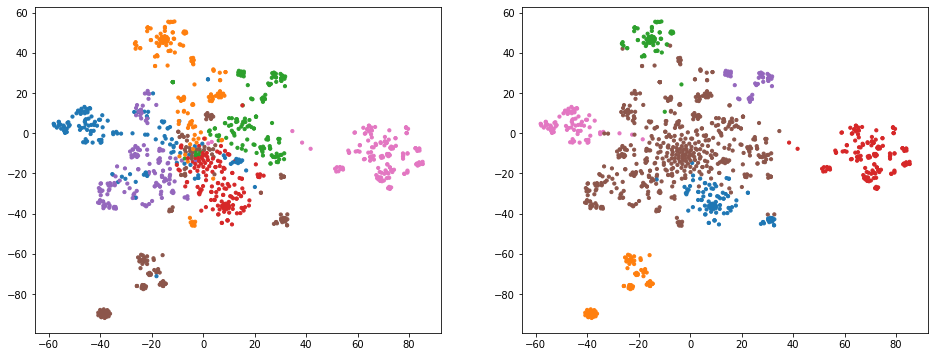

In [99]:
fig, ax = plt.subplots(1,2, figsize=(16,6))
ax[0].scatter(X_proj[:,0], X_proj[:,1], c=y, 
            cmap=ListedColormap(sns.color_palette('tab10'), N=len(set(y))), s=10)
ax[1].scatter(X_proj[:,0], X_proj[:,1], c=X_labels[label], 
            cmap=ListedColormap(sns.color_palette('tab10'), N=len(set(X_labels[label]))), s=10)
plt.show()

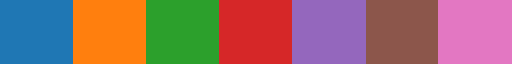

In [100]:
ListedColormap(sns.color_palette('tab10'), N=7)

In [101]:
label_dict_1 = {0:3, 1:5, 2:1, 3:6, 4:2, 5:4, 6:0}
#label_dict_1

In [102]:
{i:le.inverse_transform([i])[0] for i in range(7)}

{0: 'Baby Care',
 1: 'Beauty and Personal Care',
 2: 'Computers',
 3: 'Home Decor & Festive Needs',
 4: 'Home Furnishing',
 5: 'Kitchen & Dining',
 6: 'Watches'}

#### Rapport de Classification

In [103]:
cluster_labels = pd.Series(X_labels[label]).map(label_dict_1)
print(classification_report(le.inverse_transform(y), le.inverse_transform(cluster_labels)))

                            precision    recall  f1-score   support

                 Baby Care       1.00      0.54      0.70       150
  Beauty and Personal Care       1.00      0.45      0.62       150
                 Computers       1.00      0.31      0.47       150
Home Decor & Festive Needs       0.81      0.54      0.65       150
           Home Furnishing       0.28      0.99      0.44       150
          Kitchen & Dining       0.99      0.49      0.66       150
                   Watches       1.00      0.98      0.99       150

                  accuracy                           0.62      1050
                 macro avg       0.87      0.62      0.65      1050
              weighted avg       0.87      0.62      0.65      1050



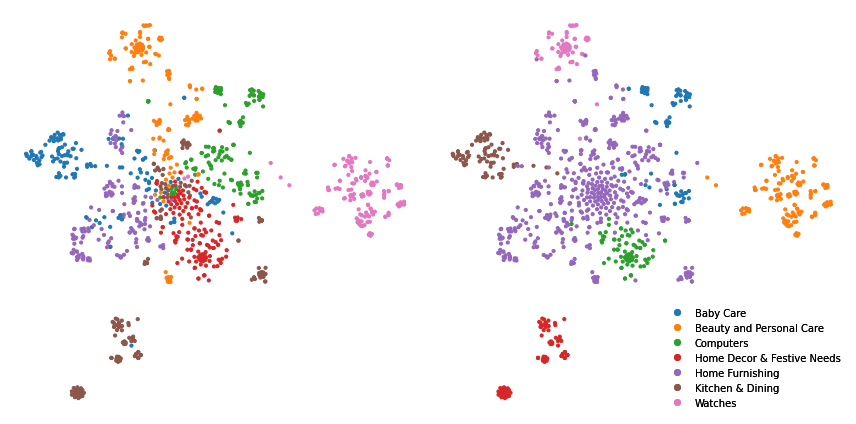

In [96]:
fig, axs = plt.subplots(1,2, figsize=(12,6))
axs[0].scatter(X_proj[:,0], X_proj[:,1], c=y, 
            cmap=ListedColormap(sns.color_palette('tab10'), N=len(set(y))), s=10)
output = axs[1].scatter(X_proj[:,0], X_proj[:,1], c=cluster_labels, 
            cmap=ListedColormap(sns.color_palette('tab10'), N=len(set(cluster_labels))), s=10)
legend1 = axs[1].legend(output.legend_elements()[0], le.inverse_transform([i for i in range(7)]),
                    loc="lower right", frameon=False)
axs[1].add_artist(legend1)
axs[0].axis('off')
axs[1].axis('off')

plt.tight_layout()

#### Confusion Matrix

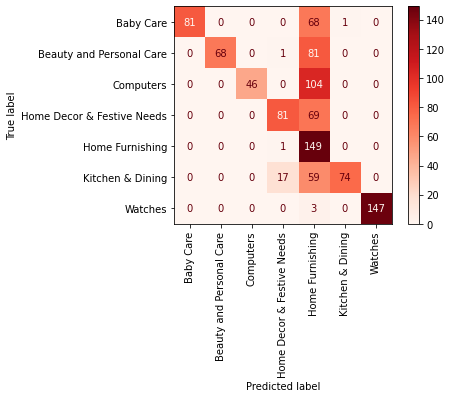

In [87]:
fig, ax = plt.subplots()
confmatrix = metrics.ConfusionMatrixDisplay.from_predictions(y, cluster_labels,
                                                             display_labels=[le.inverse_transform([i])[0] for i in range(7)],
                                                             xticks_rotation='vertical', cmap='Reds', ax=ax)

#### WordCloud

In [104]:
# Instantiate a new wordcloud.
stopwords = [key for key in set(' '.join(X[tok_ver]).split()) if key not in vocabulary_sets[data_ver+'_red'].keys()]
wordcloud = WordCloud(random_state = 8,
            normalize_plurals = False,
            width = 1000, height= 600,
            stopwords = stopwords)

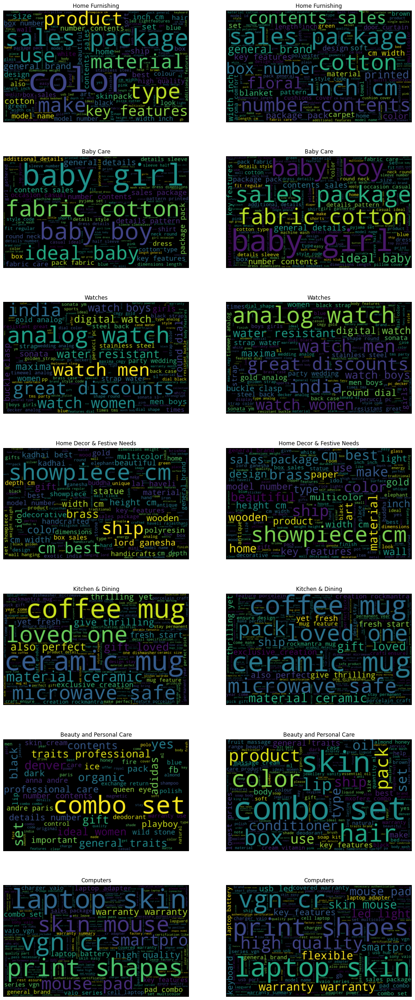

In [105]:
fig, axes = plt.subplots(7,2, figsize = (16,40))
y_cat_cl = pd.Series(le.inverse_transform(cluster_labels))
y_cat = pd.Series(le.inverse_transform(y))

categories = y_cat.unique()
for ii, cl in enumerate(categories):
    # Apply the wordcloud to the text.
    for jj, yy in enumerate([y_cat_cl, y_cat]):
        select = (yy == cl)
        wordcloud.generate(' '.join(X['nltk'][select]))
        # add interpolation = bilinear to smooth things out
        ax = axes[ii][jj]
        ax.imshow(wordcloud, interpolation='bilinear')
        ax.set_title(cl)
        # and remove the axis
        ax.axis("off")
plt.show()

### 4.1.3 Rapport Détaillé du Clustering 'KMeans' avec SpaCY

In [106]:
tok_ver='spacy'
data_ver = tok_ver + '_Version1'
proj = 'TSNE2'
X_proj = X_projections[data_ver][proj]["X_proj"]

modelname = "KMeans"
label = data_ver + '_' + modelname

#### Comparision des Labels

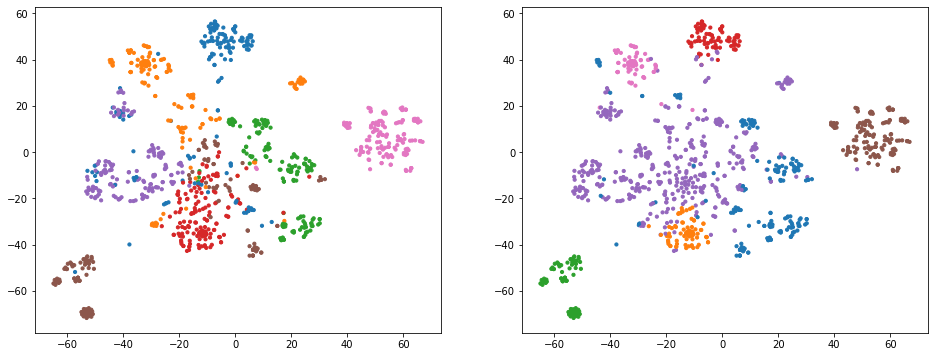

In [107]:
fig, ax = plt.subplots(1,2, figsize=(16,6))
ax[0].scatter(X_proj[:,0], X_proj[:,1], c=y, 
            cmap=ListedColormap(sns.color_palette('tab10'), N=len(set(y))), s=10)
ax[1].scatter(X_proj[:,0], X_proj[:,1], c=X_labels[label], 
            cmap=ListedColormap(sns.color_palette('tab10'), N=len(set(X_labels[label]))), s=10)
plt.show()

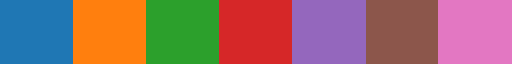

In [108]:
ListedColormap(sns.color_palette('tab10'), N=7)

In [109]:
label_dict_1 = {0:2, 1:3, 2:5, 3:0, 4:4, 5:6, 6:1}
#label_dict_1

#### Rapport de Classification

In [110]:
cluster_labels = pd.Series(X_labels[label]).map(label_dict_1)
print(classification_report(le.inverse_transform(y), le.inverse_transform(cluster_labels)))

                            precision    recall  f1-score   support

                 Baby Care       1.00      0.54      0.70       150
  Beauty and Personal Care       0.97      0.46      0.62       150
                 Computers       0.58      0.69      0.63       150
Home Decor & Festive Needs       1.00      0.49      0.65       150
           Home Furnishing       0.35      0.98      0.51       150
          Kitchen & Dining       0.99      0.49      0.66       150
                   Watches       1.00      0.98      0.99       150

                  accuracy                           0.66      1050
                 macro avg       0.84      0.66      0.68      1050
              weighted avg       0.84      0.66      0.68      1050



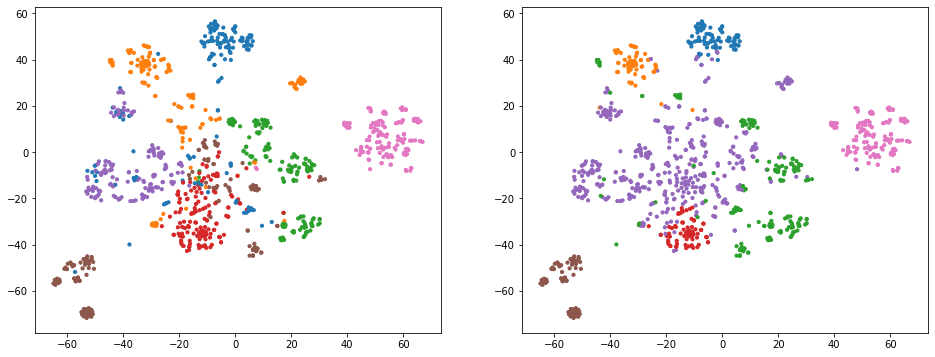

In [111]:
fig, ax = plt.subplots(1,2, figsize=(16,6))
ax[0].scatter(X_proj[:,0], X_proj[:,1], c=y, 
            cmap=ListedColormap(sns.color_palette('tab10'), N=len(set(y))), s=10)
ax[1].scatter(X_proj[:,0], X_proj[:,1], c=cluster_labels, 
            cmap=ListedColormap(sns.color_palette('tab10'), N=len(set(cluster_labels))), s=10)
plt.show()

#### Confusion Matrix

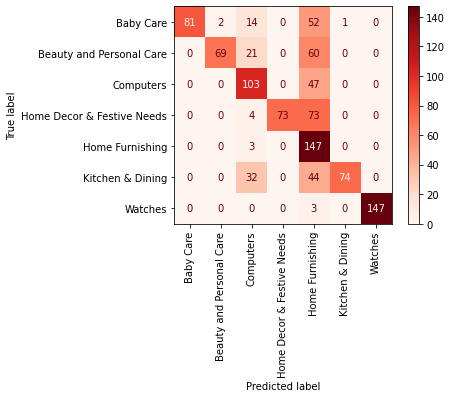

In [112]:
fig, ax = plt.subplots()
confmatrix = metrics.ConfusionMatrixDisplay.from_predictions(y, cluster_labels,
                                                             display_labels=[le.inverse_transform([i])[0] for i in range(7)],
                                                             xticks_rotation='vertical', cmap='Reds', ax=ax)

#### WordCloud

In [113]:
# Instantiate a new wordcloud.
stopwords = [key for key in set(' '.join(X[tok_ver]).split()) if key not in vocabulary_sets[data_ver+'_red'].keys()]
wordcloud = WordCloud(random_state = 8,
            normalize_plurals = False,
            width = 1000, height= 600,
            stopwords = stopwords)

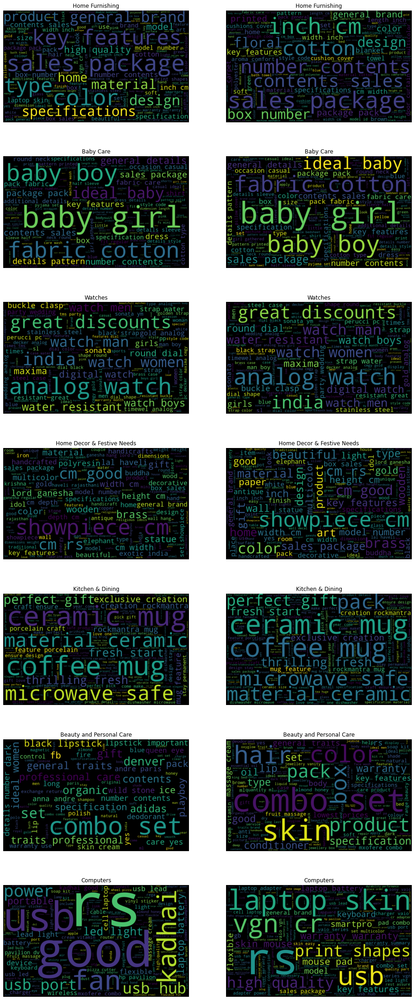

In [114]:
fig, axes = plt.subplots(7,2, figsize = (16,40))
y_cat_cl = pd.Series(le.inverse_transform(cluster_labels))
y_cat = pd.Series(le.inverse_transform(y))

categories = y_cat.unique()
for ii, cl in enumerate(categories):
    # Apply the wordcloud to the text.
    for jj, yy in enumerate([y_cat_cl, y_cat]):
        select = (yy == cl)
        wordcloud.generate(' '.join(X['spacy'][select]))
        # add interpolation = bilinear to smooth things out
        ax = axes[ii][jj]
        ax.imshow(wordcloud, interpolation='bilinear')
        ax.set_title(cl)
        # and remove the axis
        ax.axis("off")
plt.show()

## 4.2 GaussianMixture - Version1

### 4.2.1 Clustering

In [115]:
modelname = "GaussMixture"
nltk_scores=[]
spacy_scores=[]

for i in range(10):
    for tok_ver in tokenizer_versions:
        data_ver = '_'.join([tok_ver, preprocessor_ver])
        label = data_ver + '_' + modelname
        gm = GaussianMixture(n_components=7, n_init=20)
        X_labels[label] = gm.fit_predict(X_datas[data_ver])
        if tok_ver == 'nltk' :
            nltk_scores.append(metrics.adjusted_rand_score(y, X_labels[label]))
        elif tok_ver == 'spacy' :
            spacy_scores.append(metrics.adjusted_rand_score(y, X_labels[label]))

print(f"The rand score for the nltk data is {round(np.array(nltk_scores).mean(),3)} " +
      f"+/- {round(np.array(nltk_scores).std(),3)}.")
print(f"The rand score for the spacy data is {round(np.array(spacy_scores).mean(),3)} " +
      f"+/- {round(np.array(spacy_scores).std(),3)}.")

The rand score for the nltk data is 0.333 +/- 0.033.
The rand score for the spacy data is 0.321 +/- 0.04.


In [116]:
for tok_ver in tokenizer_versions:
        data_ver = '_'.join([tok_ver, preprocessor_ver])
        label = data_ver + '_' + modelname
        gm = GaussianMixture(n_components=7, n_init=20, random_state=33)
        X_labels[label] = gm.fit_predict(X_datas[data_ver])
        print(f"The rand score for the {data_ver} data is {metrics.adjusted_rand_score(y, X_labels[label])}.")

The rand score for the nltk_Version1 data is 0.34393811459889784.
The rand score for the spacy_Version1 data is 0.327575894719389.


### 4.2.2 Rapport Détaillé du Clustering 'GaussianMixture' avec NLTK

In [125]:
tok_ver='nltk'
data_ver = tok_ver + '_Version1'
proj = 'TSNE2'
X_proj = X_projections[data_ver][proj]["X_proj"]

modelname = "GaussMixture"
label = data_ver + '_' + modelname

#### Comparison des Labels

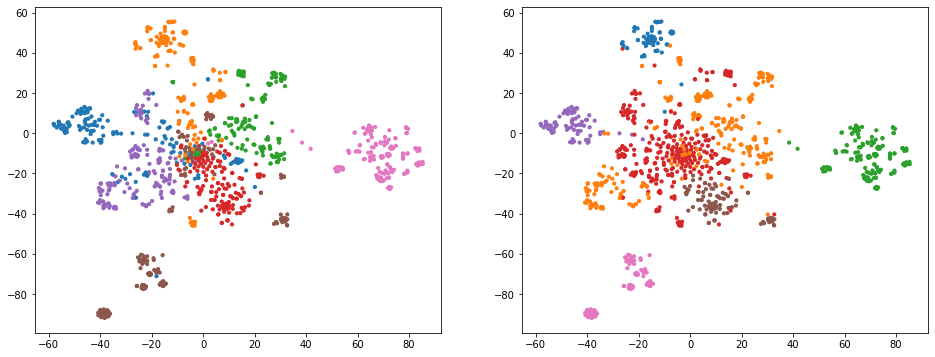

In [126]:
fig, ax = plt.subplots(1,2, figsize=(16,6))
ax[0].scatter(X_proj[:,0], X_proj[:,1], c=y, 
            cmap=ListedColormap(sns.color_palette('tab10'), N=len(set(y))), s=10)
ax[1].scatter(X_proj[:,0], X_proj[:,1], c=X_labels[label], 
            cmap=ListedColormap(sns.color_palette('tab10'), N=len(set(X_labels[label]))), s=10)
plt.show()

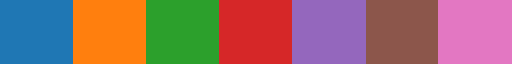

In [127]:
ListedColormap(sns.color_palette('tab10'), N=7)

In [128]:
label_dict_1 = {0:1, 1:2, 2:6, 3:4, 4:0, 5:3, 6:5}
#label_dict_1

In [129]:
{i:le.inverse_transform([i])[0] for i in range(7)}

{0: 'Baby Care',
 1: 'Beauty and Personal Care',
 2: 'Computers',
 3: 'Home Decor & Festive Needs',
 4: 'Home Furnishing',
 5: 'Kitchen & Dining',
 6: 'Watches'}

#### Rapport de Classification

In [130]:
cluster_labels = pd.Series(X_labels[label]).map(label_dict_1)
print(classification_report(le.inverse_transform(y), le.inverse_transform(cluster_labels)))

                            precision    recall  f1-score   support

                 Baby Care       1.00      0.54      0.70       150
  Beauty and Personal Care       1.00      0.45      0.62       150
                 Computers       0.47      0.87      0.61       150
Home Decor & Festive Needs       0.81      0.51      0.62       150
           Home Furnishing       0.28      0.58      0.38       150
          Kitchen & Dining       0.99      0.49      0.66       150
                   Watches       1.00      0.98      0.99       150

                  accuracy                           0.63      1050
                 macro avg       0.79      0.63      0.66      1050
              weighted avg       0.79      0.63      0.66      1050



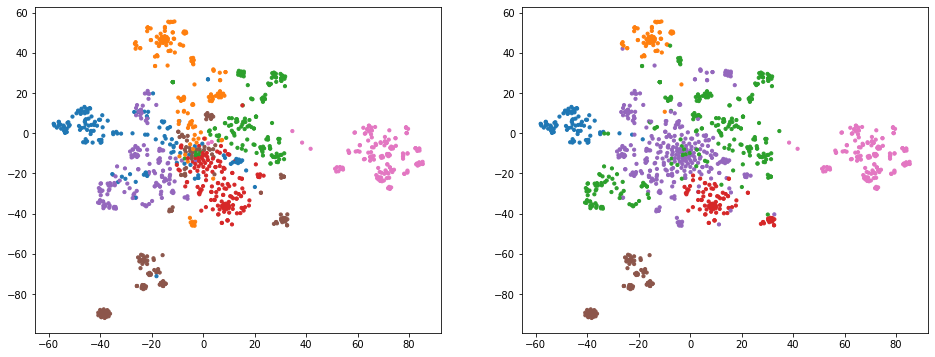

In [131]:
fig, ax = plt.subplots(1,2, figsize=(16,6))
ax[0].scatter(X_proj[:,0], X_proj[:,1], c=y, 
            cmap=ListedColormap(sns.color_palette('tab10'), N=len(set(y))), s=10)
ax[1].scatter(X_proj[:,0], X_proj[:,1], c=cluster_labels, 
            cmap=ListedColormap(sns.color_palette('tab10'), N=len(set(cluster_labels))), s=10)
plt.show()

#### Confusion Matrix

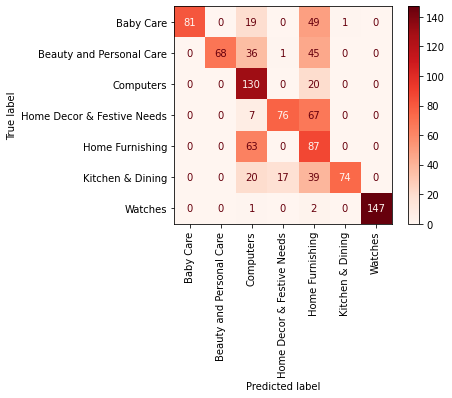

In [132]:
fig, ax = plt.subplots()
confmatrix = metrics.ConfusionMatrixDisplay.from_predictions(y, cluster_labels,
                                                             display_labels=[le.inverse_transform([i])[0] for i in range(7)],
                                                             xticks_rotation='vertical', cmap='Reds', ax=ax)

#### WordCloud

In [133]:
# Instantiate a new wordcloud.
stopwords = [key for key in set(' '.join(X[tok_ver]).split()) if key not in vocabulary_sets[data_ver+'_red'].keys()]
wordcloud = WordCloud(random_state = 8,
            normalize_plurals = False,
            width = 1000, height= 600,
            stopwords = stopwords)

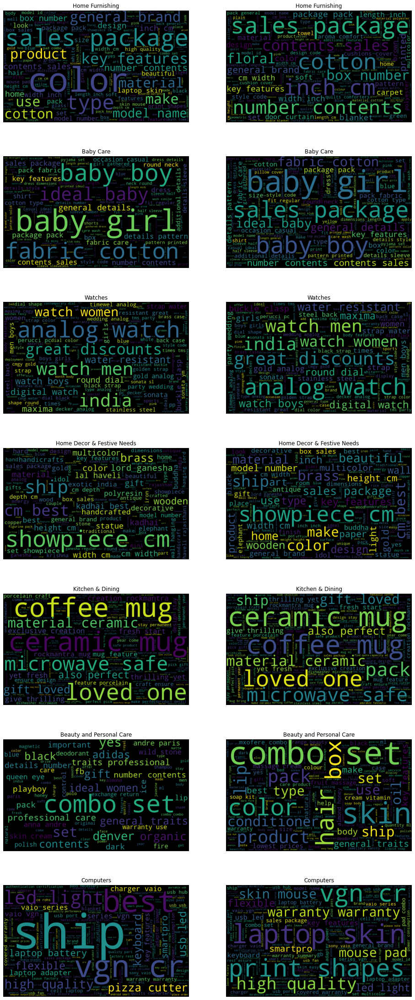

In [134]:
fig, axes = plt.subplots(7,2, figsize = (16,40))
y_cat_cl = pd.Series(le.inverse_transform(cluster_labels))
y_cat = pd.Series(le.inverse_transform(y))

categories = y_cat.unique()
for ii, cl in enumerate(categories):
    # Apply the wordcloud to the text.
    for jj, yy in enumerate([y_cat_cl, y_cat]):
        select = (yy == cl)
        wordcloud.generate(' '.join(X['nltk'][select]))
        # add interpolation = bilinear to smooth things out
        ax = axes[ii][jj]
        ax.imshow(wordcloud, interpolation='bilinear')
        ax.set_title(cl)
        # and remove the axis
        ax.axis("off")
plt.show()

### 4.2.3 Rapport Détaillé du Clustering 'GaussianMixture' avec SpaCy

In [136]:
tok_ver='spacy'
data_ver = tok_ver + '_Version1'
proj = 'TSNE2'
X_proj = X_projections[data_ver][proj]["X_proj"]

modelname = "GaussMixture"
label = data_ver + '_' + modelname

#### Comparison des Labels

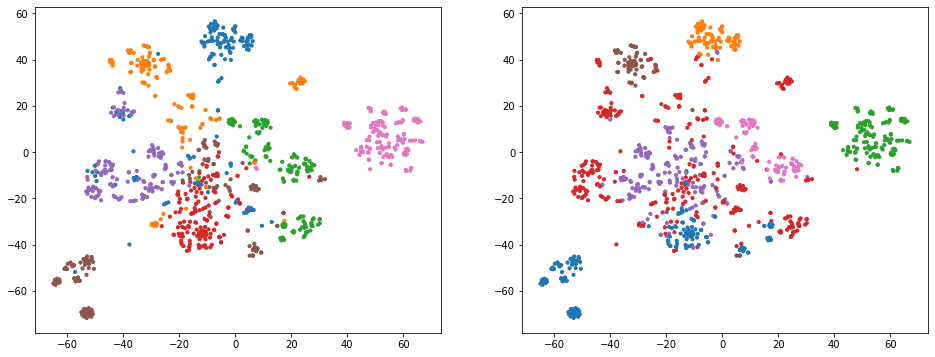

In [137]:
fig, ax = plt.subplots(1,2, figsize=(16,6))
ax[0].scatter(X_proj[:,0], X_proj[:,1], c=y, 
            cmap=ListedColormap(sns.color_palette('tab10'), N=len(set(y))), s=10)
ax[1].scatter(X_proj[:,0], X_proj[:,1], c=X_labels[label], 
            cmap=ListedColormap(sns.color_palette('tab10'), N=len(set(X_labels[label]))), s=10)
plt.show()

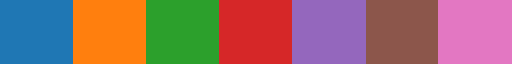

In [138]:
ListedColormap(sns.color_palette('tab10'), N=7)

In [139]:
label_dict_1 = {0:5, 1:0, 2:6, 3:3, 4:4, 5:1, 6:2}
#label_dict_1

In [140]:
{i:le.inverse_transform([i])[0] for i in range(7)}

{0: 'Baby Care',
 1: 'Beauty and Personal Care',
 2: 'Computers',
 3: 'Home Decor & Festive Needs',
 4: 'Home Furnishing',
 5: 'Kitchen & Dining',
 6: 'Watches'}

#### Rapport de Classification

In [141]:
cluster_labels = pd.Series(X_labels[label]).map(label_dict_1)
print(classification_report(le.inverse_transform(y), le.inverse_transform(cluster_labels)))

                            precision    recall  f1-score   support

                 Baby Care       1.00      0.53      0.70       150
  Beauty and Personal Care       0.99      0.46      0.63       150
                 Computers       0.98      0.57      0.72       150
Home Decor & Festive Needs       0.15      0.31      0.20       150
           Home Furnishing       0.38      0.47      0.42       150
          Kitchen & Dining       0.52      0.60      0.56       150
                   Watches       1.00      0.98      0.99       150

                  accuracy                           0.56      1050
                 macro avg       0.72      0.56      0.60      1050
              weighted avg       0.72      0.56      0.60      1050



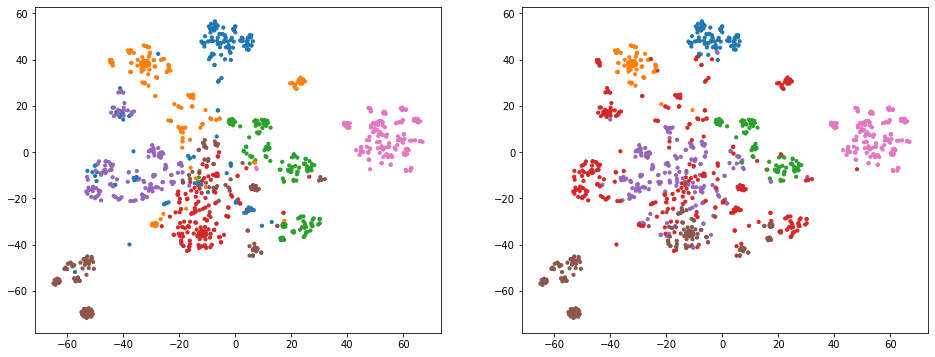

In [142]:
fig, ax = plt.subplots(1,2, figsize=(16,6))
ax[0].scatter(X_proj[:,0], X_proj[:,1], c=y, 
            cmap=ListedColormap(sns.color_palette('tab10'), N=len(set(y))), s=10)
ax[1].scatter(X_proj[:,0], X_proj[:,1], c=cluster_labels, 
            cmap=ListedColormap(sns.color_palette('tab10'), N=len(set(cluster_labels))), s=10)
plt.show()

#### Confusion Matrix

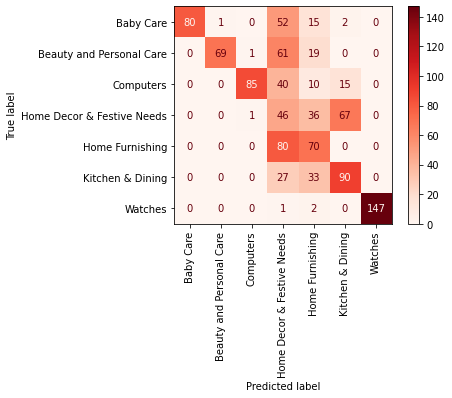

In [143]:
fig, ax = plt.subplots()
confmatrix = metrics.ConfusionMatrixDisplay.from_predictions(y, cluster_labels,
                                                             display_labels=[le.inverse_transform([i])[0] for i in range(7)],
                                                             xticks_rotation='vertical', cmap='Reds', ax=ax)

#### WordCloud

In [144]:
# Instantiate a new wordcloud.
stopwords = [key for key in set(' '.join(X[tok_ver]).split()) if key not in vocabulary_sets[data_ver+'_red'].keys()]
wordcloud = WordCloud(random_state = 8,
            normalize_plurals = False,
            width = 1000, height= 600,
            stopwords = stopwords)

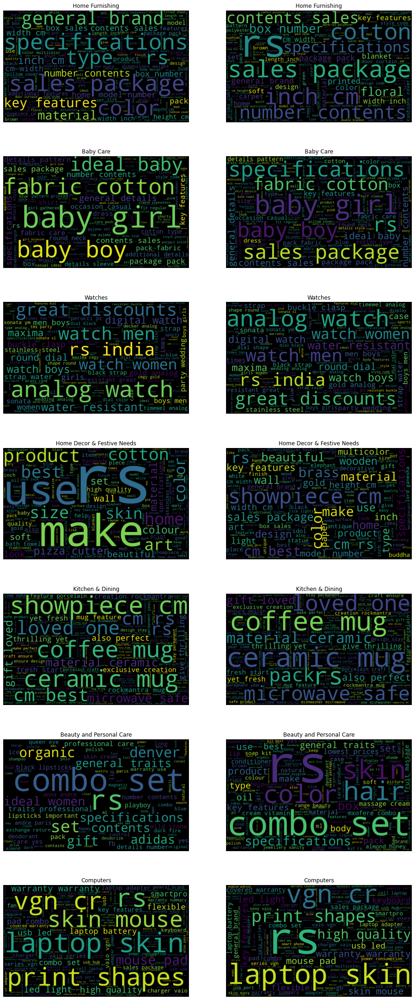

In [145]:
fig, axes = plt.subplots(7,2, figsize = (16,40))
y_cat_cl = pd.Series(le.inverse_transform(cluster_labels))
y_cat = pd.Series(le.inverse_transform(y))

categories = y_cat.unique()
for ii, cl in enumerate(categories):
    # Apply the wordcloud to the text.
    for jj, yy in enumerate([y_cat_cl, y_cat]):
        select = (yy == cl)
        wordcloud.generate(' '.join(X['nltk'][select]))
        # add interpolation = bilinear to smooth things out
        ax = axes[ii][jj]
        ax.imshow(wordcloud, interpolation='bilinear')
        ax.set_title(cl)
        # and remove the axis
        ax.axis("off")
plt.show()

## 4.3 AgglomerativeClustering - Version1

### 4.3.1 Clustering

In [146]:
modelname = "AggClust"
for tok_ver in tokenizer_versions:
    data_ver = '_'.join([tok_ver, preprocessor_ver])
    label = data_ver + '_' + modelname
    ac = AgglomerativeClustering(n_clusters=7)
    X_labels[label] = ac.fit_predict(X_datas[data_ver])
    print(f"The rand score for the {tok_ver} data is {metrics.adjusted_rand_score(y, X_labels[label])}")

The rand score for the nltk data is 0.2347497572075119
The rand score for the spacy data is 0.20230894151552345


### 4.3.2 Rapport Détaillé du Clustering 'AgglomerativeClustering' avec NLTK

In [147]:
tok_ver='nltk'
data_ver = tok_ver + '_Version1'
proj = 'TSNE2'
X_proj = X_projections[data_ver][proj]["X_proj"]

modelname = "AggClust"
label = data_ver + '_' + modelname

#### Comparison des Labels

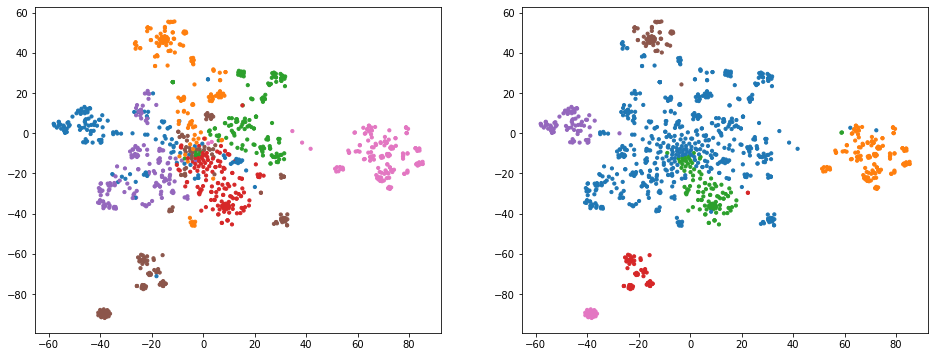

In [148]:
fig, ax = plt.subplots(1,2, figsize=(16,6))
ax[0].scatter(X_proj[:,0], X_proj[:,1], c=y, 
            cmap=ListedColormap(sns.color_palette('tab10'), N=len(set(y))), s=10)
ax[1].scatter(X_proj[:,0], X_proj[:,1], c=X_labels[label], 
            cmap=ListedColormap(sns.color_palette('tab10'), N=len(set(X_labels[label]))), s=10)
plt.show()

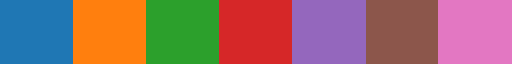

In [149]:
ListedColormap(sns.color_palette('tab10'), N=7)

In [150]:
label_dict_1 = {0:2, 1:6, 2:3, 3:5, 4:0, 5:1, 6:4}
#label_dict_1

In [151]:
{i:le.inverse_transform([i])[0] for i in range(7)}

{0: 'Baby Care',
 1: 'Beauty and Personal Care',
 2: 'Computers',
 3: 'Home Decor & Festive Needs',
 4: 'Home Furnishing',
 5: 'Kitchen & Dining',
 6: 'Watches'}

#### Rapport de Classification

In [152]:
cluster_labels = pd.Series(X_labels[label]).map(label_dict_1)
print(classification_report(le.inverse_transform(y), le.inverse_transform(cluster_labels)))

                            precision    recall  f1-score   support

                 Baby Care       1.00      0.51      0.67       150
  Beauty and Personal Care       1.00      0.39      0.56       150
                 Computers       0.25      1.00      0.40       150
Home Decor & Festive Needs       0.93      0.66      0.77       150
           Home Furnishing       0.00      0.00      0.00       150
          Kitchen & Dining       0.96      0.36      0.52       150
                   Watches       1.00      0.94      0.97       150

                  accuracy                           0.55      1050
                 macro avg       0.73      0.55      0.56      1050
              weighted avg       0.73      0.55      0.56      1050



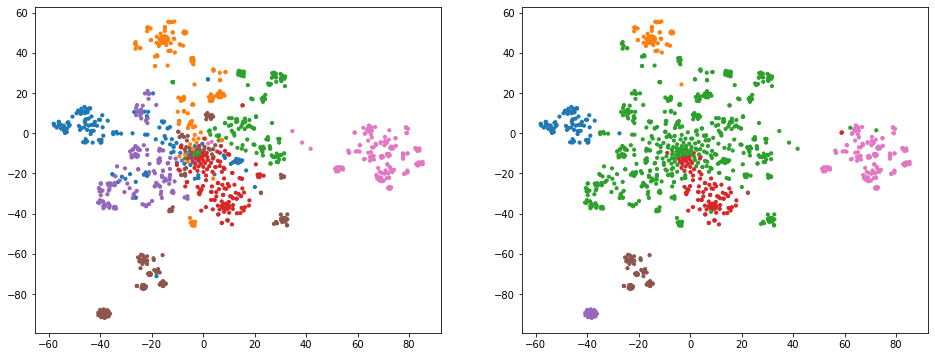

In [153]:
fig, ax = plt.subplots(1,2, figsize=(16,6))
ax[0].scatter(X_proj[:,0], X_proj[:,1], c=y, 
            cmap=ListedColormap(sns.color_palette('tab10'), N=len(set(y))), s=10)
ax[1].scatter(X_proj[:,0], X_proj[:,1], c=cluster_labels, 
            cmap=ListedColormap(sns.color_palette('tab10'), N=len(set(cluster_labels))), s=10)
plt.show()

#### Confusion Matrix

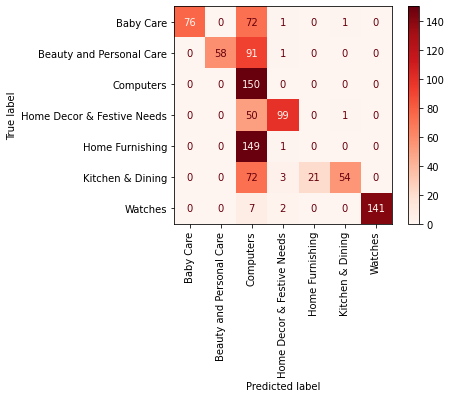

In [154]:
fig, ax = plt.subplots()
confmatrix = metrics.ConfusionMatrixDisplay.from_predictions(y, cluster_labels,
                                                             display_labels=[le.inverse_transform([i])[0] for i in range(7)],
                                                             xticks_rotation='vertical', cmap='Reds', ax=ax)

#### WordCloud

In [ ]:
# Instantiate a new wordcloud.
stopwords = [key for key in set(' '.join(X[tok_ver]).split()) if key not in vocabulary_sets[data_ver+'_red'].keys()]
wordcloud = WordCloud(random_state = 8,
            normalize_plurals = False,
            width = 1000, height= 600,
            stopwords = stopwords)

In [ ]:
fig, axes = plt.subplots(7,2, figsize = (16,40))
y_cat_cl = pd.Series(le.inverse_transform(cluster_labels))
y_cat = pd.Series(le.inverse_transform(y))

categories = y_cat.unique()
for ii, cl in enumerate(categories):
    # Apply the wordcloud to the text.
    for jj, yy in enumerate([y_cat_cl, y_cat]):
        select = (yy == cl)
        wordcloud.generate(' '.join(X['nltk'][select]))
        # add interpolation = bilinear to smooth things out
        ax = axes[ii][jj]
        ax.imshow(wordcloud, interpolation='bilinear')
        ax.set_title(cl)
        # and remove the axis
        ax.axis("off")
plt.show()

### 4.3.3 Rapport Détaillé du Clustering 'AgglomerativeClustering' avec SpaCy

In [155]:
tok_ver='spacy'
data_ver = tok_ver + '_Version1'
proj = 'TSNE2'
X_proj = X_projections[data_ver][proj]["X_proj"]

modelname = "AggClust"
label = data_ver + '_' + modelname

#### Comparison des Labels

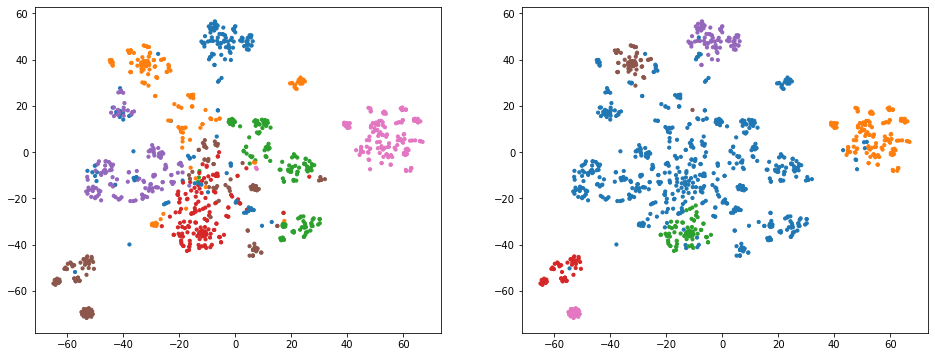

In [156]:
fig, ax = plt.subplots(1,2, figsize=(16,6))
ax[0].scatter(X_proj[:,0], X_proj[:,1], c=y, 
            cmap=ListedColormap(sns.color_palette('tab10'), N=len(set(y))), s=10)
ax[1].scatter(X_proj[:,0], X_proj[:,1], c=X_labels[label], 
            cmap=ListedColormap(sns.color_palette('tab10'), N=len(set(X_labels[label]))), s=10)
plt.show()

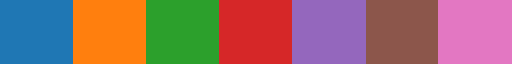

In [157]:
ListedColormap(sns.color_palette('tab10'), N=7)

In [158]:
label_dict_1 = {0:4, 1:6, 2:3, 3:5, 4:0, 5:1, 6:2}
#label_dict_1

In [159]:
{i:le.inverse_transform([i])[0] for i in range(7)}

{0: 'Baby Care',
 1: 'Beauty and Personal Care',
 2: 'Computers',
 3: 'Home Decor & Festive Needs',
 4: 'Home Furnishing',
 5: 'Kitchen & Dining',
 6: 'Watches'}

#### Rapport de Classification

In [160]:
cluster_labels = pd.Series(X_labels[label]).map(label_dict_1)
print(classification_report(le.inverse_transform(y), le.inverse_transform(cluster_labels)))

                            precision    recall  f1-score   support

                 Baby Care       1.00      0.54      0.70       150
  Beauty and Personal Care       1.00      0.39      0.56       150
                 Computers       0.00      0.00      0.00       150
Home Decor & Festive Needs       0.99      0.47      0.64       150
           Home Furnishing       0.24      1.00      0.39       150
          Kitchen & Dining       0.98      0.35      0.51       150
                   Watches       1.00      0.94      0.97       150

                  accuracy                           0.53      1050
                 macro avg       0.74      0.53      0.54      1050
              weighted avg       0.74      0.53      0.54      1050



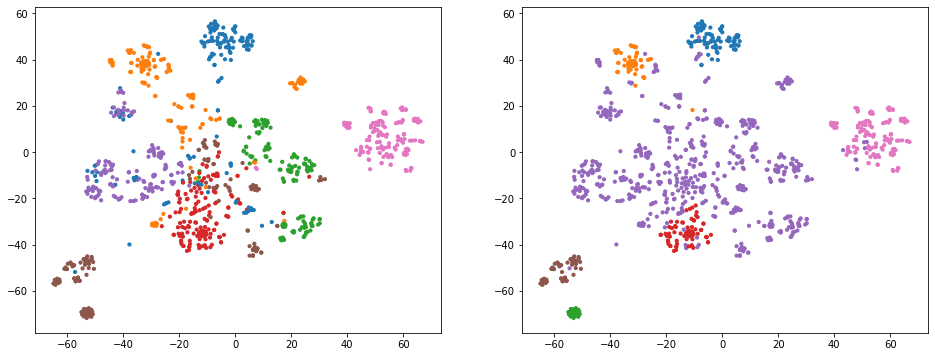

In [161]:
fig, ax = plt.subplots(1,2, figsize=(16,6))
ax[0].scatter(X_proj[:,0], X_proj[:,1], c=y, 
            cmap=ListedColormap(sns.color_palette('tab10'), N=len(set(y))), s=10)
ax[1].scatter(X_proj[:,0], X_proj[:,1], c=cluster_labels, 
            cmap=ListedColormap(sns.color_palette('tab10'), N=len(set(cluster_labels))), s=10)
plt.show()

#### Confusion Matrix

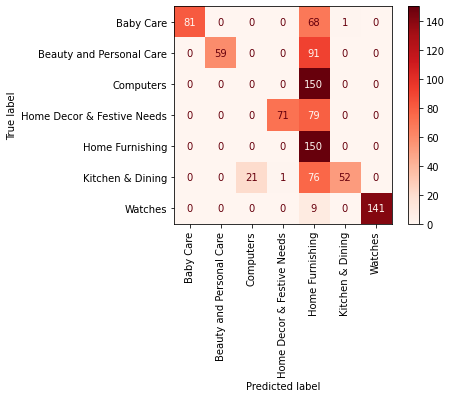

In [162]:
fig, ax = plt.subplots()
confmatrix = metrics.ConfusionMatrixDisplay.from_predictions(y, cluster_labels,
                                                             display_labels=[le.inverse_transform([i])[0] for i in range(7)],
                                                             xticks_rotation='vertical', cmap='Reds', ax=ax)

#### WordCloud

In [ ]:
# Instantiate a new wordcloud.
stopwords = [key for key in set(' '.join(X[tok_ver]).split()) if key not in vocabulary_sets[data_ver+'_red'].keys()]
wordcloud = WordCloud(random_state = 8,
            normalize_plurals = False,
            width = 1000, height= 600,
            stopwords = stopwords)

In [ ]:
fig, axes = plt.subplots(7,2, figsize = (16,40))
y_cat_cl = pd.Series(le.inverse_transform(cluster_labels))
y_cat = pd.Series(le.inverse_transform(y))

categories = y_cat.unique()
for ii, cl in enumerate(categories):
    # Apply the wordcloud to the text.
    for jj, yy in enumerate([y_cat_cl, y_cat]):
        select = (yy == cl)
        wordcloud.generate(' '.join(X['nltk'][select]))
        # add interpolation = bilinear to smooth things out
        ax = axes[ii][jj]
        ax.imshow(wordcloud, interpolation='bilinear')
        ax.set_title(cl)
        # and remove the axis
        ax.axis("off")
plt.show()

### 4.3.4 Clustering - 2

In [163]:
modelname = "AggClust2"
for tok_ver in tokenizer_versions:
    data_ver = '_'.join([tok_ver, preprocessor_ver])
    label = data_ver + '_' + modelname
    ac = AgglomerativeClustering(n_clusters=8)
    X_labels[label] = ac.fit_predict(X_datas[data_ver])
    print(f"The rand score for the {tok_ver} data is {metrics.adjusted_rand_score(y, X_labels[label])}")

The rand score for the nltk data is 0.23768823293331076
The rand score for the spacy data is 0.20521331756114702


### 4.3.5 Rapport Détaillé du Clustering 'AgglomerativeClustering' avec NLTK -2

In [164]:
tok_ver='nltk'
data_ver = tok_ver + '_Version1'
proj = 'TSNE2'
X_proj = X_projections[data_ver][proj]["X_proj"]

modelname = "AggClust2"
label = data_ver + '_' + modelname

#### Comparison des Labels

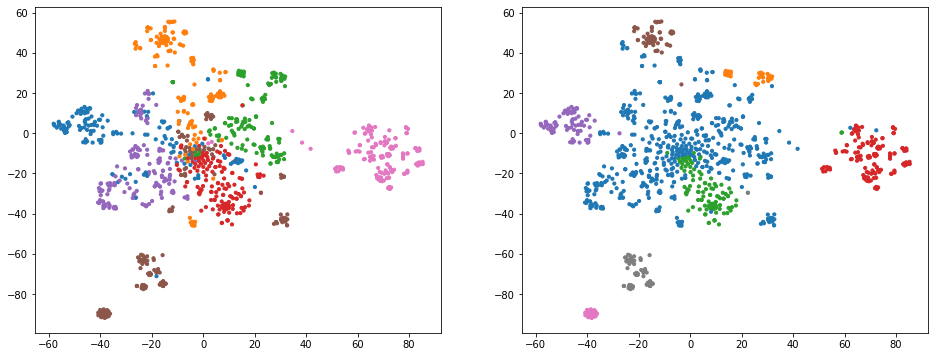

In [165]:
fig, ax = plt.subplots(1,2, figsize=(16,6))
ax[0].scatter(X_proj[:,0], X_proj[:,1], c=y, 
            cmap=ListedColormap(sns.color_palette('tab10'), N=len(set(y))), s=10)
ax[1].scatter(X_proj[:,0], X_proj[:,1], c=X_labels[label], 
            cmap=ListedColormap(sns.color_palette('tab10'), N=len(set(X_labels[label]))), s=10)
plt.show()

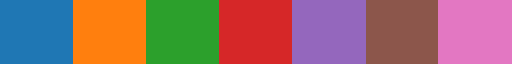

In [149]:
ListedColormap(sns.color_palette('tab10'), N=7)

In [166]:
label_dict_1 = {0:4, 1:2, 2:3, 3:6, 4:0, 5:1, 6:5, 7:5}
#label_dict_1

In [167]:
{i:le.inverse_transform([i])[0] for i in range(7)}

{0: 'Baby Care',
 1: 'Beauty and Personal Care',
 2: 'Computers',
 3: 'Home Decor & Festive Needs',
 4: 'Home Furnishing',
 5: 'Kitchen & Dining',
 6: 'Watches'}

#### Rapport de Classification

In [168]:
cluster_labels = pd.Series(X_labels[label]).map(label_dict_1)
print(classification_report(le.inverse_transform(y), le.inverse_transform(cluster_labels)))

                            precision    recall  f1-score   support

                 Baby Care       1.00      0.51      0.67       150
  Beauty and Personal Care       1.00      0.39      0.56       150
                 Computers       1.00      0.22      0.36       150
Home Decor & Festive Needs       0.93      0.66      0.77       150
           Home Furnishing       0.27      0.99      0.42       150
          Kitchen & Dining       0.97      0.50      0.66       150
                   Watches       1.00      0.94      0.97       150

                  accuracy                           0.60      1050
                 macro avg       0.88      0.60      0.63      1050
              weighted avg       0.88      0.60      0.63      1050



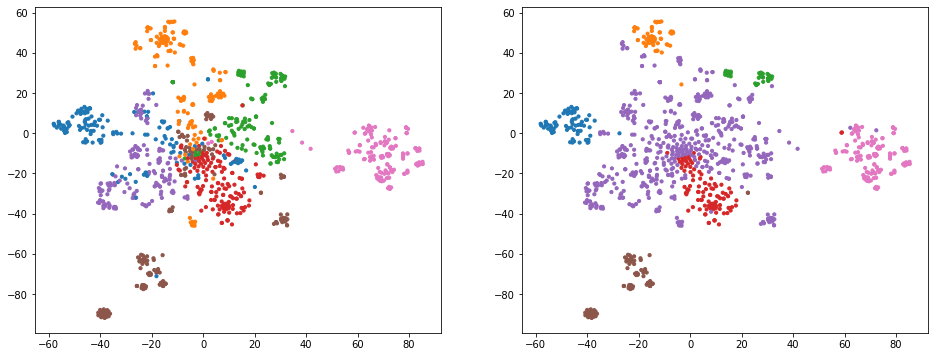

In [169]:
fig, ax = plt.subplots(1,2, figsize=(16,6))
ax[0].scatter(X_proj[:,0], X_proj[:,1], c=y, 
            cmap=ListedColormap(sns.color_palette('tab10'), N=len(set(y))), s=10)
ax[1].scatter(X_proj[:,0], X_proj[:,1], c=cluster_labels, 
            cmap=ListedColormap(sns.color_palette('tab10'), N=len(set(cluster_labels))), s=10)
plt.show()

#### Confusion Matrix

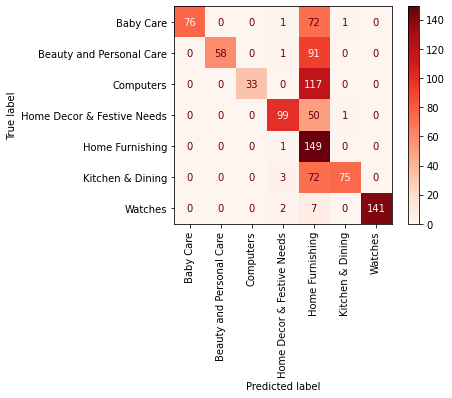

In [172]:
fig, ax = plt.subplots()
confmatrix = metrics.ConfusionMatrixDisplay.from_predictions(y, cluster_labels,
                                                             display_labels=[le.inverse_transform([i])[0] for i in range(7)],
                                                             xticks_rotation='vertical', cmap='Reds', ax=ax)

#### WordCloud

In [170]:
# Instantiate a new wordcloud.
stopwords = [key for key in set(' '.join(X[tok_ver]).split()) if key not in vocabulary_sets[data_ver+'_red'].keys()]
wordcloud = WordCloud(random_state = 8,
            normalize_plurals = False,
            width = 1000, height= 600,
            stopwords = stopwords)

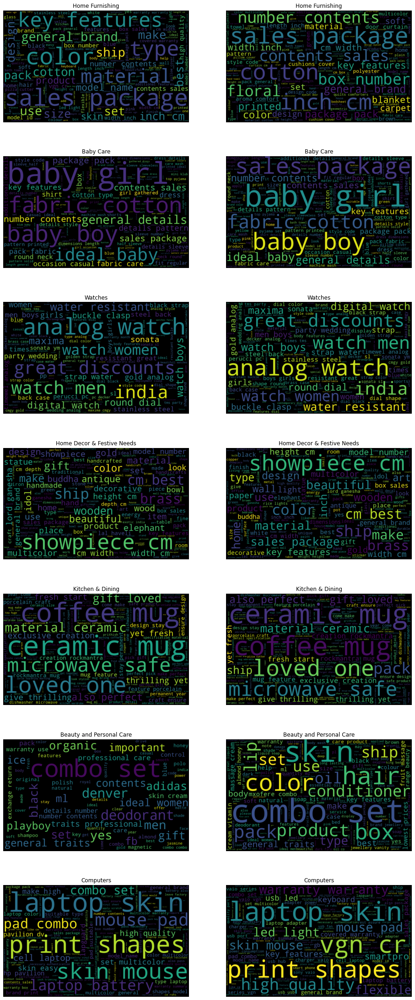

In [171]:
fig, axes = plt.subplots(7,2, figsize = (16,40))
y_cat_cl = pd.Series(le.inverse_transform(cluster_labels))
y_cat = pd.Series(le.inverse_transform(y))

categories = y_cat.unique()
for ii, cl in enumerate(categories):
    # Apply the wordcloud to the text.
    for jj, yy in enumerate([y_cat_cl, y_cat]):
        select = (yy == cl)
        wordcloud.generate(' '.join(X['nltk'][select]))
        # add interpolation = bilinear to smooth things out
        ax = axes[ii][jj]
        ax.imshow(wordcloud, interpolation='bilinear')
        ax.set_title(cl)
        # and remove the axis
        ax.axis("off")
plt.show()

### 4.3.6 Rapport Détaillé du Clustering 'AgglomerativeClustering' avec SpaCy -2

In [173]:
tok_ver='spacy'
data_ver = tok_ver + '_Version1'
proj = 'TSNE2'
X_proj = X_projections[data_ver][proj]["X_proj"]

modelname = "AggClust2"
label = data_ver + '_' + modelname

#### Comparison des Labels

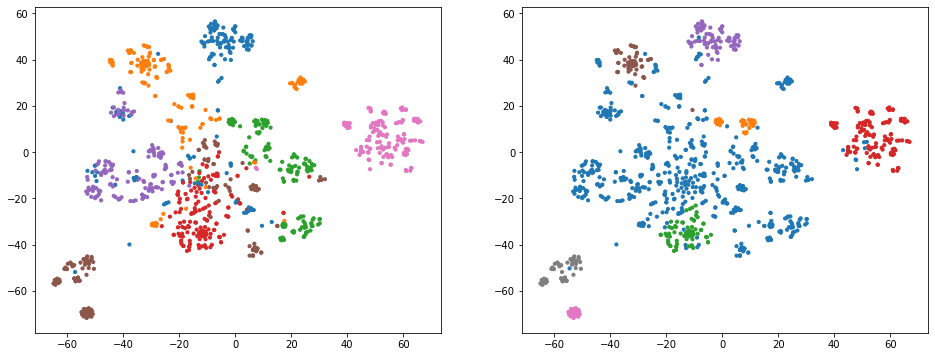

In [174]:
fig, ax = plt.subplots(1,2, figsize=(16,6))
ax[0].scatter(X_proj[:,0], X_proj[:,1], c=y, 
            cmap=ListedColormap(sns.color_palette('tab10'), N=len(set(y))), s=10)
ax[1].scatter(X_proj[:,0], X_proj[:,1], c=X_labels[label], 
            cmap=ListedColormap(sns.color_palette('tab10'), N=len(set(X_labels[label]))), s=10)
plt.show()

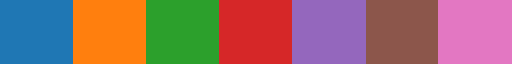

In [175]:
ListedColormap(sns.color_palette('tab10'), N=7)

In [176]:
label_dict_1 = {0:4, 1:2, 2:3, 3:6, 4:0, 5:1, 6:5, 7:5}
#label_dict_1

In [177]:
{i:le.inverse_transform([i])[0] for i in range(7)}

{0: 'Baby Care',
 1: 'Beauty and Personal Care',
 2: 'Computers',
 3: 'Home Decor & Festive Needs',
 4: 'Home Furnishing',
 5: 'Kitchen & Dining',
 6: 'Watches'}

#### Rapport de Classification

In [178]:
cluster_labels = pd.Series(X_labels[label]).map(label_dict_1)
print(classification_report(le.inverse_transform(y), le.inverse_transform(cluster_labels)))

                            precision    recall  f1-score   support

                 Baby Care       1.00      0.54      0.70       150
  Beauty and Personal Care       1.00      0.39      0.56       150
                 Computers       1.00      0.22      0.36       150
Home Decor & Festive Needs       0.99      0.47      0.64       150
           Home Furnishing       0.25      1.00      0.41       150
          Kitchen & Dining       0.99      0.49      0.65       150
                   Watches       1.00      0.94      0.97       150

                  accuracy                           0.58      1050
                 macro avg       0.89      0.58      0.61      1050
              weighted avg       0.89      0.58      0.61      1050



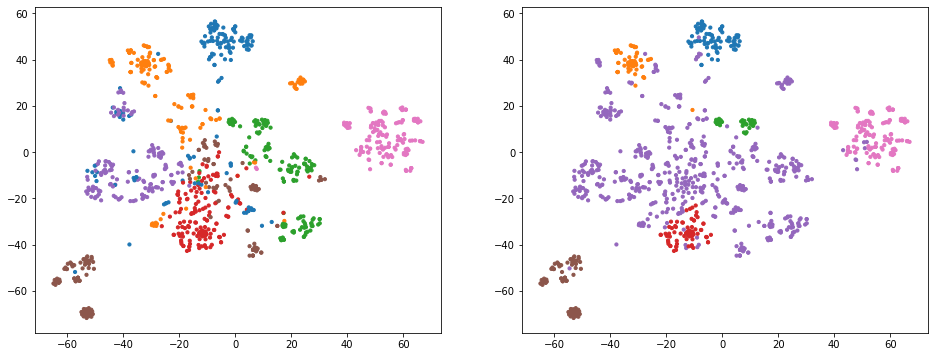

In [179]:
fig, ax = plt.subplots(1,2, figsize=(16,6))
ax[0].scatter(X_proj[:,0], X_proj[:,1], c=y, 
            cmap=ListedColormap(sns.color_palette('tab10'), N=len(set(y))), s=10)
ax[1].scatter(X_proj[:,0], X_proj[:,1], c=cluster_labels, 
            cmap=ListedColormap(sns.color_palette('tab10'), N=len(set(cluster_labels))), s=10)
plt.show()

#### Confusion Matrix

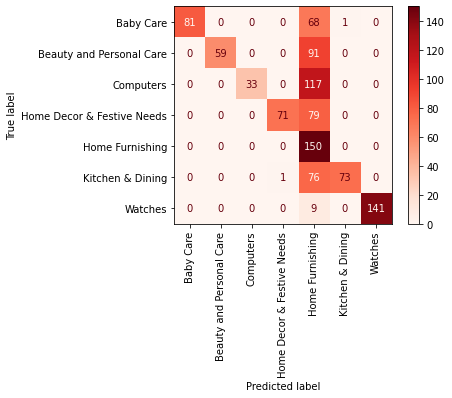

In [180]:
fig, ax = plt.subplots()
confmatrix = metrics.ConfusionMatrixDisplay.from_predictions(y, cluster_labels,
                                                             display_labels=[le.inverse_transform([i])[0] for i in range(7)],
                                                             xticks_rotation='vertical', cmap='Reds', ax=ax)

#### WordCloud

In [ ]:
# Instantiate a new wordcloud.
stopwords = [key for key in set(' '.join(X[tok_ver]).split()) if key not in vocabulary_sets[data_ver+'_red'].keys()]
wordcloud = WordCloud(random_state = 8,
            normalize_plurals = False,
            width = 1000, height= 600,
            stopwords = stopwords)

In [ ]:
fig, axes = plt.subplots(7,2, figsize = (16,40))
y_cat_cl = pd.Series(le.inverse_transform(cluster_labels))
y_cat = pd.Series(le.inverse_transform(y))

categories = y_cat.unique()
for ii, cl in enumerate(categories):
    # Apply the wordcloud to the text.
    for jj, yy in enumerate([y_cat_cl, y_cat]):
        select = (yy == cl)
        wordcloud.generate(' '.join(X['nltk'][select]))
        # add interpolation = bilinear to smooth things out
        ax = axes[ii][jj]
        ax.imshow(wordcloud, interpolation='bilinear')
        ax.set_title(cl)
        # and remove the axis
        ax.axis("off")
plt.show()

## 4.4 SpectralClustering - Version 1

### 4.4.1 Clustering

In [181]:
modelname = "SpecClust"
param_list=[]
score_list=[]
for gamma in np.linspace(1, 9, 10):
    for affinity in ['sigmoid', 'rbf']:
        for coef0 in np.linspace(0.5, 2.5, 11):
            param_list.append((affinity, gamma, coef0))
            #print(f"fitting.... affinity:{affinity} | gamma:{gamma} | coef0:{coef0}")
            for tok_ver in tokenizer_versions:
                data_ver = '_'.join([tok_ver, preprocessor_ver])
                label = data_ver + '_' + modelname
                sp = SpectralClustering(n_clusters = 7, gamma=gamma, affinity=affinity, coef0 = coef0,
                                        assign_labels='discretize', random_state=33)
                X_labels[label] = sp.fit_predict(X_datas[data_ver])
                score_list.append(metrics.adjusted_rand_score(y, X_labels[label]))
            if affinity == 'rbf' : break

In [182]:
avg_score_list = np.array([np.array(score_list[i:i+2]).mean() for i in range(0,len(score_list),2)])
print(f"The best average score was {avg_score_list.max()} with (gamma, coef0) = " +
      f"{param_list[list(avg_score_list).index(avg_score_list.max())]}.")

The best average score was 0.3949186700418915 with (gamma, coef0) = ('sigmoid', 8.11111111111111, 1.5).


In [183]:
modelname = "SpecClust"
gamma = 8.1
coef0 = 1.5
for tok_ver in tokenizer_versions:
    data_ver = '_'.join([tok_ver, preprocessor_ver])
    label = data_ver + '_' + modelname
    sp = SpectralClustering(n_clusters = 7, gamma=gamma, affinity='sigmoid', coef0 = coef0,
                            assign_labels='discretize', random_state=33)
    X_labels[label] = sp.fit_predict(X_datas[data_ver])
    print(f"The rand score for the {tok_ver} data is {metrics.adjusted_rand_score(y, X_labels[label])}")

The rand score for the nltk data is 0.41491723457817803
The rand score for the spacy data is 0.37492010550560506


### 4.4.2 Rapport Détaillé du Clustering 'SpectralClustering' avec NLTK

In [184]:
tok_ver='nltk'
data_ver = tok_ver + '_Version1'
proj = 'TSNE2'
X_proj = X_projections[data_ver][proj]["X_proj"]

modelname = "SpecClust"
label = data_ver + '_' + modelname

#### Comparison des Labels

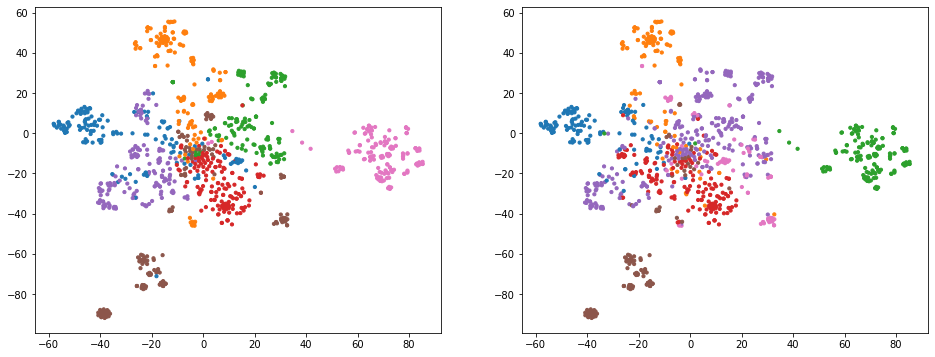

In [185]:
fig, ax = plt.subplots(1,2, figsize=(16,6))
ax[0].scatter(X_proj[:,0], X_proj[:,1], c=y, 
            cmap=ListedColormap(sns.color_palette('tab10'), N=len(set(y))), s=10)
ax[1].scatter(X_proj[:,0], X_proj[:,1], c=X_labels[label], 
            cmap=ListedColormap(sns.color_palette('tab10'), N=len(set(X_labels[label]))), s=10)
plt.show()

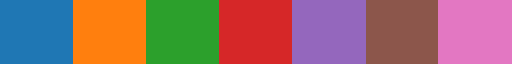

In [186]:
ListedColormap(sns.color_palette('tab10'), N=7)

In [187]:
label_dict_1 = {0:0, 1:1, 2:6, 3:3, 4:2, 5:5, 6:4}
#label_dict_1

In [188]:
{i:le.inverse_transform([i])[0] for i in range(7)}

{0: 'Baby Care',
 1: 'Beauty and Personal Care',
 2: 'Computers',
 3: 'Home Decor & Festive Needs',
 4: 'Home Furnishing',
 5: 'Kitchen & Dining',
 6: 'Watches'}

#### Rapport de Classification

In [189]:
cluster_labels = pd.Series(X_labels[label]).map(label_dict_1)
print(classification_report(le.inverse_transform(y), le.inverse_transform(cluster_labels)))

                            precision    recall  f1-score   support

                 Baby Care       0.80      0.68      0.74       150
  Beauty and Personal Care       0.69      0.55      0.61       150
                 Computers       0.45      0.91      0.60       150
Home Decor & Festive Needs       0.61      0.68      0.64       150
           Home Furnishing       0.00      0.00      0.00       150
          Kitchen & Dining       0.82      0.59      0.68       150
                   Watches       0.99      0.99      0.99       150

                  accuracy                           0.63      1050
                 macro avg       0.62      0.63      0.61      1050
              weighted avg       0.62      0.63      0.61      1050



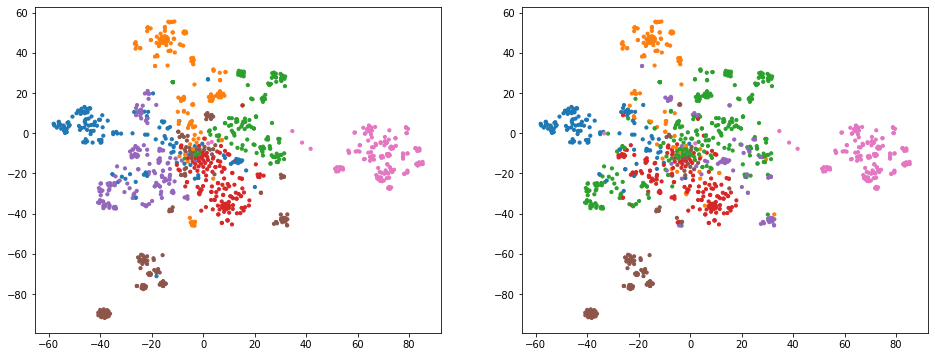

In [190]:
fig, ax = plt.subplots(1,2, figsize=(16,6))
ax[0].scatter(X_proj[:,0], X_proj[:,1], c=y, 
            cmap=ListedColormap(sns.color_palette('tab10'), N=len(set(y))), s=10)
ax[1].scatter(X_proj[:,0], X_proj[:,1], c=cluster_labels, 
            cmap=ListedColormap(sns.color_palette('tab10'), N=len(set(cluster_labels))), s=10)
plt.show()

#### Confusion Matrix

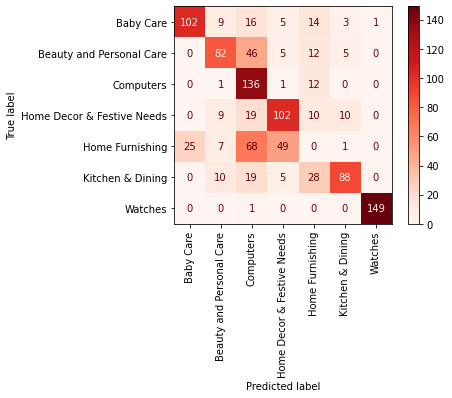

In [192]:
fig, ax = plt.subplots()
confmatrix = metrics.ConfusionMatrixDisplay.from_predictions(y, cluster_labels,
                                                             display_labels=[le.inverse_transform([i])[0] for i in range(7)],
                                                             xticks_rotation='vertical', cmap='Reds', ax=ax)

#### WordCloud

In [ ]:
# Instantiate a new wordcloud.
stopwords = [key for key in set(' '.join(X[tok_ver]).split()) if key not in vocabulary_sets[data_ver+'_red'].keys()]
wordcloud = WordCloud(random_state = 8,
            normalize_plurals = False,
            width = 1000, height= 600,
            stopwords = stopwords)

In [ ]:
fig, axes = plt.subplots(7,2, figsize = (16,40))
y_cat_cl = pd.Series(le.inverse_transform(cluster_labels))
y_cat = pd.Series(le.inverse_transform(y))

categories = y_cat.unique()
for ii, cl in enumerate(categories):
    # Apply the wordcloud to the text.
    for jj, yy in enumerate([y_cat_cl, y_cat]):
        select = (yy == cl)
        wordcloud.generate(' '.join(X['spacy'][select]))
        # add interpolation = bilinear to smooth things out
        ax = axes[ii][jj]
        ax.imshow(wordcloud, interpolation='bilinear')
        ax.set_title(cl)
        # and remove the axis
        ax.axis("off")
plt.show()

### 4.4.3 Rapport Détaillé du Clustering 'SpectralClustering' avec SpaCy

In [193]:
tok_ver='spacy'
data_ver = tok_ver + '_Version1'
proj = 'TSNE2'
X_proj = X_projections[data_ver][proj]["X_proj"]

modelname = "SpecClust"
label = data_ver + '_' + modelname

#### Comparision des Labels

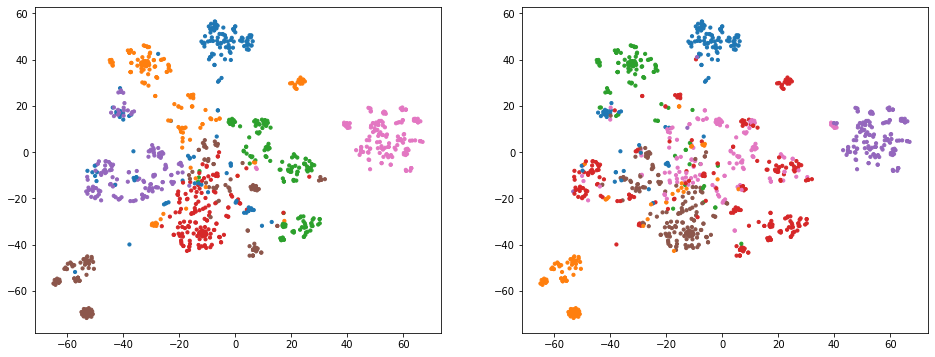

In [194]:
fig, ax = plt.subplots(1,2, figsize=(16,6))
ax[0].scatter(X_proj[:,0], X_proj[:,1], c=y, 
            cmap=ListedColormap(sns.color_palette('tab10'), N=len(set(y))), s=10)
ax[1].scatter(X_proj[:,0], X_proj[:,1], c=X_labels[label], 
            cmap=ListedColormap(sns.color_palette('tab10'), N=len(set(X_labels[label]))), s=10)
plt.show()

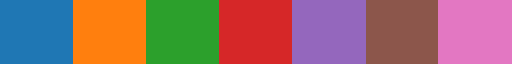

In [195]:
ListedColormap(sns.color_palette('tab10'), N=7)

In [196]:
label_dict_1 = {0:0, 1:5, 2:1, 3:4, 4:6, 5:3, 6:2}
#label_dict_1

In [197]:
cat_dict = {i:le.inverse_transform([i])[0] for i in range(7)}

In [198]:
le.inverse_transform([i for i in range(7)]) 

array(['Baby Care', 'Beauty and Personal Care', 'Computers',
       'Home Decor & Festive Needs', 'Home Furnishing',
       'Kitchen & Dining', 'Watches'], dtype=object)

#### Rapport de Classification

In [199]:
cluster_labels = pd.Series(X_labels[label]).map(label_dict_1)
print(classification_report(le.inverse_transform(y), le.inverse_transform(cluster_labels)))

                            precision    recall  f1-score   support

                 Baby Care       0.79      0.66      0.72       150
  Beauty and Personal Care       0.75      0.55      0.63       150
                 Computers       0.40      0.39      0.40       150
Home Decor & Festive Needs       0.65      0.71      0.68       150
           Home Furnishing       0.23      0.39      0.29       150
          Kitchen & Dining       0.79      0.55      0.65       150
                   Watches       0.98      0.95      0.96       150

                  accuracy                           0.60      1050
                 macro avg       0.66      0.60      0.62      1050
              weighted avg       0.66      0.60      0.62      1050



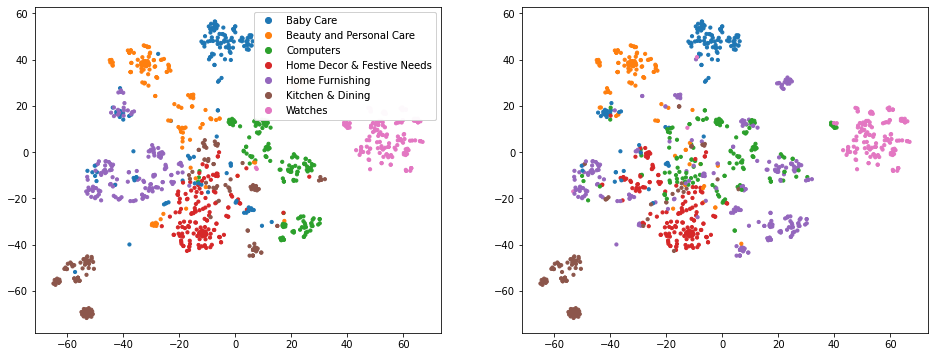

In [200]:
fig, ax = plt.subplots(1,2, figsize=(16,6))
ax[0].scatter(X_proj[:,0], X_proj[:,1], c=y, 
            cmap=ListedColormap(sns.color_palette('tab10'), N=len(set(y))), s=10)
scatter = ax[1].scatter(X_proj[:,0], X_proj[:,1], c=cluster_labels, 
            cmap=ListedColormap(sns.color_palette('tab10'), N=len(set(cluster_labels))), s=10)

legend1 = ax[0].legend(scatter.legend_elements()[0], list(cat_dict.values()) , loc="best")
ax[0].add_artist(legend1 )

plt.show()

#### Confusion Matrix

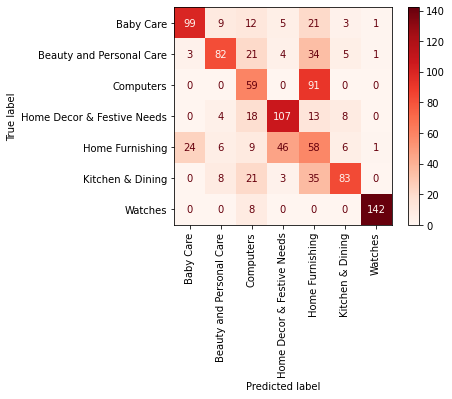

In [201]:
fig, ax = plt.subplots()
confmatrix = metrics.ConfusionMatrixDisplay.from_predictions(y, cluster_labels,
                                                             display_labels=[le.inverse_transform([i])[0] for i in range(7)],
                                                             xticks_rotation='vertical', cmap='Reds', ax=ax)

#### WordCloud

In [ ]:
# Instantiate a new wordcloud.
stopwords = [key for key in set(' '.join(X[tok_ver]).split()) if key not in vocabulary_sets[data_ver+'_red'].keys()]
wordcloud = WordCloud(random_state = 8,
            normalize_plurals = False,
            width = 1000, height= 600,
            stopwords = stopwords)

In [ ]:
fig, axes = plt.subplots(7,2, figsize = (16,40))
y_cat_cl = pd.Series(le.inverse_transform(cluster_labels))
y_cat = pd.Series(le.inverse_transform(y))

categories = y_cat.unique()
for ii, cl in enumerate(categories):
    # Apply the wordcloud to the text.
    for jj, yy in enumerate([y_cat_cl, y_cat]):
        select = (yy == cl)
        wordcloud.generate(' '.join(X['spacy'][select]))
        # add interpolation = bilinear to smooth things out
        ax = axes[ii][jj]
        ax.imshow(wordcloud, interpolation='bilinear')
        ax.set_title(cl)
        # and remove the axis
        ax.axis("off")
plt.show()

# 5. Prétraitement - Version 2

## 5.1 Les Categories - le target

In [202]:
le = LabelEncoder()
cat = 'category_level1'
y = le.fit_transform(text_df[cat])

## 5.2 Les Documents - les variables

In [203]:
X = pd.DataFrame()
tokenizer_versions = ['nltk', 'spacy']
for tok_ver in tokenizer_versions:
    X[tok_ver] = text_df['document_' + tok_ver + '_2']

## 5.3 Le Prétraitement - réduction de Vocabulaire et de Dimension

In [204]:
preprocessor_ver = 'Version2'
ngram_range = (1,2)
max_df = 2/7
min_df = 0.03/7
alpha = 0.01
#n_components = 0.99
n_components = 450
stop_words = ['replacement', 'guarantee', 'one','day', 'free', 'shipping', 'genuine', 'price', 'prices',
             'cash', 'delivery','rs', 'package', 'contents', 'content', 'sales', 'sale', 'details', 'detail',
             'flipkart', 'com', 'online', 'buy', 'discount', 'discounts', 'general', 'specification', 'specifications',
             'pack', 'packs', 'good','great', 'best', 'type', 'types', 'model','number', 'numbers', 'feature', 'features',
             'material', 'materials', 'brand', 'perfect', 'ideal', 'box', 'high', 'quality', 'quantity','exclusive', 
             'color', 'colour', 'size', 'sizes', 'dimension', 'dimensions', 'style', 'styles', 'design', 'beautiful']

In [205]:
vectorizer = CountVectorizer(ngram_range=ngram_range, max_df = max_df, min_df = min_df, stop_words=stop_words)
selector = SelectFpr(chi2, alpha=alpha)
transformer = TfidfTransformer()
#pca = PCA(n_components=n_components, svd_solver = 'full')
svd = TruncatedSVD(n_components=n_components, algorithm='arpack')

### 5.3.1 Réduction de Vocabulaire avec CountVectorizer et SelectFpr(alpha=0.01)

In [206]:
X_vec = {}
X_prep = {}

In [207]:
for tok_ver in tokenizer_versions :
    X_vec[tok_ver] = vectorizer.fit_transform(X[tok_ver])
    X_vec[tok_ver] = selector.fit_transform(X_vec[tok_ver], y)
    vocab_dict = vectorizer.vocabulary_
    vocab_dict_rev = {v:k for k,v in vocab_dict.items()}
    reduced_vocab_dict = { vocab_dict_rev[int(x.lstrip('x'))]  : int(x.lstrip('x')) for x in selector.get_feature_names_out()}
    data_ver = '_'.join([tok_ver, preprocessor_ver])
    vocabulary_sets[data_ver] = vocab_dict.copy()
    vocabulary_sets[data_ver+'_red'] = reduced_vocab_dict.copy()
    print(f"The vocabulary for the {tok_ver} tokenized data was reduced from " +
          f"{len(vocab_dict)} to {len(reduced_vocab_dict)} words.")

The vocabulary for the nltk tokenized data was reduced from 1785 to 1624 words.
The vocabulary for the spacy tokenized data was reduced from 1716 to 1555 words.


### 5.3.2 Réduction de Dimension avec TfidfTransformer et TruncatedSVD(n_components=450)

In [208]:
for tok_ver in tokenizer_versions :
    X_vec[tok_ver] = transformer.fit_transform(X_vec[tok_ver])
    X_prep[tok_ver] = svd.fit_transform(X_vec[tok_ver])#.toarray())
    data_ver = '_'.join([tok_ver, preprocessor_ver])
    print(f"The number of dimensions the {tok_ver} tokenized data was reduced from " +
          f"{len(vocabulary_sets[data_ver+'_red'])} to {X_prep[tok_ver].shape[1]}.")

The number of dimensions the nltk tokenized data was reduced from 1624 to 450.
The number of dimensions the spacy tokenized data was reduced from 1555 to 450.


## 5.4 Le Preprocessor - rationalisation du prétraitement

In [209]:
preprocessor = Pipeline(steps=[('vectorizer', vectorizer),
                               ('selector', selector),
                               ('transformer', transformer),
                               ('svd', svd),
                               ])

In [210]:
for tok_ver in tokenizer_versions :
    data_ver = '_'.join([tok_ver, preprocessor_ver])
    X_datas[data_ver] = preprocessor.fit_transform(X[tok_ver], y)
    preprocessors[data_ver] = preprocessor

## 5.5 Projection en 2D 

### 5.5.0 Initialisation

In [211]:
preprocessor_ver = 'Version2'
for tok_ver in tokenizer_versions :
    data_ver = '_'.join([tok_ver, preprocessor_ver])
    X_projections[data_ver] = {}

### 5.5.1 Les Différentes Projections

#### PCA

In [212]:
proj_name = "PCA"
proj = PCA(n_components=2)
for tok_ver in tokenizer_versions :
    data_ver = '_'.join([tok_ver, preprocessor_ver])
    X_tmp = proj.fit_transform(X_datas[data_ver])
    X_projections[data_ver][proj_name] = {"X_proj" : X_tmp}

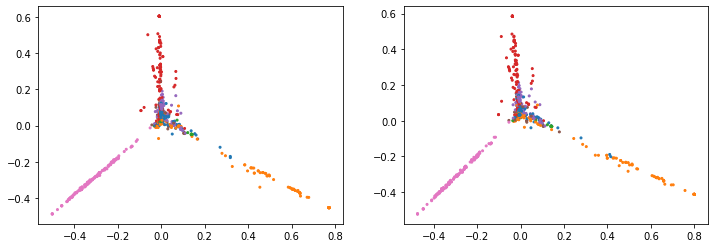

In [213]:
fig, axs = plt.subplots(1,2, figsize=(12,4))
for i, tok_ver in enumerate(tokenizer_versions) :
    data_ver = '_'.join([tok_ver, preprocessor_ver])
    X_tmp = X_projections[data_ver][proj_name]["X_proj"]
    axs[i].scatter(X_tmp[:,0], X_tmp[:,1], c=y, 
            cmap=ListedColormap(sns.color_palette('tab10'), N=len(set(y))), s=4)
    axs[i].grid(False)
    #plt.xlim(-0.0005, 0.0005)
    #plt.ylim(-0.001, 0.0005)
plt.show()

#### MDS

In [214]:
proj_name = "MDS"
proj = MDS(n_components=2, random_state = 33)
for tok_ver in tokenizer_versions :
    data_ver = '_'.join([tok_ver, preprocessor_ver])
    X_tmp = proj.fit_transform(X_datas[data_ver])
    X_projections[data_ver][proj_name] = {"X_proj" : X_tmp}

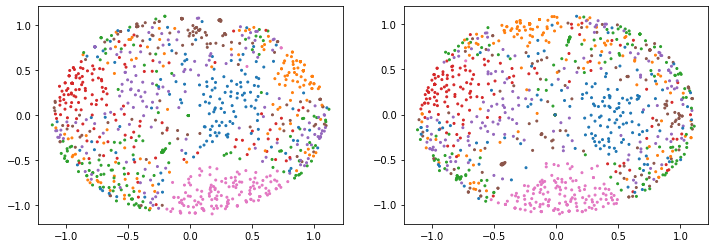

In [215]:
fig, axs = plt.subplots(1,2, figsize=(12,4))
for i, tok_ver in enumerate(tokenizer_versions) :
    data_ver = '_'.join([tok_ver, preprocessor_ver])
    X_tmp = X_projections[data_ver][proj_name]["X_proj"]
    axs[i].scatter(X_tmp[:,0], X_tmp[:,1], c=y, 
            cmap=ListedColormap(sns.color_palette('tab10'), N=len(set(y))), s=4)
    #plt.xlim(-0.0005, 0.0005)
    #plt.ylim(-0.001, 0.0005)
plt.show()

#### Isomap

In [216]:
proj_name = "Isomap"
proj = Isomap(n_components=2, eigen_solver='dense', n_neighbors=80)
for tok_ver in tokenizer_versions :
    data_ver = '_'.join([tok_ver, preprocessor_ver])
    X_tmp = proj.fit_transform(X_datas[data_ver])
    X_projections[data_ver][proj_name] = {"X_proj" : X_tmp}

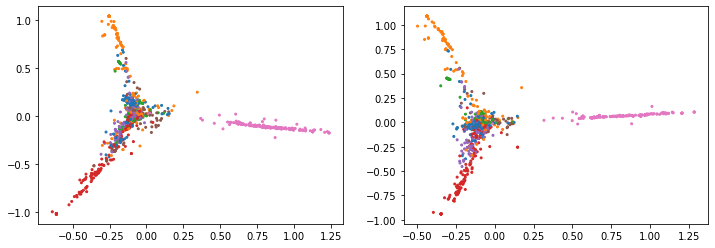

In [217]:
fig, axs = plt.subplots(1,2, figsize=(12,4))
for i, tok_ver in enumerate(tokenizer_versions) :
    data_ver = '_'.join([tok_ver, preprocessor_ver])
    X_tmp = X_projections[data_ver][proj_name]["X_proj"]
    axs[i].scatter(X_tmp[:,0], X_tmp[:,1], c=y, 
            cmap=ListedColormap(sns.color_palette('tab10'), N=len(set(y))), s=4)
    #plt.xlim(-0.0005, 0.0005)
    #plt.ylim(-0.001, 0.0005)
plt.show()

#### TSNE0

In [218]:
proj_name = "TSNE0"
proj = TSNE(n_components=2, init='pca',random_state=33, angle=0.85)
for tok_ver in tokenizer_versions :
    data_ver = '_'.join([tok_ver, preprocessor_ver])
    X_tmp = proj.fit_transform(X_datas[data_ver])
    X_projections[data_ver][proj_name] = {"X_proj" : X_tmp}

c:\users\bookj\environments\jupenv\lib\site-packages\sklearn\manifold\_t_sne.py:790: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
c:\users\bookj\environments\jupenv\lib\site-packages\sklearn\manifold\_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(
c:\users\bookj\environments\jupenv\lib\site-packages\sklearn\manifold\_t_sne.py:790: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
c:\users\bookj\environments\jupenv\lib\site-packages\sklearn\manifold\_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


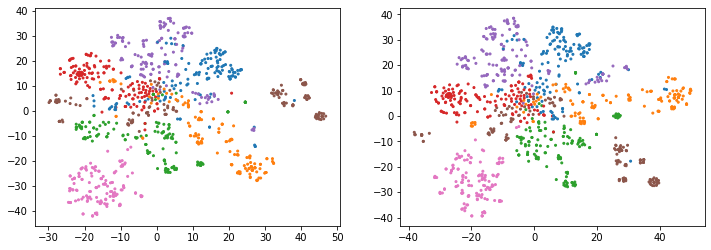

In [219]:
fig, axs = plt.subplots(1,2, figsize=(12,4))
for i, tok_ver in enumerate(tokenizer_versions) :
    data_ver = '_'.join([tok_ver, preprocessor_ver])
    X_tmp = X_projections[data_ver][proj_name]["X_proj"]
    axs[i].scatter(X_tmp[:,0], X_tmp[:,1], c=y, 
            cmap=ListedColormap(sns.color_palette('tab10'), N=len(set(y))), s=4)
    #plt.xlim(-0.0005, 0.0005)
    #plt.ylim(-0.001, 0.0005)
plt.show()

#### TSNE1

In [220]:
proj_name = "TSNE1"
proj = TSNE(n_components=2, learning_rate='auto', init='pca',random_state=33, angle=0.85)
for tok_ver in tokenizer_versions :
    data_ver = '_'.join([tok_ver, preprocessor_ver])
    X_tmp = proj.fit_transform(X_datas[data_ver])
    X_projections[data_ver][proj_name] = {"X_proj" : X_tmp}

c:\users\bookj\environments\jupenv\lib\site-packages\sklearn\manifold\_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(
c:\users\bookj\environments\jupenv\lib\site-packages\sklearn\manifold\_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


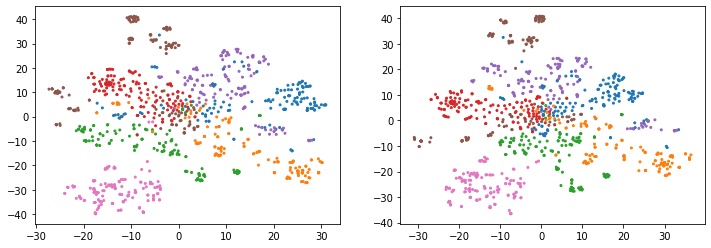

In [221]:
fig, axs = plt.subplots(1,2, figsize=(12,4))
for i, tok_ver in enumerate(tokenizer_versions) :
    data_ver = '_'.join([tok_ver, preprocessor_ver])
    X_tmp = X_projections[data_ver][proj_name]["X_proj"]
    axs[i].scatter(X_tmp[:,0], X_tmp[:,1], c=y, 
            cmap=ListedColormap(sns.color_palette('tab10'), N=len(set(y))), s=4)
    #plt.xlim(-0.0005, 0.0005)
    #plt.ylim(-0.001, 0.0005)
plt.show()

#### TSNE2

In [222]:
proj_name = "TSNE2"
proj = TSNE(n_components=2, perplexity=22, learning_rate=800, early_exaggeration=10, n_iter=5000, min_grad_norm = 1e-10,
            init='pca',random_state=33, angle=0.90)
for tok_ver in tokenizer_versions :
    data_ver = '_'.join([tok_ver, preprocessor_ver])
    X_tmp = proj.fit_transform(X_datas[data_ver])
    X_projections[data_ver][proj_name] = {"X_proj" : X_tmp}

c:\users\bookj\environments\jupenv\lib\site-packages\sklearn\manifold\_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(
c:\users\bookj\environments\jupenv\lib\site-packages\sklearn\manifold\_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


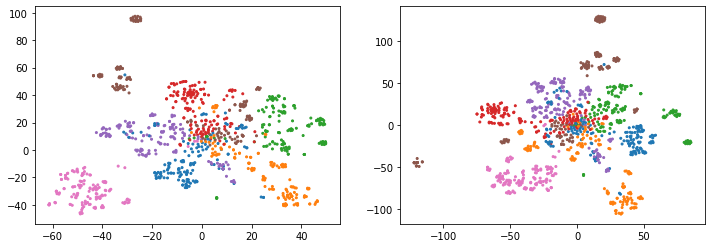

In [223]:
fig, axs = plt.subplots(1,2, figsize=(12,4))
for i, tok_ver in enumerate(tokenizer_versions) :
    data_ver = '_'.join([tok_ver, preprocessor_ver])
    X_tmp = X_projections[data_ver][proj_name]["X_proj"]
    axs[i].scatter(X_tmp[:,0], X_tmp[:,1], c=y, 
            cmap=ListedColormap(sns.color_palette('tab10'), N=len(set(y))), s=4)
    #plt.xlim(-0.0005, 0.0005)
    #plt.ylim(-0.001, 0.0005)
plt.show()

#### LocallyLinearEmbedding

In [472]:
proj_name = "LLE"
proj = LocallyLinearEmbedding(n_components=2, n_neighbors = 10, eigen_solver='dense', )
for tok_ver in tokenizer_versions :
    data_ver = '_'.join([tok_ver, preprocessor_ver])
    X_tmp = proj.fit_transform(X_datas[data_ver])
    X_projections[data_ver][proj_name] = {"X_proj" : X_tmp}

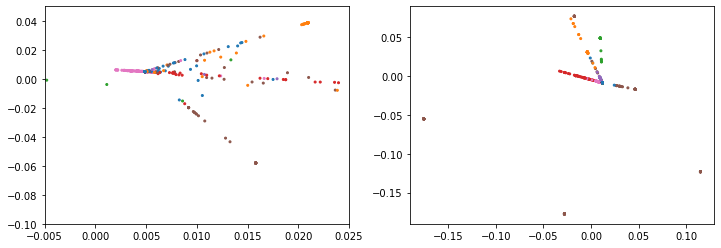

In [473]:
fig, axs = plt.subplots(1,2, figsize=(12,4))
for i, tok_ver in enumerate(tokenizer_versions) :
    data_ver = '_'.join([tok_ver, preprocessor_ver])
    X_tmp = X_projections[data_ver][proj_name]["X_proj"]
    axs[i].scatter(X_tmp[:,0], X_tmp[:,1], c=y, 
            cmap=ListedColormap(sns.color_palette('tab10'), N=len(set(y))), s=4)
axs[0].set_xlim(-0.005, 0.025)
axs[0].set_ylim(-0.1, 0.05)
plt.show()

####  SpectralEmbedding

In [474]:
proj_name = "SpecEmbedding"
proj = SpectralEmbedding(n_components=2, n_neighbors=60)
for tok_ver in tokenizer_versions :
    data_ver = '_'.join([tok_ver, preprocessor_ver])
    X_tmp = proj.fit_transform(X_datas[data_ver])
    X_projections[data_ver][proj_name] = {"X_proj" : X_tmp}

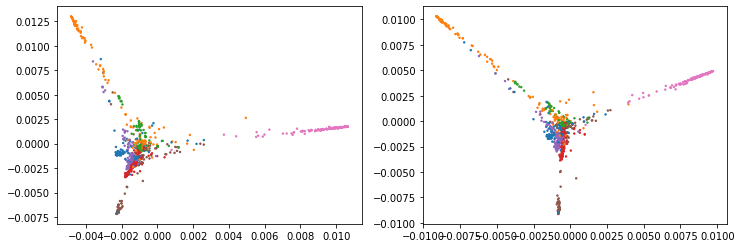

In [475]:
fig, axs = plt.subplots(1,2, figsize=(12,4))
for i, tok_ver in enumerate(tokenizer_versions) :
    data_ver = '_'.join([tok_ver, preprocessor_ver])
    X_tmp = X_projections[data_ver][proj_name]["X_proj"]
    axs[i].scatter(X_tmp[:,0], X_tmp[:,1], c=y, 
            cmap=ListedColormap(sns.color_palette('tab10'), N=len(set(y))), s=2)
    #plt.xlim(-0.0005, 0.0005)
    #plt.ylim(-0.001, 0.0005)
plt.show()

### 3.5.2 Manifold apprentissage

Pris du website de SKlearn : 
https://scikit-learn.org/stable/auto_examples/manifold/plot_lle_digits.html#sphx-glr-auto-examples-manifold-plot-lle-digits-py

In [476]:
n_neighbors = 60

embeddings = {
    "Random projection embedding": SparseRandomProjection(
        n_components=2, random_state=42
    ),
    "Truncated SVD embedding": TruncatedSVD(n_components=2),
    "Linear Discriminant Analysis embedding": LinearDiscriminantAnalysis(
        n_components=2
    ),
    "Isomap embedding": Isomap(n_neighbors=n_neighbors, n_components=2),
    "Standard LLE embedding": LocallyLinearEmbedding(
        n_neighbors=n_neighbors, n_components=2, method="standard"
    ),
    "Modified LLE embedding": LocallyLinearEmbedding(
        n_neighbors=n_neighbors, n_components=2, method="modified"
    ),
    "Hessian LLE embedding": LocallyLinearEmbedding(
        n_neighbors=n_neighbors, n_components=2, method="hessian", eigen_solver="dense"
    ),
    "LTSA LLE embedding": LocallyLinearEmbedding(
        n_neighbors=n_neighbors, n_components=2, method="ltsa", eigen_solver="dense" 
    ),
    "MDS embedding": MDS(n_components=2, n_init=1, max_iter=120, n_jobs=2),
    "Random Trees embedding": make_pipeline(
        RandomTreesEmbedding(n_estimators=200, max_depth=5, random_state=0),
        TruncatedSVD(n_components=2),
    ),
    "Spectral embedding": SpectralEmbedding(
        n_components=2, random_state=0, eigen_solver="arpack"
    ),
    "t-SNE embedding": TSNE(
        n_components=2,
        init="pca",
        learning_rate="auto",
        n_iter=500,
        n_iter_without_progress=150,
        n_jobs=2,
        random_state=0,
    ),
    "NCA embedding": NeighborhoodComponentsAnalysis(
        n_components=2, init="pca", random_state=0
    ),
}

In [477]:
X_prep['nltk'] = preprocessor.fit_transform(X['nltk'], y)

projections_embd, timing = {}, {}
for name, transformer_embd in embeddings.items():
    if name.startswith("Linear Discriminant Analysis"):
        data = X_prep['nltk'].copy()
        data.flat[:: X_prep['nltk'].shape[1] + 1] += 0.01  # Make X invertible
    else:
        data = X_prep['nltk']

    print(f"Computing {name}...")
    start_time = time()
    projections_embd[name] = transformer_embd.fit_transform(data, y)
    timing[name] = time() - start_time

Computing Random projection embedding...
Computing Truncated SVD embedding...
Computing Linear Discriminant Analysis embedding...
Computing Isomap embedding...
Computing Standard LLE embedding...
Computing Modified LLE embedding...
Computing Hessian LLE embedding...
Computing LTSA LLE embedding...
Computing MDS embedding...
Computing Random Trees embedding...
Computing Spectral embedding...
Computing t-SNE embedding...


c:\users\bookj\environments\jupenv\lib\site-packages\sklearn\manifold\_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


Computing NCA embedding...


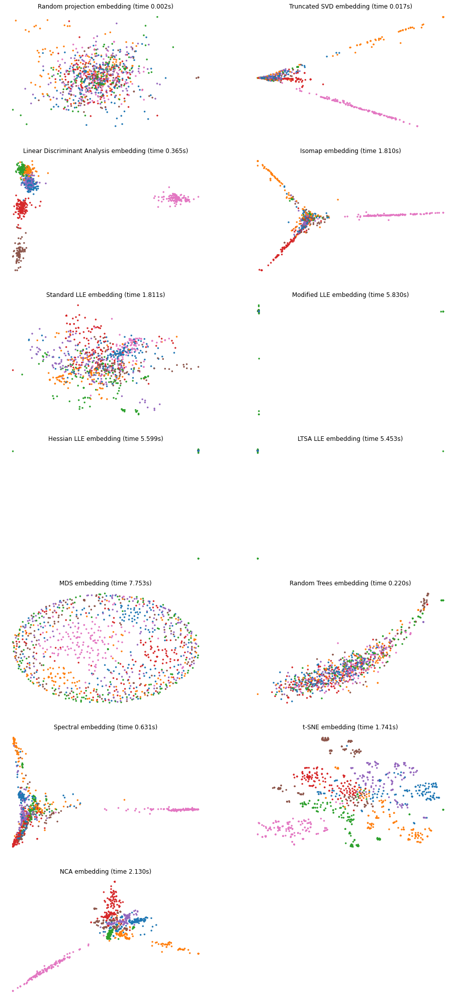

In [478]:
fig, axs = plt.subplots(nrows=7, ncols=2, figsize=(16, 36))

for name, ax in zip_longest(timing, axs.ravel()):
    if name is None:
        ax.axis("off")
        continue
    title = f"{name} (time {timing[name]:.3f}s)"
    plot_embedding(projections_embd[name], y, title, ax)

plt.show()

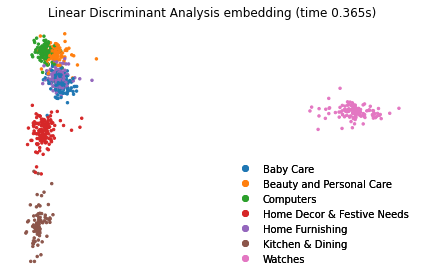

In [479]:
name = "Linear Discriminant Analysis embedding"
fig, ax = plt.subplots(figsize=(6, 4))
title = f"{name} (time {timing[name]:.3f}s)"
scatter = plot_embedding(projections_embd[name], y, title, ax)
legend1 = ax.legend(scatter.legend_elements()[0], le.inverse_transform([i for i in range(7)]),
                    loc="lower right", frameon=False)
ax.add_artist(legend1)
plt.tight_layout()

# 6. Clustering - Version 2

In [224]:
preprocessor_ver = 'Version2'

## 6.1 KMeans - Version2

### 6.1.1 Clustering

In [225]:
modelname = "KMeans"
nltk_scores=[]
spacy_scores=[]

for i in range(10):
    for tok_ver in tokenizer_versions:
        data_ver = '_'.join([tok_ver, preprocessor_ver])
        label = data_ver + '_' + modelname
        km = KMeans(n_clusters=7, n_init = 50, algorithm='full')
        X_labels[label] = km.fit_predict(X_datas[data_ver])
        if tok_ver == 'nltk' :
            nltk_scores.append(metrics.adjusted_rand_score(y, X_labels[label]))
        elif tok_ver == 'spacy' :
            spacy_scores.append(metrics.adjusted_rand_score(y, X_labels[label]))

print(f"The rand score for the nltk data is {round(np.array(nltk_scores).mean(),3)} " +
      f"+/- {round(np.array(nltk_scores).std(),3)}.")
print(f"The rand score for the spacy data is {round(np.array(spacy_scores).mean(),3)} " +
      f"+/- {round(np.array(spacy_scores).std(),3)}.")

The rand score for the nltk data is 0.238 +/- 0.007.
The rand score for the spacy data is 0.245 +/- 0.016.


In [226]:
for tok_ver in tokenizer_versions:
        data_ver = '_'.join([tok_ver, preprocessor_ver])
        label = data_ver + '_' + modelname
        km = KMeans(n_clusters=7, n_init = 50, algorithm='full', random_state=33)
        X_labels[label] = km.fit_predict(X_datas[data_ver])
        print(f"The rand score for the {data_ver} data is {round(metrics.adjusted_rand_score(y, X_labels[label]),3)}.")

The rand score for the nltk_Version2 data is 0.242.
The rand score for the spacy_Version2 data is 0.236.


### 6.1.2 Rapport Détaillé du Clustering 'KMeans' avec NLTK

In [227]:
tok_ver='nltk'
data_ver = tok_ver + '_Version2'
proj = 'TSNE0'
X_proj = X_projections[data_ver][proj]["X_proj"]

modelname = "KMeans"
label = data_ver + '_' + modelname

#### Comparision des Labels

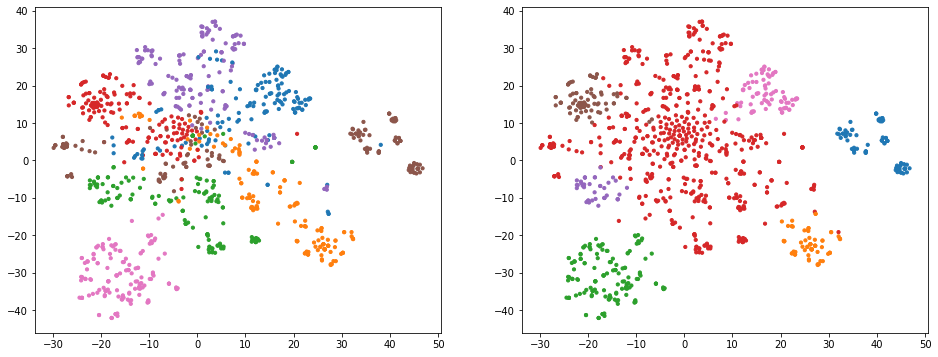

In [228]:
fig, ax = plt.subplots(1,2, figsize=(16,6))
ax[0].scatter(X_proj[:,0], X_proj[:,1], c=y, 
            cmap=ListedColormap(sns.color_palette('tab10'), N=len(set(y))), s=10)
ax[1].scatter(X_proj[:,0], X_proj[:,1], c=X_labels[label], 
            cmap=ListedColormap(sns.color_palette('tab10'), N=len(set(X_labels[label]))), s=10)
plt.show()

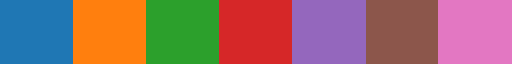

In [229]:
ListedColormap(sns.color_palette('tab10'), N=7)

In [230]:
label_dict_1 = {0:5, 1:1, 2:6, 3:4, 4:2, 5:3, 6:0}
#label_dict_1

In [231]:
{i:le.inverse_transform([i])[0] for i in range(7)}

{0: 'Baby Care',
 1: 'Beauty and Personal Care',
 2: 'Computers',
 3: 'Home Decor & Festive Needs',
 4: 'Home Furnishing',
 5: 'Kitchen & Dining',
 6: 'Watches'}

#### Rapport de Classification

In [232]:
cluster_labels = pd.Series(X_labels[label]).map(label_dict_1)
print(classification_report(le.inverse_transform(y), le.inverse_transform(cluster_labels)))

                            precision    recall  f1-score   support

                 Baby Care       1.00      0.53      0.70       150
  Beauty and Personal Care       0.97      0.45      0.62       150
                 Computers       1.00      0.27      0.43       150
Home Decor & Festive Needs       1.00      0.50      0.67       150
           Home Furnishing       0.27      1.00      0.42       150
          Kitchen & Dining       0.99      0.49      0.66       150
                   Watches       1.00      0.98      0.99       150

                  accuracy                           0.60      1050
                 macro avg       0.89      0.60      0.64      1050
              weighted avg       0.89      0.60      0.64      1050



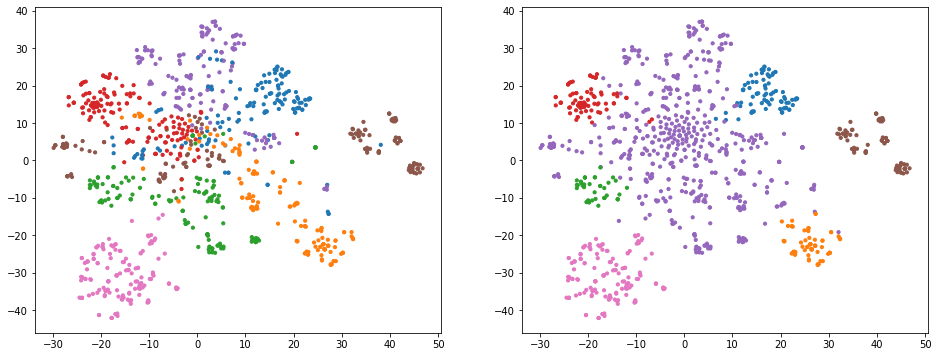

In [233]:
fig, ax = plt.subplots(1,2, figsize=(16,6))
ax[0].scatter(X_proj[:,0], X_proj[:,1], c=y, 
            cmap=ListedColormap(sns.color_palette('tab10'), N=len(set(y))), s=10)
ax[1].scatter(X_proj[:,0], X_proj[:,1], c=cluster_labels, 
            cmap=ListedColormap(sns.color_palette('tab10'), N=len(set(cluster_labels))), s=10)
plt.show()

#### Confusion Matrix

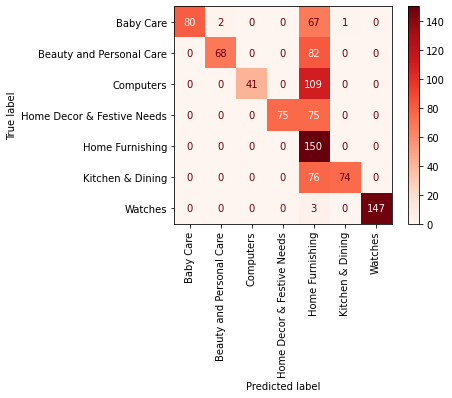

In [235]:
fig, ax = plt.subplots()
confmatrix = metrics.ConfusionMatrixDisplay.from_predictions(y, cluster_labels,
                                                             display_labels=[le.inverse_transform([i])[0] for i in range(7)],
                                                             xticks_rotation='vertical', cmap='Reds', ax=ax)

#### WordCloud

In [489]:
# Instantiate a new wordcloud.
stopwords = [key for key in set(' '.join(X[tok_ver]).split()) if key not in vocabulary_sets[data_ver+'_red'].keys()]
wordcloud = WordCloud(random_state = 8,
            normalize_plurals = False,
            width = 1000, height= 600,
            stopwords = stopwords)

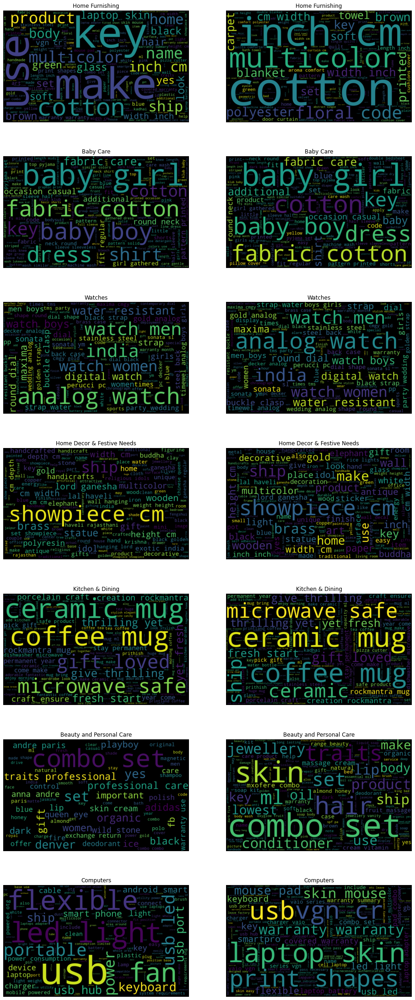

In [490]:
fig, axes = plt.subplots(7,2, figsize = (16,40))
y_cat_cl = pd.Series(le.inverse_transform(cluster_labels))
y_cat = pd.Series(le.inverse_transform(y))

categories = y_cat.unique()
for ii, cl in enumerate(categories):
    # Apply the wordcloud to the text.
    for jj, yy in enumerate([y_cat_cl, y_cat]):
        select = (yy == cl)
        wordcloud.generate(' '.join(X['nltk'][select]))
        # add interpolation = bilinear to smooth things out
        ax = axes[ii][jj]
        ax.imshow(wordcloud, interpolation='bilinear')
        ax.set_title(cl)
        # and remove the axis
        ax.axis("off")
plt.show()

### 6.1.3 Rapport Détaillé du Clustering 'KMeans' avec SpaCY

In [236]:
tok_ver='spacy'
data_ver = tok_ver + '_Version2'
proj = 'TSNE0'
X_proj = X_projections[data_ver][proj]["X_proj"]

modelname = "KMeans"
label = data_ver + '_' + modelname

#### Comparision des Labels

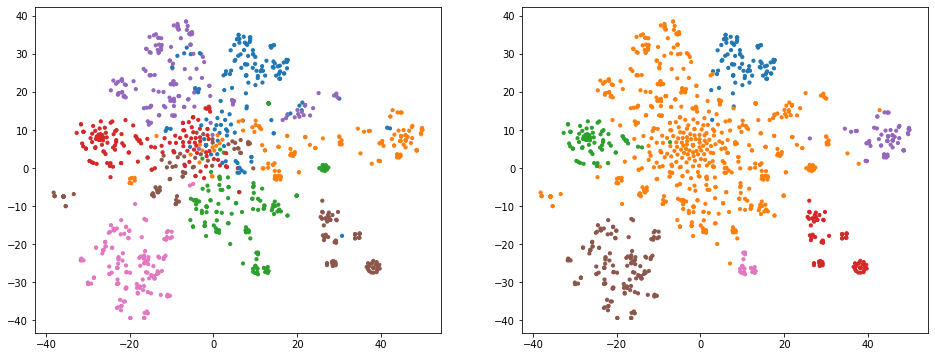

In [237]:
fig, ax = plt.subplots(1,2, figsize=(16,6))
ax[0].scatter(X_proj[:,0], X_proj[:,1], c=y, 
            cmap=ListedColormap(sns.color_palette('tab10'), N=len(set(y))), s=10)
ax[1].scatter(X_proj[:,0], X_proj[:,1], c=X_labels[label], 
            cmap=ListedColormap(sns.color_palette('tab10'), N=len(set(X_labels[label]))), s=10)
plt.show()

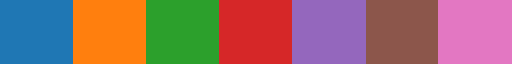

In [238]:
ListedColormap(sns.color_palette('tab10'), N=7)

In [239]:
label_dict_1 = {0:0, 1:4, 2:3, 3:5, 4:1, 5:6, 6:2}
#label_dict_1

#### Rapport de Classification

In [240]:
cluster_labels = pd.Series(X_labels[label]).map(label_dict_1)
print(classification_report(le.inverse_transform(y), le.inverse_transform(cluster_labels)))

                            precision    recall  f1-score   support

                 Baby Care       1.00      0.54      0.70       150
  Beauty and Personal Care       0.97      0.45      0.62       150
                 Computers       1.00      0.15      0.26       150
Home Decor & Festive Needs       1.00      0.49      0.66       150
           Home Furnishing       0.26      1.00      0.41       150
          Kitchen & Dining       0.99      0.49      0.66       150
                   Watches       1.00      0.98      0.99       150

                  accuracy                           0.59      1050
                 macro avg       0.89      0.59      0.61      1050
              weighted avg       0.89      0.59      0.61      1050



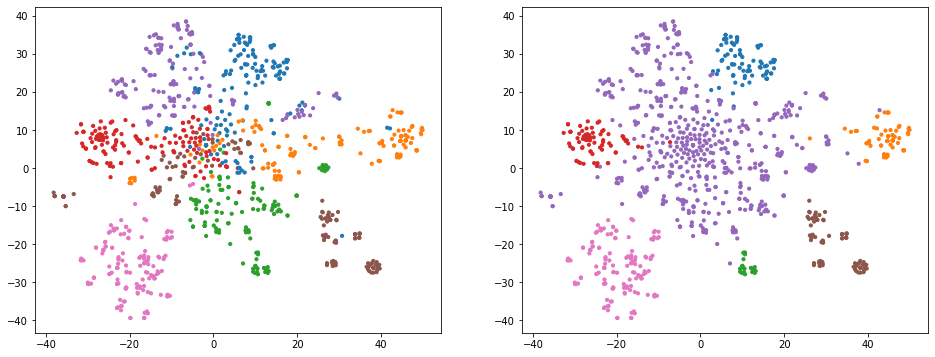

In [241]:
fig, ax = plt.subplots(1,2, figsize=(16,6))
ax[0].scatter(X_proj[:,0], X_proj[:,1], c=y, 
            cmap=ListedColormap(sns.color_palette('tab10'), N=len(set(y))), s=10)
ax[1].scatter(X_proj[:,0], X_proj[:,1], c=cluster_labels, 
            cmap=ListedColormap(sns.color_palette('tab10'), N=len(set(cluster_labels))), s=10)
plt.show()

#### Confusion Matrix

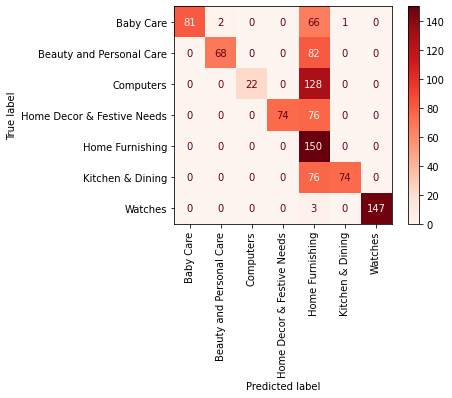

In [242]:
fig, ax = plt.subplots()
confmatrix = metrics.ConfusionMatrixDisplay.from_predictions(y, cluster_labels,
                                                             display_labels=[le.inverse_transform([i])[0] for i in range(7)],
                                                             xticks_rotation='vertical', cmap='Reds', ax=ax)

#### WordCloud

In [496]:
# Instantiate a new wordcloud.
stopwords = [key for key in set(' '.join(X[tok_ver]).split()) if key not in vocabulary_sets[data_ver+'_red'].keys()]
wordcloud = WordCloud(random_state = 8,
            normalize_plurals = False,
            width = 1000, height= 600,
            stopwords = stopwords)

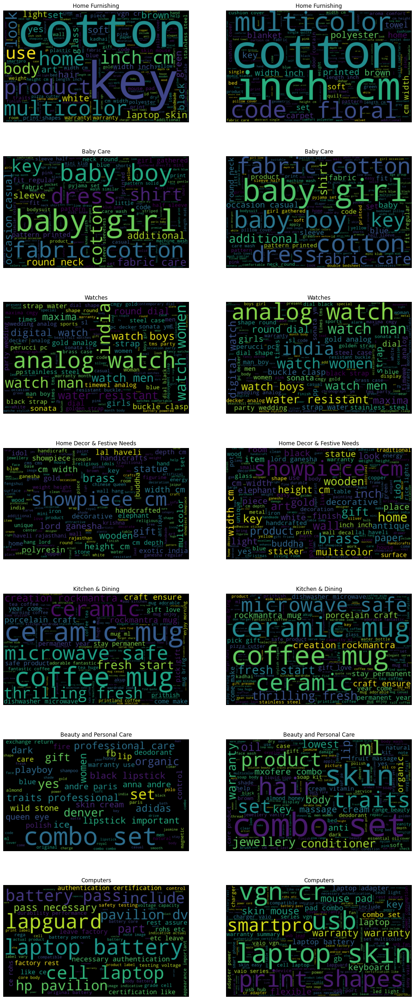

In [497]:
fig, axes = plt.subplots(7,2, figsize = (16,40))
y_cat_cl = pd.Series(le.inverse_transform(cluster_labels))
y_cat = pd.Series(le.inverse_transform(y))

categories = y_cat.unique()
for ii, cl in enumerate(categories):
    # Apply the wordcloud to the text.
    for jj, yy in enumerate([y_cat_cl, y_cat]):
        select = (yy == cl)
        wordcloud.generate(' '.join(X['spacy'][select]))
        # add interpolation = bilinear to smooth things out
        ax = axes[ii][jj]
        ax.imshow(wordcloud, interpolation='bilinear')
        ax.set_title(cl)
        # and remove the axis
        ax.axis("off")
plt.show()

## 6.2 GaussianMixture - Version2

### 6.2.1 Clustering

In [243]:
modelname = "GaussMixture"
nltk_scores=[]
spacy_scores=[]

for i in range(10):
    for tok_ver in tokenizer_versions:
        data_ver = '_'.join([tok_ver, preprocessor_ver])
        label = data_ver + '_' + modelname
        gm = GaussianMixture(n_components=7, n_init=20)
        X_labels[label] = gm.fit_predict(X_datas[data_ver])
        if tok_ver == 'nltk' :
            nltk_scores.append(metrics.adjusted_rand_score(y, X_labels[label]))
        elif tok_ver == 'spacy' :
            spacy_scores.append(metrics.adjusted_rand_score(y, X_labels[label]))

print(f"The rand score for the nltk data is {round(np.array(nltk_scores).mean(),3)} " +
      f"+/- {round(np.array(nltk_scores).std(),3)}.")
print(f"The rand score for the spacy data is {round(np.array(spacy_scores).mean(),3)} " +
      f"+/- {round(np.array(spacy_scores).std(),3)}.")

The rand score for the nltk data is 0.343 +/- 0.049.
The rand score for the spacy data is 0.326 +/- 0.048.


In [244]:
for tok_ver in tokenizer_versions:
        data_ver = '_'.join([tok_ver, preprocessor_ver])
        label = data_ver + '_' + modelname
        gm = GaussianMixture(n_components=7, n_init=20, random_state=33)
        X_labels[label] = gm.fit_predict(X_datas[data_ver])
        print(f"The rand score for the {data_ver} data is {metrics.adjusted_rand_score(y, X_labels[label])}.")

The rand score for the nltk_Version2 data is 0.3456219717108138.
The rand score for the spacy_Version2 data is 0.4066719522531213.


### 6.2.2 Rapport Détaillé du Clustering 'GaussianMixture' avec NLTK

In [245]:
tok_ver='nltk'
data_ver = tok_ver + '_Version2'
proj = 'TSNE0'
X_proj = X_projections[data_ver][proj]["X_proj"]

modelname = "GaussMixture"
label = data_ver + '_' + modelname

#### Comparison des Labels

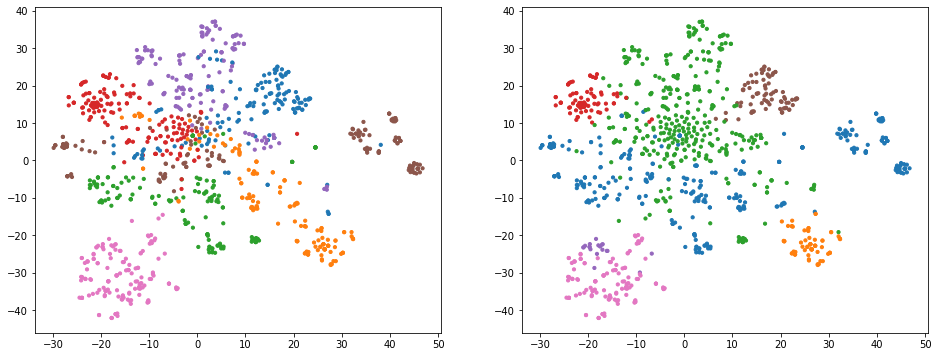

In [246]:
fig, ax = plt.subplots(1,2, figsize=(16,6))
ax[0].scatter(X_proj[:,0], X_proj[:,1], c=y, 
            cmap=ListedColormap(sns.color_palette('tab10'), N=len(set(y))), s=10)
ax[1].scatter(X_proj[:,0], X_proj[:,1], c=X_labels[label], 
            cmap=ListedColormap(sns.color_palette('tab10'), N=len(set(X_labels[label]))), s=10)
plt.show()

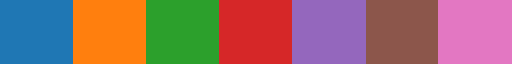

In [247]:
ListedColormap(sns.color_palette('tab10'), N=7)

In [248]:
label_dict_1 = {0:5, 1:1, 2:4, 3:3, 4:2, 5:0, 6:6}
#label_dict_1

In [249]:
{i:le.inverse_transform([i])[0] for i in range(7)}

{0: 'Baby Care',
 1: 'Beauty and Personal Care',
 2: 'Computers',
 3: 'Home Decor & Festive Needs',
 4: 'Home Furnishing',
 5: 'Kitchen & Dining',
 6: 'Watches'}

#### Rapport de Classification

In [250]:
cluster_labels = pd.Series(X_labels[label]).map(label_dict_1)
print(classification_report(le.inverse_transform(y), le.inverse_transform(cluster_labels)))

                            precision    recall  f1-score   support

                 Baby Care       1.00      0.53      0.70       150
  Beauty and Personal Care       0.97      0.45      0.62       150
                 Computers       0.00      0.00      0.00       150
Home Decor & Festive Needs       1.00      0.49      0.66       150
           Home Furnishing       0.40      1.00      0.58       150
          Kitchen & Dining       0.39      0.80      0.52       150
                   Watches       1.00      0.85      0.92       150

                  accuracy                           0.59      1050
                 macro avg       0.68      0.59      0.57      1050
              weighted avg       0.68      0.59      0.57      1050



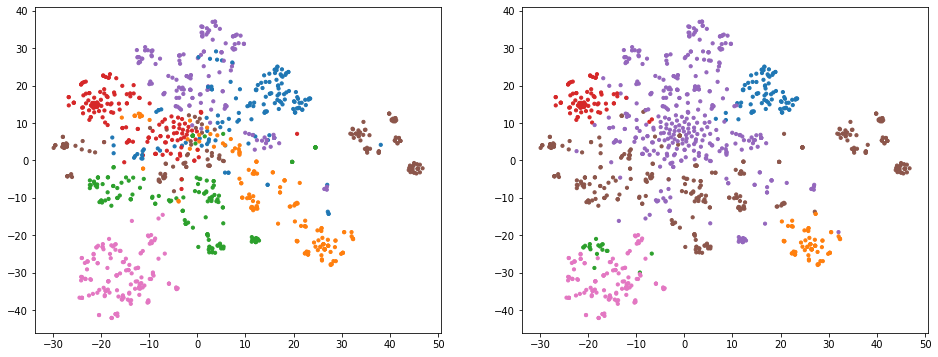

In [251]:
fig, ax = plt.subplots(1,2, figsize=(16,6))
ax[0].scatter(X_proj[:,0], X_proj[:,1], c=y, 
            cmap=ListedColormap(sns.color_palette('tab10'), N=len(set(y))), s=10)
ax[1].scatter(X_proj[:,0], X_proj[:,1], c=cluster_labels, 
            cmap=ListedColormap(sns.color_palette('tab10'), N=len(set(cluster_labels))), s=10)
plt.show()

#### Confusion Matrix

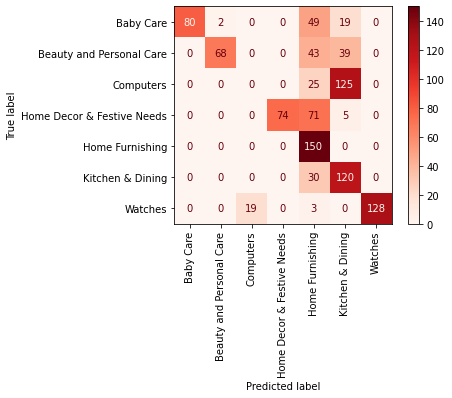

In [253]:
fig, ax = plt.subplots()
confmatrix = metrics.ConfusionMatrixDisplay.from_predictions(y, cluster_labels,
                                                             display_labels=[le.inverse_transform([i])[0] for i in range(7)],
                                                             xticks_rotation='vertical', cmap='Reds', ax=ax)

#### WordCloud

In [506]:
# Instantiate a new wordcloud.
stopwords = [key for key in set(' '.join(X[tok_ver]).split()) if key not in vocabulary_sets[data_ver+'_red'].keys()]
wordcloud = WordCloud(random_state = 8,
            normalize_plurals = False,
            width = 1000, height= 600,
            stopwords = stopwords)

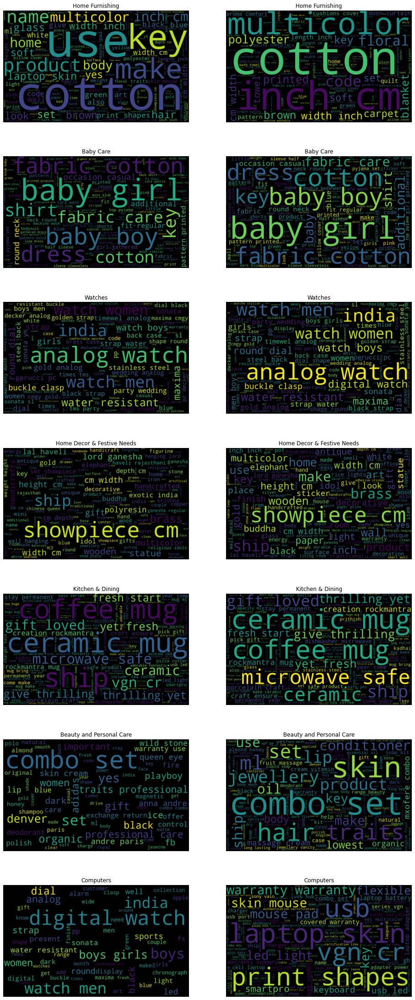

In [507]:
fig, axes = plt.subplots(7,2, figsize = (16,40))
y_cat_cl = pd.Series(le.inverse_transform(cluster_labels))
y_cat = pd.Series(le.inverse_transform(y))

categories = y_cat.unique()
for ii, cl in enumerate(categories):
    # Apply the wordcloud to the text.
    for jj, yy in enumerate([y_cat_cl, y_cat]):
        select = (yy == cl)
        wordcloud.generate(' '.join(X['nltk'][select]))
        # add interpolation = bilinear to smooth things out
        ax = axes[ii][jj]
        ax.imshow(wordcloud, interpolation='bilinear')
        ax.set_title(cl)
        # and remove the axis
        ax.axis("off")
plt.show()

### 6.2.3 Rapport Détaillé du Clustering 'GaussianMixture' avec SpaCy

In [254]:
tok_ver='spacy'
data_ver = tok_ver + '_Version2'
proj = 'TSNE0'
X_proj = X_projections[data_ver][proj]["X_proj"]

modelname = "GaussMixture"
label = data_ver + '_' + modelname

#### Comparison des Labels

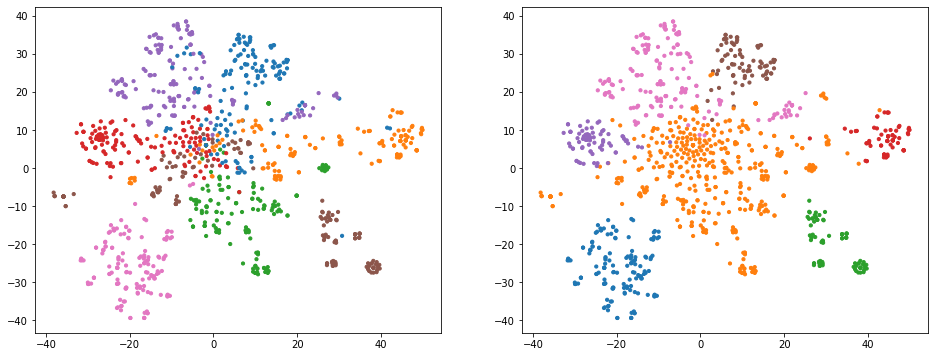

In [255]:
fig, ax = plt.subplots(1,2, figsize=(16,6))
ax[0].scatter(X_proj[:,0], X_proj[:,1], c=y, 
            cmap=ListedColormap(sns.color_palette('tab10'), N=len(set(y))), s=10)
ax[1].scatter(X_proj[:,0], X_proj[:,1], c=X_labels[label], 
            cmap=ListedColormap(sns.color_palette('tab10'), N=len(set(X_labels[label]))), s=10)
plt.show()

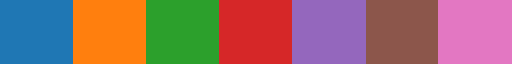

In [256]:
ListedColormap(sns.color_palette('tab10'), N=7)

In [257]:
label_dict_1 = {0:6, 1:2, 2:5, 3:1, 4:3, 5:0, 6:4}
#label_dict_1

In [258]:
{i:le.inverse_transform([i])[0] for i in range(7)}

{0: 'Baby Care',
 1: 'Beauty and Personal Care',
 2: 'Computers',
 3: 'Home Decor & Festive Needs',
 4: 'Home Furnishing',
 5: 'Kitchen & Dining',
 6: 'Watches'}

#### Rapport de Classification

In [259]:
cluster_labels = pd.Series(X_labels[label]).map(label_dict_1)
print(classification_report(le.inverse_transform(y), le.inverse_transform(cluster_labels)))

                            precision    recall  f1-score   support

                 Baby Care       1.00      0.55      0.71       150
  Beauty and Personal Care       0.97      0.45      0.62       150
                 Computers       0.35      1.00      0.51       150
Home Decor & Festive Needs       1.00      0.49      0.66       150
           Home Furnishing       0.86      0.96      0.91       150
          Kitchen & Dining       0.99      0.49      0.66       150
                   Watches       1.00      0.98      0.99       150

                  accuracy                           0.70      1050
                 macro avg       0.88      0.70      0.72      1050
              weighted avg       0.88      0.70      0.72      1050



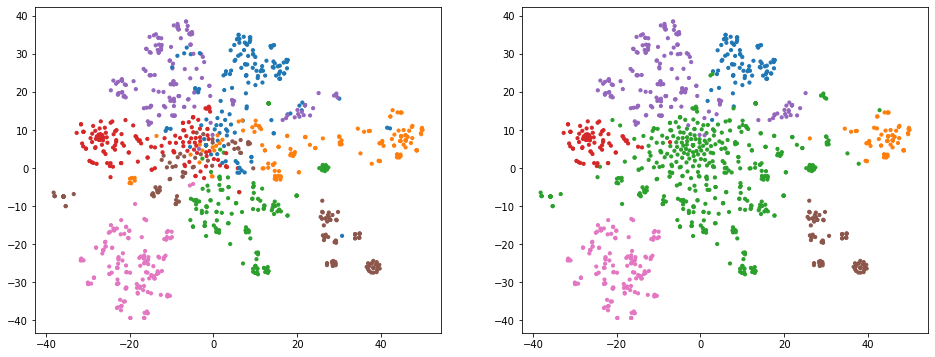

In [260]:
fig, ax = plt.subplots(1,2, figsize=(16,6))
ax[0].scatter(X_proj[:,0], X_proj[:,1], c=y, 
            cmap=ListedColormap(sns.color_palette('tab10'), N=len(set(y))), s=10)
ax[1].scatter(X_proj[:,0], X_proj[:,1], c=cluster_labels, 
            cmap=ListedColormap(sns.color_palette('tab10'), N=len(set(cluster_labels))), s=10)
plt.show()

#### Confusion Matrix

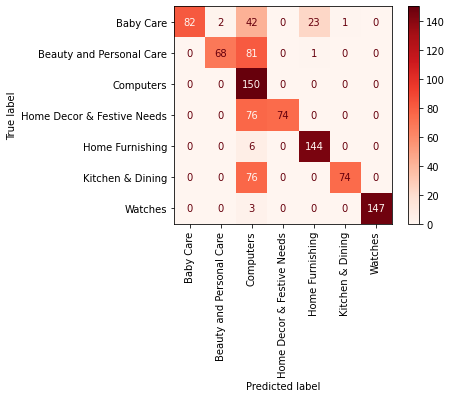

In [261]:
fig, ax = plt.subplots()
confmatrix = metrics.ConfusionMatrixDisplay.from_predictions(y, cluster_labels,
                                                             display_labels=[le.inverse_transform([i])[0] for i in range(7)],
                                                             xticks_rotation='vertical', cmap='Reds', ax=ax)

#### WordCloud

In [514]:
# Instantiate a new wordcloud.
stopwords = [key for key in set(' '.join(X[tok_ver]).split()) if key not in vocabulary_sets[data_ver+'_red'].keys()]
wordcloud = WordCloud(random_state = 8,
            normalize_plurals = False,
            width = 1000, height= 600,
            stopwords = stopwords)

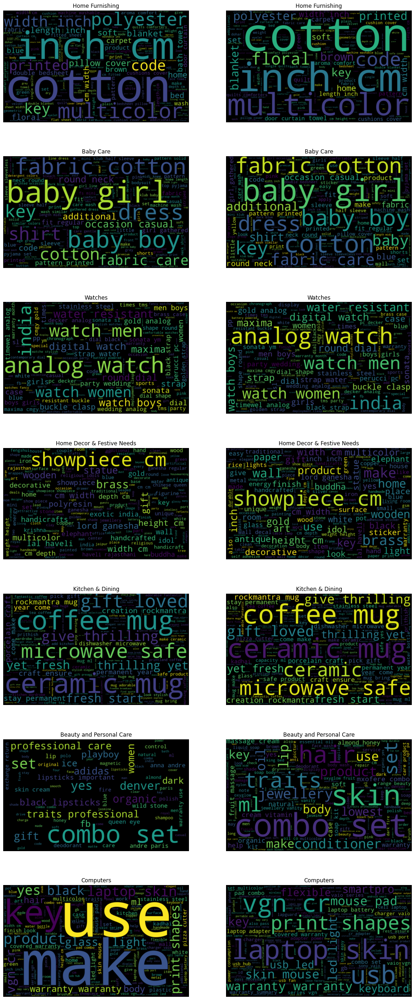

In [515]:
fig, axes = plt.subplots(7,2, figsize = (16,40))
y_cat_cl = pd.Series(le.inverse_transform(cluster_labels))
y_cat = pd.Series(le.inverse_transform(y))

categories = y_cat.unique()
for ii, cl in enumerate(categories):
    # Apply the wordcloud to the text.
    for jj, yy in enumerate([y_cat_cl, y_cat]):
        select = (yy == cl)
        wordcloud.generate(' '.join(X['nltk'][select]))
        # add interpolation = bilinear to smooth things out
        ax = axes[ii][jj]
        ax.imshow(wordcloud, interpolation='bilinear')
        ax.set_title(cl)
        # and remove the axis
        ax.axis("off")
plt.show()

## 6.3 AgglomerativeClustering - Version2

### 6.3.1 Clustering

In [262]:
modelname = "AggClust"
for tok_ver in tokenizer_versions:
    data_ver = '_'.join([tok_ver, preprocessor_ver])
    label = data_ver + '_' + modelname
    ac = AgglomerativeClustering(n_clusters=7)
    X_labels[label] = ac.fit_predict(X_datas[data_ver])
    print(f"The rand score for the {tok_ver} data is {metrics.adjusted_rand_score(y, X_labels[label])}")

The rand score for the nltk data is 0.2401945635355993
The rand score for the spacy data is 0.2550461740532766


### 6.3.2 Rapport Détaillé du Clustering 'AgglomerativeClustering' avec NLTK

In [263]:
tok_ver='nltk'
data_ver = tok_ver + '_Version2'
proj = 'TSNE0'
X_proj = X_projections[data_ver][proj]["X_proj"]

modelname = "AggClust"
label = data_ver + '_' + modelname

#### Comparison des Labels

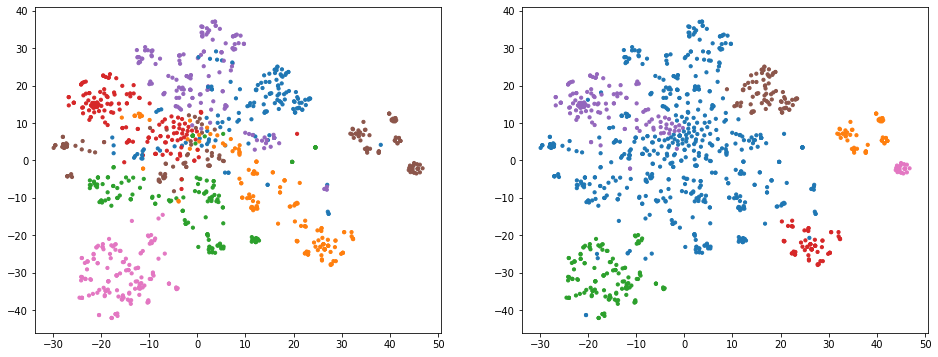

In [264]:
fig, ax = plt.subplots(1,2, figsize=(16,6))
ax[0].scatter(X_proj[:,0], X_proj[:,1], c=y, 
            cmap=ListedColormap(sns.color_palette('tab10'), N=len(set(y))), s=10)
ax[1].scatter(X_proj[:,0], X_proj[:,1], c=X_labels[label], 
            cmap=ListedColormap(sns.color_palette('tab10'), N=len(set(X_labels[label]))), s=10)
plt.show()

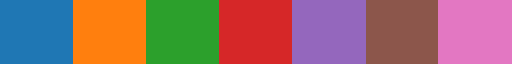

In [265]:
ListedColormap(sns.color_palette('tab10'), N=7)

In [266]:
label_dict_1 = {0:2, 1:5, 2:6, 3:1, 4:3, 5:0, 6:4}
#label_dict_1

In [267]:
{i:le.inverse_transform([i])[0] for i in range(7)}

{0: 'Baby Care',
 1: 'Beauty and Personal Care',
 2: 'Computers',
 3: 'Home Decor & Festive Needs',
 4: 'Home Furnishing',
 5: 'Kitchen & Dining',
 6: 'Watches'}

#### Rapport de Classification

In [268]:
cluster_labels = pd.Series(X_labels[label]).map(label_dict_1)
print(classification_report(le.inverse_transform(y), le.inverse_transform(cluster_labels)))

                            precision    recall  f1-score   support

                 Baby Care       1.00      0.53      0.69       150
  Beauty and Personal Care       1.00      0.45      0.62       150
                 Computers       0.26      1.00      0.42       150
Home Decor & Festive Needs       0.84      0.67      0.74       150
           Home Furnishing       0.00      0.00      0.00       150
          Kitchen & Dining       0.98      0.35      0.52       150
                   Watches       1.00      0.92      0.96       150

                  accuracy                           0.56      1050
                 macro avg       0.73      0.56      0.56      1050
              weighted avg       0.73      0.56      0.56      1050



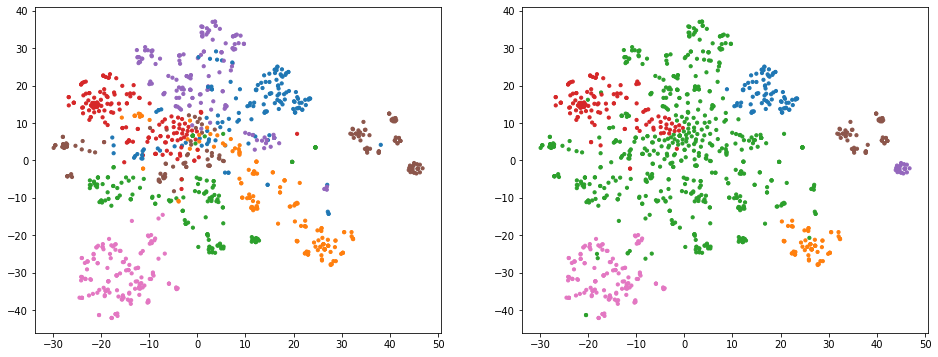

In [269]:
fig, ax = plt.subplots(1,2, figsize=(16,6))
ax[0].scatter(X_proj[:,0], X_proj[:,1], c=y, 
            cmap=ListedColormap(sns.color_palette('tab10'), N=len(set(y))), s=10)
ax[1].scatter(X_proj[:,0], X_proj[:,1], c=cluster_labels, 
            cmap=ListedColormap(sns.color_palette('tab10'), N=len(set(cluster_labels))), s=10)
plt.show()

#### Confusion Matrix

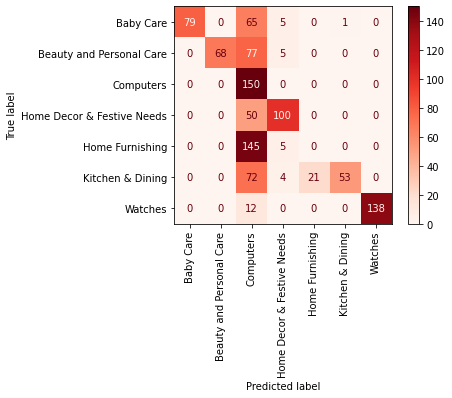

In [270]:
fig, ax = plt.subplots()
confmatrix = metrics.ConfusionMatrixDisplay.from_predictions(y, cluster_labels,
                                                             display_labels=[le.inverse_transform([i])[0] for i in range(7)],
                                                             xticks_rotation='vertical', cmap='Reds', ax=ax)

#### WordCloud

In [271]:
# Instantiate a new wordcloud.
stopwords = [key for key in set(' '.join(X[tok_ver]).split()) if key not in vocabulary_sets[data_ver+'_red'].keys()]
wordcloud = WordCloud(random_state = 8,
            normalize_plurals = False,
            width = 1000, height= 600,
            stopwords = stopwords)

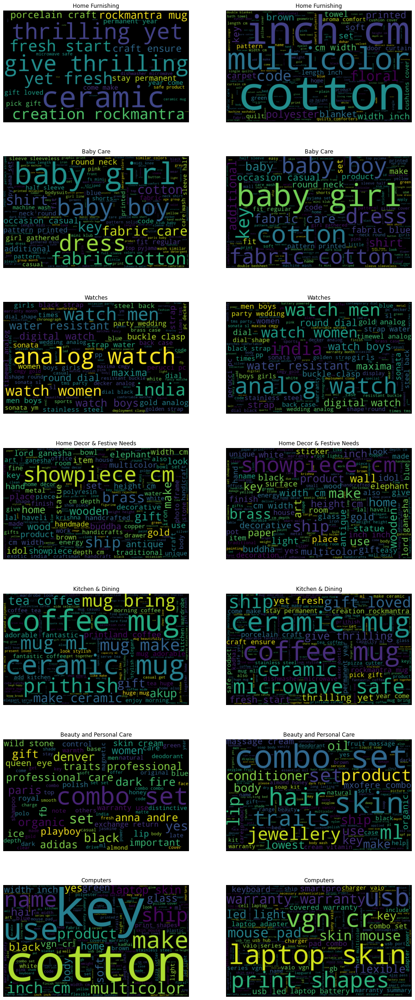

In [272]:
fig, axes = plt.subplots(7,2, figsize = (16,40))
y_cat_cl = pd.Series(le.inverse_transform(cluster_labels))
y_cat = pd.Series(le.inverse_transform(y))

categories = y_cat.unique()
for ii, cl in enumerate(categories):
    # Apply the wordcloud to the text.
    for jj, yy in enumerate([y_cat_cl, y_cat]):
        select = (yy == cl)
        wordcloud.generate(' '.join(X['nltk'][select]))
        # add interpolation = bilinear to smooth things out
        ax = axes[ii][jj]
        ax.imshow(wordcloud, interpolation='bilinear')
        ax.set_title(cl)
        # and remove the axis
        ax.axis("off")
plt.show()

### 6.3.3 Rapport Détaillé du Clustering 'AgglomerativeClustering' avec SpaCy

In [273]:
tok_ver='spacy'
data_ver = tok_ver + '_Version2'
proj = 'TSNE0'
X_proj = X_projections[data_ver][proj]["X_proj"]

modelname = "AggClust"
label = data_ver + '_' + modelname

#### Comparison des Labels

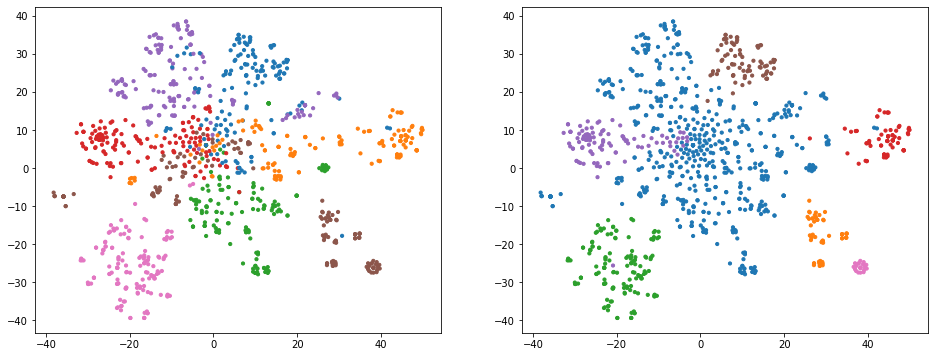

In [274]:
fig, ax = plt.subplots(1,2, figsize=(16,6))
ax[0].scatter(X_proj[:,0], X_proj[:,1], c=y, 
            cmap=ListedColormap(sns.color_palette('tab10'), N=len(set(y))), s=10)
ax[1].scatter(X_proj[:,0], X_proj[:,1], c=X_labels[label], 
            cmap=ListedColormap(sns.color_palette('tab10'), N=len(set(X_labels[label]))), s=10)
plt.show()

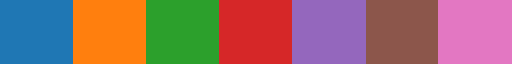

In [275]:
ListedColormap(sns.color_palette('tab10'), N=7)

In [276]:
label_dict_1 = {0:4, 1:5, 2:6, 3:1, 4:3, 5:0, 6:2}
#label_dict_1

In [277]:
{i:le.inverse_transform([i])[0] for i in range(7)}

{0: 'Baby Care',
 1: 'Beauty and Personal Care',
 2: 'Computers',
 3: 'Home Decor & Festive Needs',
 4: 'Home Furnishing',
 5: 'Kitchen & Dining',
 6: 'Watches'}

#### Rapport de Classification

In [278]:
cluster_labels = pd.Series(X_labels[label]).map(label_dict_1)
print(classification_report(le.inverse_transform(y), le.inverse_transform(cluster_labels)))

                            precision    recall  f1-score   support

                 Baby Care       1.00      0.53      0.70       150
  Beauty and Personal Care       1.00      0.47      0.64       150
                 Computers       0.00      0.00      0.00       150
Home Decor & Festive Needs       0.96      0.64      0.77       150
           Home Furnishing       0.26      1.00      0.41       150
          Kitchen & Dining       0.98      0.35      0.52       150
                   Watches       1.00      0.97      0.99       150

                  accuracy                           0.57      1050
                 macro avg       0.74      0.57      0.57      1050
              weighted avg       0.74      0.57      0.57      1050



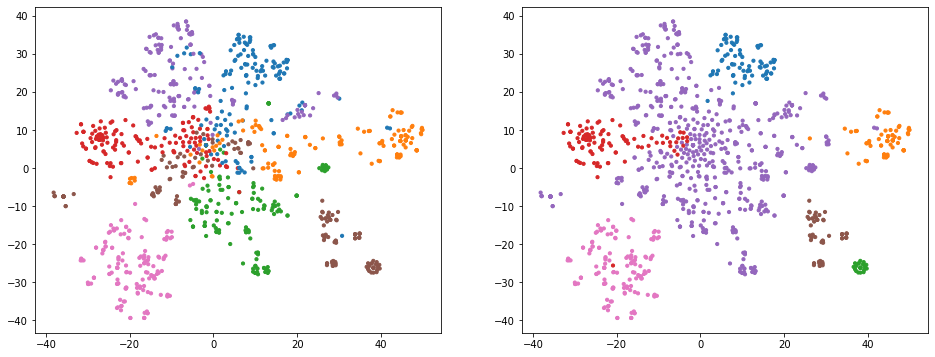

In [279]:
fig, ax = plt.subplots(1,2, figsize=(16,6))
ax[0].scatter(X_proj[:,0], X_proj[:,1], c=y, 
            cmap=ListedColormap(sns.color_palette('tab10'), N=len(set(y))), s=10)
ax[1].scatter(X_proj[:,0], X_proj[:,1], c=cluster_labels, 
            cmap=ListedColormap(sns.color_palette('tab10'), N=len(set(cluster_labels))), s=10)
plt.show()

#### Confusion Matrix

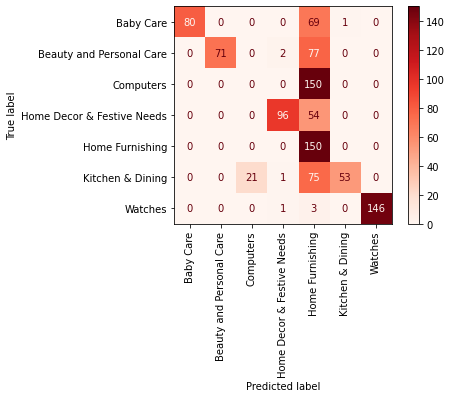

In [280]:
fig, ax = plt.subplots()
confmatrix = metrics.ConfusionMatrixDisplay.from_predictions(y, cluster_labels,
                                                             display_labels=[le.inverse_transform([i])[0] for i in range(7)],
                                                             xticks_rotation='vertical', cmap='Reds', ax=ax)

#### WordCloud

In [536]:
# Instantiate a new wordcloud.
stopwords = [key for key in set(' '.join(X[tok_ver]).split()) if key not in vocabulary_sets[data_ver+'_red'].keys()]
wordcloud = WordCloud(random_state = 8,
            normalize_plurals = False,
            width = 1000, height= 600,
            stopwords = stopwords)

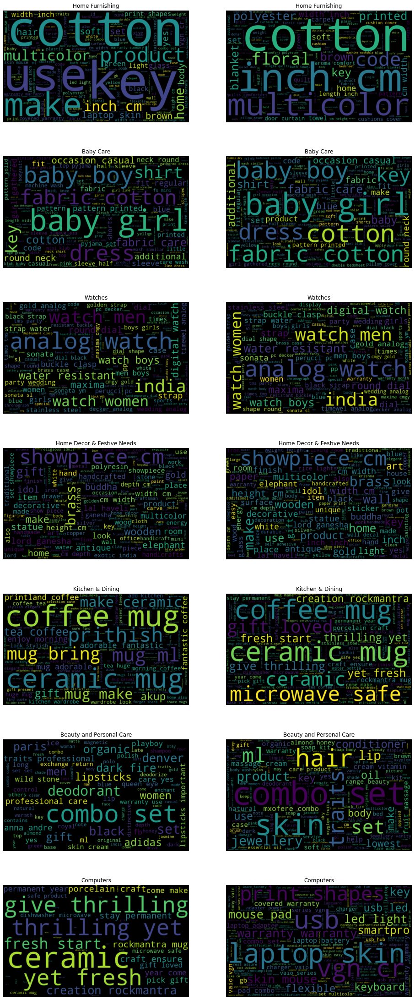

In [537]:
fig, axes = plt.subplots(7,2, figsize = (16,40))
y_cat_cl = pd.Series(le.inverse_transform(cluster_labels))
y_cat = pd.Series(le.inverse_transform(y))

categories = y_cat.unique()
for ii, cl in enumerate(categories):
    # Apply the wordcloud to the text.
    for jj, yy in enumerate([y_cat_cl, y_cat]):
        select = (yy == cl)
        wordcloud.generate(' '.join(X['nltk'][select]))
        # add interpolation = bilinear to smooth things out
        ax = axes[ii][jj]
        ax.imshow(wordcloud, interpolation='bilinear')
        ax.set_title(cl)
        # and remove the axis
        ax.axis("off")
plt.show()

### 6.3.4 Clustering - 2

In [281]:
modelname = "AggClust2"
for tok_ver in tokenizer_versions:
    data_ver = '_'.join([tok_ver, preprocessor_ver])
    label = data_ver + '_' + modelname
    ac = AgglomerativeClustering(n_clusters=8)
    X_labels[label] = ac.fit_predict(X_datas[data_ver])
    print(f"The rand score for the {tok_ver} data is {metrics.adjusted_rand_score(y, X_labels[label])}")

The rand score for the nltk data is 0.23958365234711812
The rand score for the spacy data is 0.2554182267894935


### 6.3.5 Rapport Détaillé du Clustering 'AgglomerativeClustering' avec NLTK -2

In [283]:
tok_ver='nltk'
data_ver = tok_ver + '_Version2'
proj = 'TSNE2'
X_proj = X_projections[data_ver][proj]["X_proj"]

modelname = "AggClust2"
label = data_ver + '_' + modelname

#### Comparison des Labels

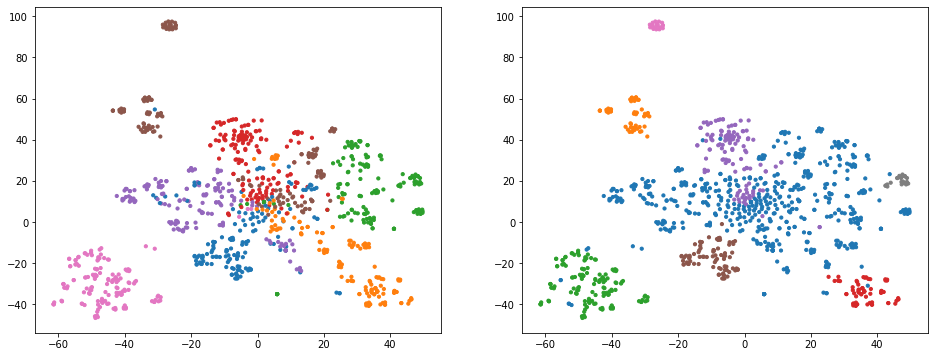

In [284]:
fig, ax = plt.subplots(1,2, figsize=(16,6))
ax[0].scatter(X_proj[:,0], X_proj[:,1], c=y, 
            cmap=ListedColormap(sns.color_palette('tab10'), N=len(set(y))), s=10)
ax[1].scatter(X_proj[:,0], X_proj[:,1], c=X_labels[label], 
            cmap=ListedColormap(sns.color_palette('tab10'), N=len(set(X_labels[label]))), s=10)
plt.show()

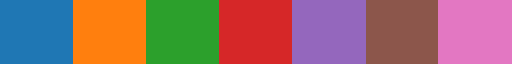

In [149]:
ListedColormap(sns.color_palette('tab10'), N=7)

In [285]:
label_dict_1 = {0:4, 1:5, 2:6, 3:1, 4:3, 5:0, 6:5, 7:2}
#label_dict_1

In [286]:
{i:le.inverse_transform([i])[0] for i in range(7)}

{0: 'Baby Care',
 1: 'Beauty and Personal Care',
 2: 'Computers',
 3: 'Home Decor & Festive Needs',
 4: 'Home Furnishing',
 5: 'Kitchen & Dining',
 6: 'Watches'}

#### Rapport de Classification

In [287]:
cluster_labels = pd.Series(X_labels[label]).map(label_dict_1)
print(classification_report(le.inverse_transform(y), le.inverse_transform(cluster_labels)))

                            precision    recall  f1-score   support

                 Baby Care       1.00      0.53      0.69       150
  Beauty and Personal Care       1.00      0.45      0.62       150
                 Computers       1.00      0.15      0.26       150
Home Decor & Festive Needs       0.84      0.67      0.74       150
           Home Furnishing       0.26      0.97      0.41       150
          Kitchen & Dining       0.99      0.49      0.66       150
                   Watches       1.00      0.92      0.96       150

                  accuracy                           0.60      1050
                 macro avg       0.87      0.60      0.62      1050
              weighted avg       0.87      0.60      0.62      1050



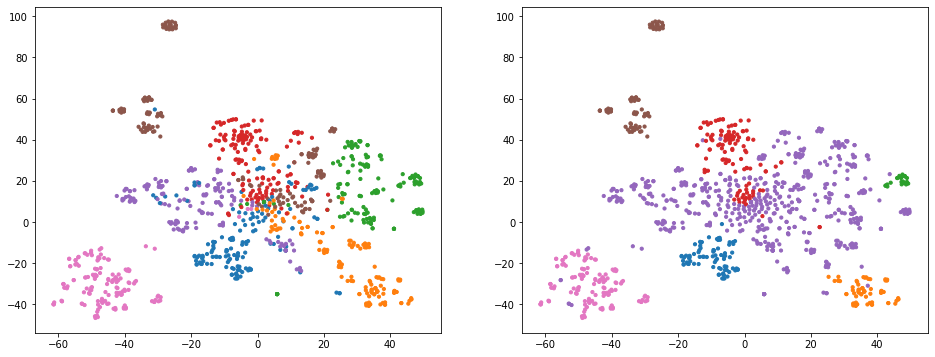

In [288]:
fig, ax = plt.subplots(1,2, figsize=(16,6))
ax[0].scatter(X_proj[:,0], X_proj[:,1], c=y, 
            cmap=ListedColormap(sns.color_palette('tab10'), N=len(set(y))), s=10)
ax[1].scatter(X_proj[:,0], X_proj[:,1], c=cluster_labels, 
            cmap=ListedColormap(sns.color_palette('tab10'), N=len(set(cluster_labels))), s=10)
plt.show()

#### Confusion Matrix

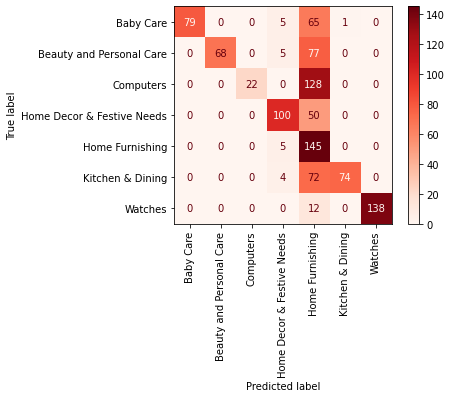

In [289]:
fig, ax = plt.subplots()
confmatrix = metrics.ConfusionMatrixDisplay.from_predictions(y, cluster_labels,
                                                             display_labels=[le.inverse_transform([i])[0] for i in range(7)],
                                                             xticks_rotation='vertical', cmap='Reds', ax=ax)

#### WordCloud

In [170]:
# Instantiate a new wordcloud.
stopwords = [key for key in set(' '.join(X[tok_ver]).split()) if key not in vocabulary_sets[data_ver+'_red'].keys()]
wordcloud = WordCloud(random_state = 8,
            normalize_plurals = False,
            width = 1000, height= 600,
            stopwords = stopwords)

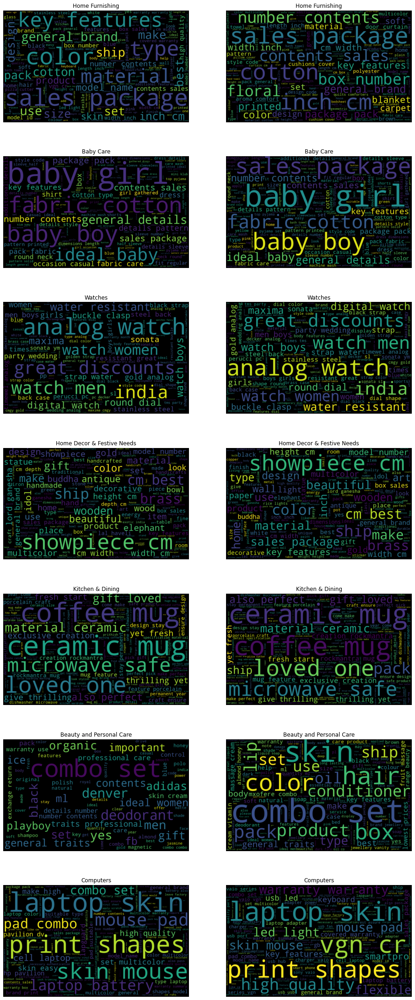

In [171]:
fig, axes = plt.subplots(7,2, figsize = (16,40))
y_cat_cl = pd.Series(le.inverse_transform(cluster_labels))
y_cat = pd.Series(le.inverse_transform(y))

categories = y_cat.unique()
for ii, cl in enumerate(categories):
    # Apply the wordcloud to the text.
    for jj, yy in enumerate([y_cat_cl, y_cat]):
        select = (yy == cl)
        wordcloud.generate(' '.join(X['nltk'][select]))
        # add interpolation = bilinear to smooth things out
        ax = axes[ii][jj]
        ax.imshow(wordcloud, interpolation='bilinear')
        ax.set_title(cl)
        # and remove the axis
        ax.axis("off")
plt.show()

### 6.3.6 Rapport Détaillé du Clustering 'AgglomerativeClustering' avec SpaCy -2

In [291]:
tok_ver='spacy'
data_ver = tok_ver + '_Version2'
proj = 'TSNE0'
X_proj = X_projections[data_ver][proj]["X_proj"]

modelname = "AggClust2"
label = data_ver + '_' + modelname

#### Comparison des Labels

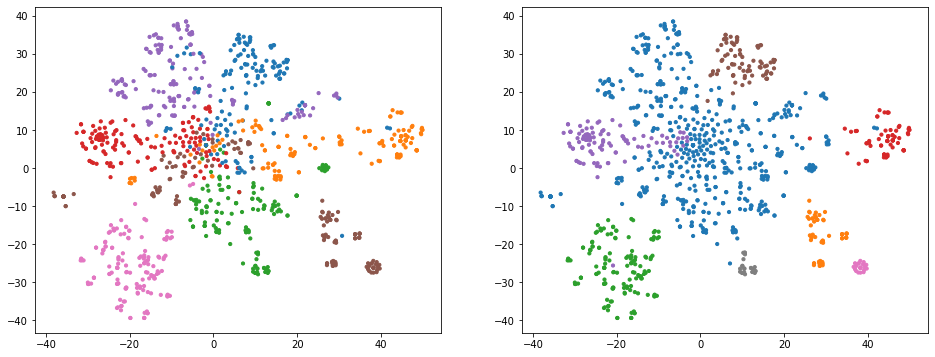

In [292]:
fig, ax = plt.subplots(1,2, figsize=(16,6))
ax[0].scatter(X_proj[:,0], X_proj[:,1], c=y, 
            cmap=ListedColormap(sns.color_palette('tab10'), N=len(set(y))), s=10)
ax[1].scatter(X_proj[:,0], X_proj[:,1], c=X_labels[label], 
            cmap=ListedColormap(sns.color_palette('tab10'), N=len(set(X_labels[label]))), s=10)
plt.show()

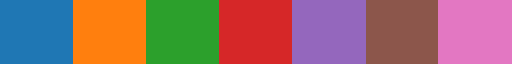

In [175]:
ListedColormap(sns.color_palette('tab10'), N=7)

In [293]:
label_dict_1 = {0:4, 1:5, 2:6, 3:1, 4:3, 5:0, 6:5, 7:2}
#label_dict_1

In [294]:
{i:le.inverse_transform([i])[0] for i in range(7)}

{0: 'Baby Care',
 1: 'Beauty and Personal Care',
 2: 'Computers',
 3: 'Home Decor & Festive Needs',
 4: 'Home Furnishing',
 5: 'Kitchen & Dining',
 6: 'Watches'}

#### Rapport de Classification

In [295]:
cluster_labels = pd.Series(X_labels[label]).map(label_dict_1)
print(classification_report(le.inverse_transform(y), le.inverse_transform(cluster_labels)))

                            precision    recall  f1-score   support

                 Baby Care       1.00      0.53      0.70       150
  Beauty and Personal Care       1.00      0.47      0.64       150
                 Computers       1.00      0.15      0.26       150
Home Decor & Festive Needs       0.96      0.64      0.77       150
           Home Furnishing       0.27      1.00      0.42       150
          Kitchen & Dining       0.99      0.49      0.66       150
                   Watches       1.00      0.97      0.99       150

                  accuracy                           0.61      1050
                 macro avg       0.89      0.61      0.63      1050
              weighted avg       0.89      0.61      0.63      1050



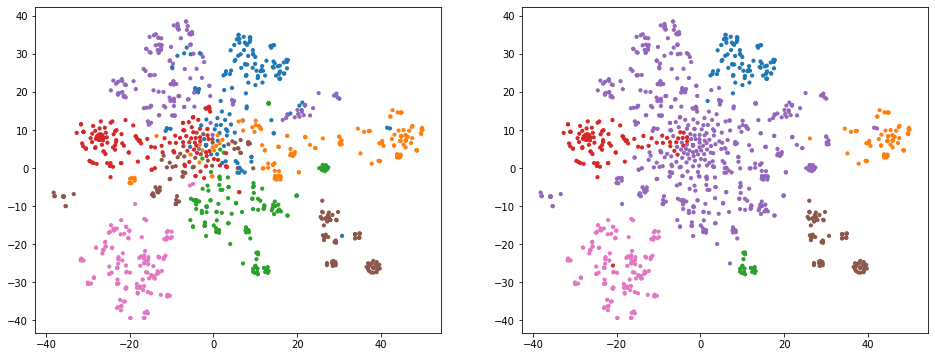

In [296]:
fig, ax = plt.subplots(1,2, figsize=(16,6))
ax[0].scatter(X_proj[:,0], X_proj[:,1], c=y, 
            cmap=ListedColormap(sns.color_palette('tab10'), N=len(set(y))), s=10)
ax[1].scatter(X_proj[:,0], X_proj[:,1], c=cluster_labels, 
            cmap=ListedColormap(sns.color_palette('tab10'), N=len(set(cluster_labels))), s=10)
plt.show()

#### Confusion Matrix

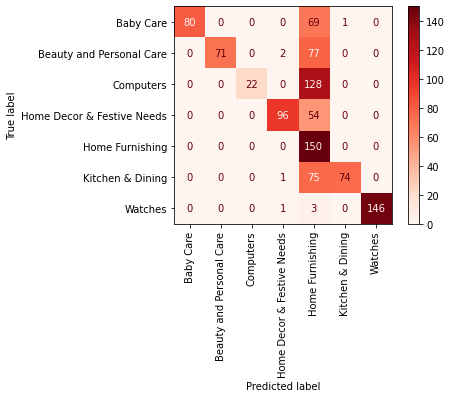

In [297]:
fig, ax = plt.subplots()
confmatrix = metrics.ConfusionMatrixDisplay.from_predictions(y, cluster_labels,
                                                             display_labels=[le.inverse_transform([i])[0] for i in range(7)],
                                                             xticks_rotation='vertical', cmap='Reds', ax=ax)

#### WordCloud

In [ ]:
# Instantiate a new wordcloud.
stopwords = [key for key in set(' '.join(X[tok_ver]).split()) if key not in vocabulary_sets[data_ver+'_red'].keys()]
wordcloud = WordCloud(random_state = 8,
            normalize_plurals = False,
            width = 1000, height= 600,
            stopwords = stopwords)

In [ ]:
fig, axes = plt.subplots(7,2, figsize = (16,40))
y_cat_cl = pd.Series(le.inverse_transform(cluster_labels))
y_cat = pd.Series(le.inverse_transform(y))

categories = y_cat.unique()
for ii, cl in enumerate(categories):
    # Apply the wordcloud to the text.
    for jj, yy in enumerate([y_cat_cl, y_cat]):
        select = (yy == cl)
        wordcloud.generate(' '.join(X['nltk'][select]))
        # add interpolation = bilinear to smooth things out
        ax = axes[ii][jj]
        ax.imshow(wordcloud, interpolation='bilinear')
        ax.set_title(cl)
        # and remove the axis
        ax.axis("off")
plt.show()

## 6.4 SpectralClustering - Version 2

### 6.4.1 Clustering

In [298]:
modelname = "SpecClust"
param_list=[]
score_list=[]
for gamma in np.linspace(1, 9, 10):
    for affinity in ['sigmoid', 'rbf']:
        for coef0 in np.linspace(0.5, 2.5, 11):
            param_list.append((affinity, gamma, coef0))
            #print(f"fitting.... affinity:{affinity} | gamma:{gamma} | coef0:{coef0}")
            for tok_ver in tokenizer_versions:
                data_ver = '_'.join([tok_ver, preprocessor_ver])
                label = data_ver + '_' + modelname
                sp = SpectralClustering(n_clusters = 7, gamma=gamma, affinity=affinity, coef0 = coef0,
                                        assign_labels='discretize', random_state=33)
                X_labels[label] = sp.fit_predict(X_datas[data_ver])
                score_list.append(metrics.adjusted_rand_score(y, X_labels[label]))
            if affinity == 'rbf' : break

In [299]:
avg_score_list = np.array([np.array(score_list[i:i+2]).mean() for i in range(0,len(score_list),2)])
print(f"The best average score was {avg_score_list.max()} with (gamma, coef0) = " +
      f"{param_list[list(avg_score_list).index(avg_score_list.max())]}.")

The best average score was 0.4613047350131333 with (gamma, coef0) = ('sigmoid', 1.0, 1.5).


In [402]:
modelname = "SpecClust"
gamma = 1.0
coef0 = 1.5
for tok_ver in tokenizer_versions:
    data_ver = '_'.join([tok_ver, preprocessor_ver])
    label = data_ver + '_' + modelname
    sp = SpectralClustering(n_clusters = 7, gamma=gamma, affinity='sigmoid', coef0 = coef0,
                            assign_labels='discretize', random_state=33)
    X_labels[label] = sp.fit_predict(X_datas[data_ver])
    print(f"The rand score for the {tok_ver} data is {metrics.adjusted_rand_score(y, X_labels[label])}")

The rand score for the nltk data is 0.4411910148669963
The rand score for the spacy data is 0.4814184551592703


### 6.4.2 Rapport Détaillé du Clustering 'SpectralClustering' avec NLTK

In [422]:
tok_ver='nltk'
data_ver = tok_ver + '_Version2'
proj = 'TSNE0'
X_proj = X_projections[data_ver][proj]["X_proj"]

modelname = "SpecClust"
label = data_ver + '_' + modelname

#### Comparison des Labels

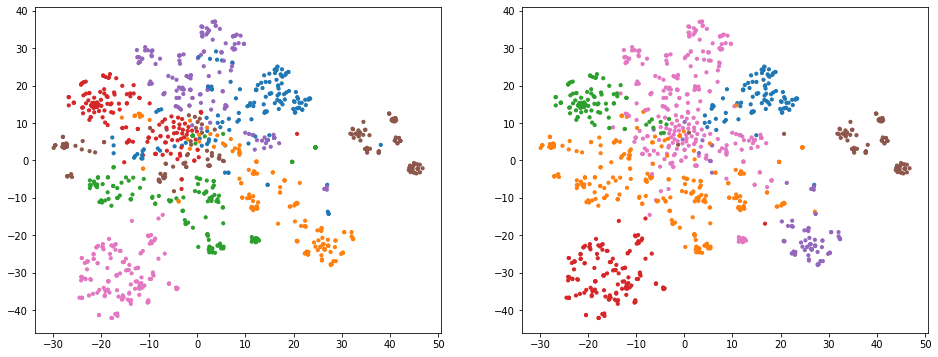

In [424]:
fig, ax = plt.subplots(1,2, figsize=(16,6))
ax[0].scatter(X_proj[:,0], X_proj[:,1], c=y, 
            cmap=ListedColormap(sns.color_palette('tab10'), N=len(set(y))), s=10)
ax[1].scatter(X_proj[:,0], X_proj[:,1], c=X_labels[label], 
            cmap=ListedColormap(sns.color_palette('tab10'), N=len(set(X_labels[label]))), s=10)
plt.show()

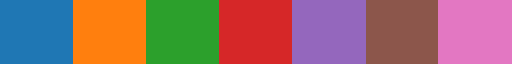

In [425]:
ListedColormap(sns.color_palette('tab10'), N=7)

In [426]:
label_dict_1 = {0:0, 1:2, 2:3, 3:6, 4:1, 5:5, 6:4}
#label_dict_1

In [427]:
{i:le.inverse_transform([i])[0] for i in range(7)}

{0: 'Baby Care',
 1: 'Beauty and Personal Care',
 2: 'Computers',
 3: 'Home Decor & Festive Needs',
 4: 'Home Furnishing',
 5: 'Kitchen & Dining',
 6: 'Watches'}

#### Rapport de Classification

In [428]:
cluster_labels = pd.Series(X_labels[label]).map(label_dict_1)
print(classification_report(le.inverse_transform(y), le.inverse_transform(cluster_labels)))

                            precision    recall  f1-score   support

                 Baby Care       0.95      0.60      0.73       150
  Beauty and Personal Care       0.82      0.47      0.60       150
                 Computers       0.53      0.90      0.67       150
Home Decor & Festive Needs       0.99      0.60      0.75       150
           Home Furnishing       0.48      0.94      0.64       150
          Kitchen & Dining       0.97      0.51      0.67       150
                   Watches       0.99      0.99      0.99       150

                  accuracy                           0.72      1050
                 macro avg       0.82      0.72      0.72      1050
              weighted avg       0.82      0.72      0.72      1050



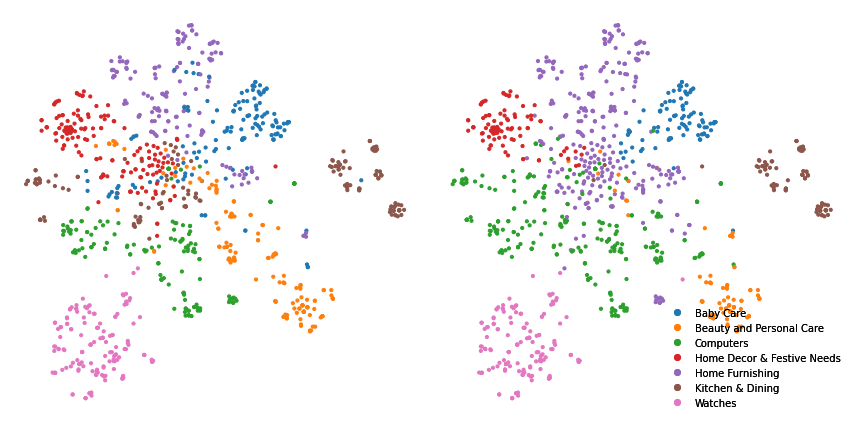

In [429]:
fig, axs = plt.subplots(1,2, figsize=(12,6))
axs[0].scatter(X_proj[:,0], X_proj[:,1], c=y, 
            cmap=ListedColormap(sns.color_palette('tab10'), N=len(set(y))), s=10)
output = axs[1].scatter(X_proj[:,0], X_proj[:,1], c=cluster_labels, 
            cmap=ListedColormap(sns.color_palette('tab10'), N=len(set(cluster_labels))), s=10)
legend1 = axs[1].legend(output.legend_elements()[0], le.inverse_transform([i for i in range(7)]),
                    loc="lower right", frameon=False)
axs[1].add_artist(legend1)
axs[0].axis('off')
axs[1].axis('off')

plt.tight_layout()

#### Confusion Matrix

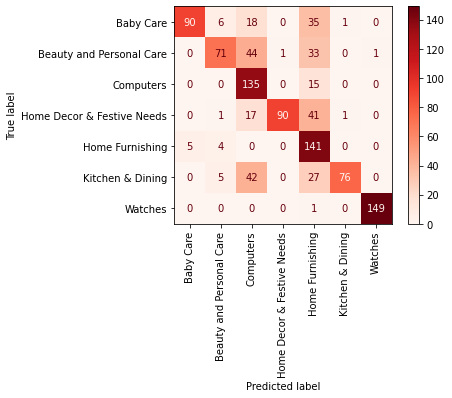

In [410]:
fig, ax = plt.subplots()
confmatrix = metrics.ConfusionMatrixDisplay.from_predictions(y, cluster_labels,
                                                             display_labels=[le.inverse_transform([i])[0] for i in range(7)],
                                                             xticks_rotation='vertical', cmap='Reds', ax=ax)

#### WordCloud

In [411]:
# Instantiate a new wordcloud.
stopwords = [key for key in set(' '.join(X[tok_ver]).split()) if key not in vocabulary_sets[data_ver+'_red'].keys()]
wordcloud = WordCloud(random_state = 8,
            normalize_plurals = False,
            width = 1000, height= 600,
            stopwords = stopwords)

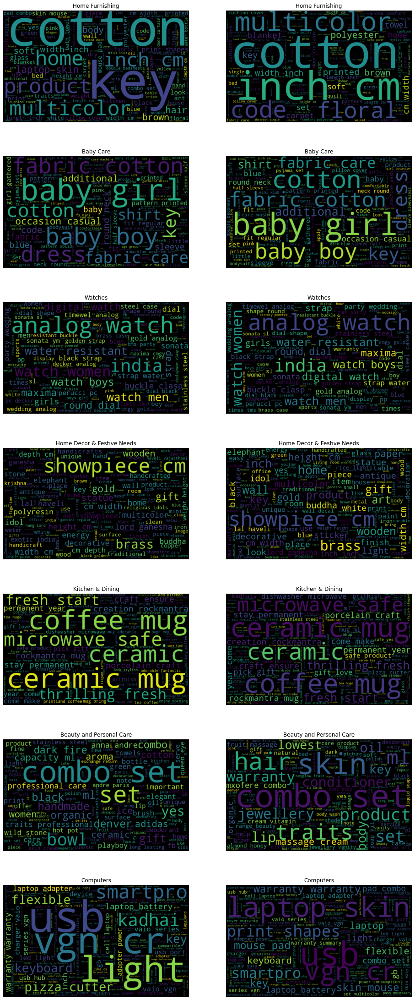

In [412]:
fig, axes = plt.subplots(7,2, figsize = (16,40))
y_cat_cl = pd.Series(le.inverse_transform(cluster_labels))
y_cat = pd.Series(le.inverse_transform(y))

categories = y_cat.unique()
for ii, cl in enumerate(categories):
    # Apply the wordcloud to the text.
    for jj, yy in enumerate([y_cat_cl, y_cat]):
        select = (yy == cl)
        wordcloud.generate(' '.join(X['spacy'][select]))
        # add interpolation = bilinear to smooth things out
        ax = axes[ii][jj]
        ax.imshow(wordcloud, interpolation='bilinear')
        ax.set_title(cl)
        # and remove the axis
        ax.axis("off")
plt.show()

### 6.4.3 Rapport Détaillé du Clustering 'SpectralClustering' avec SpaCy

In [450]:
tok_ver='spacy'
data_ver = tok_ver + '_Version2'
proj = 'TSNE1'
X_proj = X_projections[data_ver][proj]["X_proj"]

modelname = "SpecClust"
label = data_ver + '_' + modelname

#### Comparision des Labels

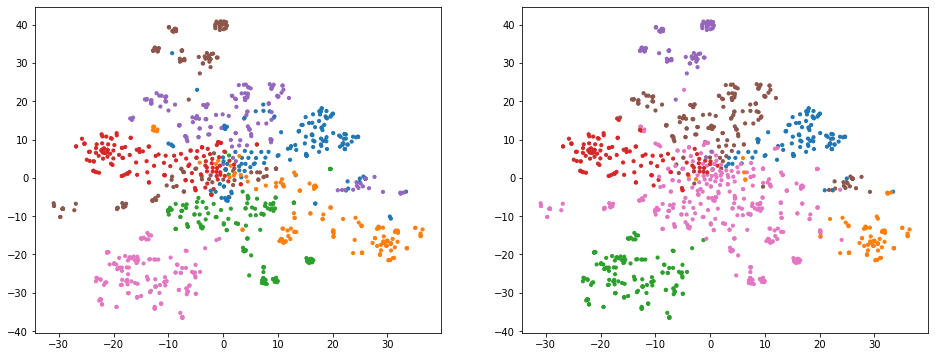

In [451]:
fig, ax = plt.subplots(1,2, figsize=(16,6))
ax[0].scatter(X_proj[:,0], X_proj[:,1], c=y, 
            cmap=ListedColormap(sns.color_palette('tab10'), N=len(set(y))), s=10)
ax[1].scatter(X_proj[:,0], X_proj[:,1], c=X_labels[label], 
            cmap=ListedColormap(sns.color_palette('tab10'), N=len(set(X_labels[label]))), s=10)
plt.show()

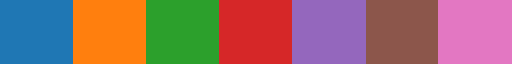

In [452]:
ListedColormap(sns.color_palette('tab10'), N=7)

In [453]:
label_dict_1 = {0:0, 1:1, 2:6, 3:3, 4:5, 5:4, 6:2}
#label_dict_1

In [454]:
cat_dict = {i:le.inverse_transform([i])[0] for i in range(7)}

In [455]:
le.inverse_transform([i for i in range(7)]) 

array(['Baby Care', 'Beauty and Personal Care', 'Computers',
       'Home Decor & Festive Needs', 'Home Furnishing',
       'Kitchen & Dining', 'Watches'], dtype=object)

#### Rapport de Classification

In [456]:
cluster_labels = pd.Series(X_labels[label]).map(label_dict_1)
print(classification_report(le.inverse_transform(y), le.inverse_transform(cluster_labels)))

                            precision    recall  f1-score   support

                 Baby Care       0.93      0.61      0.74       150
  Beauty and Personal Care       0.84      0.47      0.60       150
                 Computers       0.42      1.00      0.59       150
Home Decor & Festive Needs       0.88      0.71      0.79       150
           Home Furnishing       0.82      0.89      0.85       150
          Kitchen & Dining       0.96      0.50      0.66       150
                   Watches       1.00      0.99      1.00       150

                  accuracy                           0.74      1050
                 macro avg       0.84      0.74      0.75      1050
              weighted avg       0.84      0.74      0.75      1050



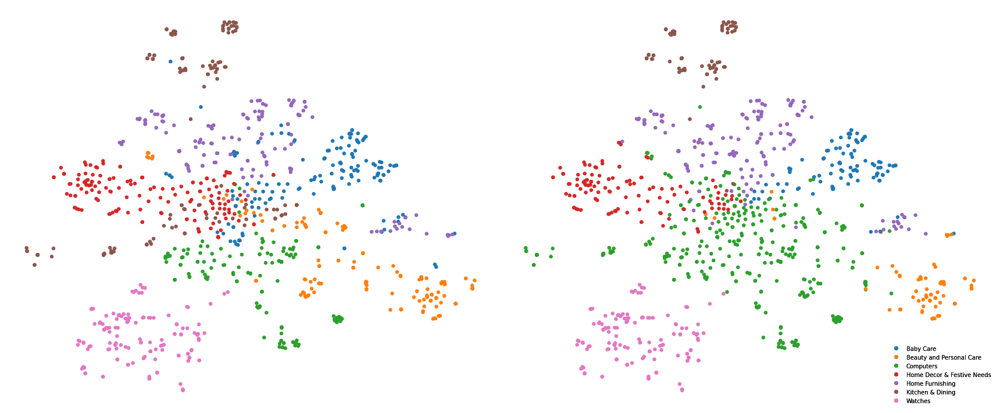

In [457]:
fig, axs = plt.subplots(1,2, figsize=(24,10))
axs[0].scatter(X_proj[:,0], X_proj[:,1], c=y, 
            cmap=ListedColormap(sns.color_palette('tab10'), N=len(set(y))), s=30)
output = axs[1].scatter(X_proj[:,0], X_proj[:,1], c=cluster_labels, 
            cmap=ListedColormap(sns.color_palette('tab10'), N=len(set(cluster_labels))), s=30)
legend1 = axs[1].legend(output.legend_elements()[0], le.inverse_transform([i for i in range(7)]),
                    loc="lower right", frameon=False)
axs[1].add_artist(legend1)
axs[0].axis('off')
axs[1].axis('off')

plt.tight_layout()

#### Confusion Matrix

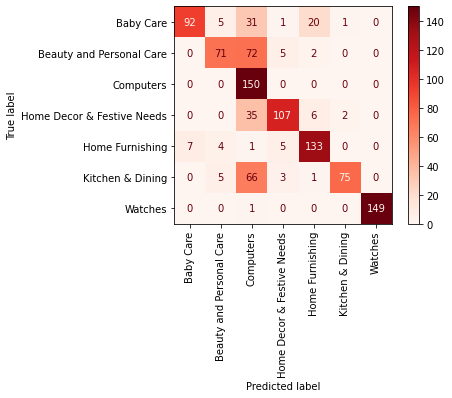

In [421]:
fig, ax = plt.subplots()
confmatrix = metrics.ConfusionMatrixDisplay.from_predictions(y, cluster_labels,
                                                             display_labels=[le.inverse_transform([i])[0] for i in range(7)],
                                                             xticks_rotation='vertical', cmap='Reds', ax=ax)

#### WordCloud

In [557]:
# Instantiate a new wordcloud.
stopwords = [key for key in set(' '.join(X[tok_ver]).split()) if key not in vocabulary_sets[data_ver+'_red'].keys()]
wordcloud = WordCloud(random_state = 8,
            normalize_plurals = False,
            width = 1000, height= 600,
            stopwords = stopwords)

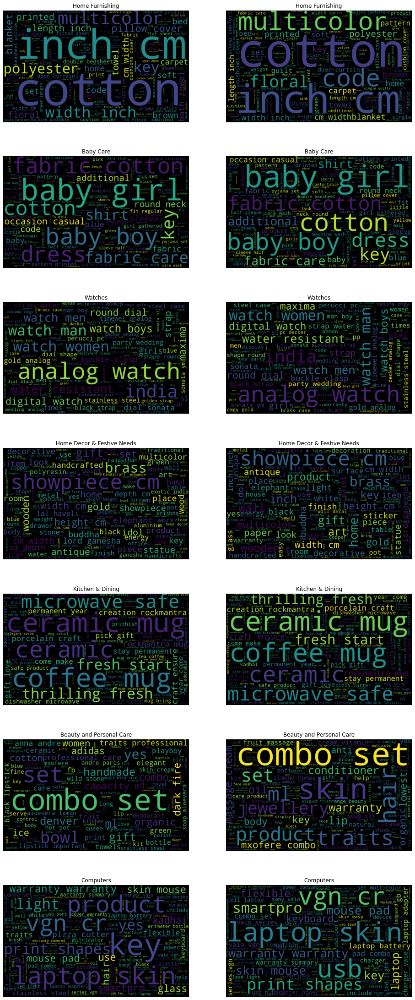

In [558]:
fig, axes = plt.subplots(7,2, figsize = (16,40))
y_cat_cl = pd.Series(le.inverse_transform(cluster_labels))
y_cat = pd.Series(le.inverse_transform(y))

categories = y_cat.unique()
for ii, cl in enumerate(categories):
    # Apply the wordcloud to the text.
    for jj, yy in enumerate([y_cat_cl, y_cat]):
        select = (yy == cl)
        wordcloud.generate(' '.join(X['spacy'][select]))
        # add interpolation = bilinear to smooth things out
        ax = axes[ii][jj]
        ax.imshow(wordcloud, interpolation='bilinear')
        ax.set_title(cl)
        # and remove the axis
        ax.axis("off")
plt.show()

# 7. La Classification des Textes

## 7.1 Train / Test

In [321]:
seed = 33
testsize = 0.2
cv = StratifiedKFold(n_splits=5, shuffle = True, random_state = seed)

In [322]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=testsize, random_state=seed, shuffle=True, stratify=y)

In [323]:
text_models = {}
text_eval_df = pd.DataFrame()

## 7.2 Les Modèles

### 7.2.1 KNeighborsClassifier

In [324]:
kn_pipeline = Pipeline(steps=[('vectorizer', CountVectorizer()),
                               ('selector', SelectFpr(chi2)),
                               ('transformer', TfidfTransformer()),
                               ('toarray', toarray_transformer),
                               ('pca', PCA()),
                               ('model', KNeighborsClassifier())
                               ])

In [325]:
modelname = "KNClass1"
param_grid = {'vectorizer__ngram_range' : [(1,1), (1,2)],
              'vectorizer__max_df' : [1.5/7, 2/7, 2.5/7],
              'vectorizer__min_df' : [0.02/7, 0.03/7, 0.05/7],
              'vectorizer__stop_words' : [[], stop_words],
              'selector__alpha' : [0.01],
              'pca__n_components' : [0.99],
              'pca__svd_solver' : ['full'],
              'model__n_neighbors' : range(3,8,2),
              'model__weights' : ['uniform', 'distance'],
              }

#### NLTK

In [326]:
modelname = "KNClass1"
tok_ver = 'nltk'
data_ver = '_'.join([tok_ver,modelname])

In [327]:
model_dict = gridsearch_evaluation(X_train[tok_ver], np.ravel(y_train), kn_pipeline, param_grid, cv = cv, 
                                   scoring_tple = ('accuracy',), refit = 'accuracy')
model_dict

Fitting 5 folds for each of 216 candidates, totalling 1080 fits


{'estimator': Pipeline(steps=[('vectorizer',
                  CountVectorizer(max_df=0.35714285714285715,
                                  min_df=0.0071428571428571435,
                                  ngram_range=(1, 2), stop_words=[])),
                 ('selector',
                  SelectFpr(alpha=0.01,
                            score_func=<function chi2 at 0x0000028F3EE9A5E0>)),
                 ('transformer', TfidfTransformer()),
                 ('toarray',
                  FunctionTransformer(accept_sparse=True,
                                      func=<function <lambda> at 0x0000028F3F3ECAF0>,
                                      inverse_func=<class 'scipy.sparse.csr.csr_matrix'>)),
                 ('pca', PCA(n_components=0.99, svd_solver='full')),
                 ('model', KNeighborsClassifier(n_neighbors=3))]),
 'eval_method': 'grid',
 'best_grid_params': {'model__n_neighbors': 3,
  'model__weights': 'uniform',
  'pca__n_components': 0.99,
  'pca__svd_solver': '

In [328]:
text_models[data_ver] = model_dict

In [329]:
clf = text_models[data_ver]["estimator"]
y_test_clf = clf.predict((X_test[tok_ver]))
score = metrics.accuracy_score(y_test, y_test_clf)
text_models[data_ver]["finaltest_score"] = score
score

0.9

#### Rapport de Classification

In [330]:
print(classification_report(le.inverse_transform(y_test), le.inverse_transform(y_test_clf)))

                            precision    recall  f1-score   support

                 Baby Care       0.76      0.83      0.79        30
  Beauty and Personal Care       0.96      0.83      0.89        30
                 Computers       0.88      0.97      0.92        30
Home Decor & Festive Needs       0.96      0.80      0.87        30
           Home Furnishing       0.84      0.90      0.87        30
          Kitchen & Dining       0.94      0.97      0.95        30
                   Watches       1.00      1.00      1.00        30

                  accuracy                           0.90       210
                 macro avg       0.91      0.90      0.90       210
              weighted avg       0.91      0.90      0.90       210



#### Confusion Matrix

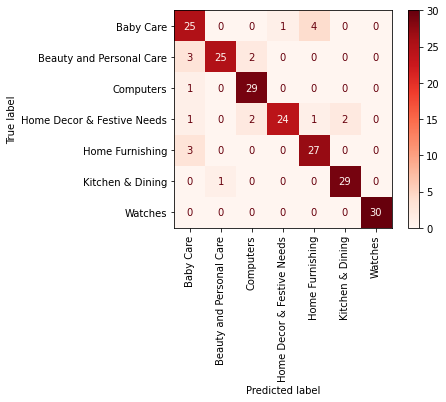

In [331]:
fig, ax = plt.subplots()
confmatrix = metrics.ConfusionMatrixDisplay.from_predictions(y_test, y_test_clf,
                                                             display_labels=[le.inverse_transform([i])[0] for i in range(7)],
                                                             xticks_rotation='vertical', cmap='Reds', ax=ax)

#### SpaCy

In [332]:
modelname = "KNClass1"
tok_ver = 'spacy'
data_ver = '_'.join([tok_ver,modelname])

In [333]:
model_dict = gridsearch_evaluation(X_train[tok_ver], np.ravel(y_train), kn_pipeline, param_grid, cv = cv, 
                                   scoring_tple = ('accuracy',), refit = 'accuracy')
model_dict

Fitting 5 folds for each of 216 candidates, totalling 1080 fits


{'estimator': Pipeline(steps=[('vectorizer',
                  CountVectorizer(max_df=0.35714285714285715,
                                  min_df=0.004285714285714286,
                                  ngram_range=(1, 2), stop_words=[])),
                 ('selector',
                  SelectFpr(alpha=0.01,
                            score_func=<function chi2 at 0x0000028F3EE9A5E0>)),
                 ('transformer', TfidfTransformer()),
                 ('toarray',
                  FunctionTransformer(accept_sparse=True,
                                      func=<function <lambda> at 0x0000028F3F3ECAF0>,
                                      inverse_func=<class 'scipy.sparse.csr.csr_matrix'>)),
                 ('pca', PCA(n_components=0.99, svd_solver='full')),
                 ('model',
                  KNeighborsClassifier(n_neighbors=3, weights='distance'))]),
 'eval_method': 'grid',
 'best_grid_params': {'model__n_neighbors': 3,
  'model__weights': 'distance',
  'pca__n_com

In [334]:
text_models[data_ver] = model_dict

In [335]:
clf = text_models[data_ver]["estimator"]
y_test_clf = clf.predict((X_test[tok_ver]))
score = metrics.accuracy_score(y_test, y_test_clf)
text_models[data_ver]["finaltest_score"] = score
score

0.919047619047619

#### Rapport de Classification

In [336]:
print(classification_report(le.inverse_transform(y_test), le.inverse_transform(y_test_clf)))

                            precision    recall  f1-score   support

                 Baby Care       0.89      0.80      0.84        30
  Beauty and Personal Care       0.93      0.93      0.93        30
                 Computers       0.88      0.97      0.92        30
Home Decor & Festive Needs       0.93      0.87      0.90        30
           Home Furnishing       0.84      0.90      0.87        30
          Kitchen & Dining       0.97      0.97      0.97        30
                   Watches       1.00      1.00      1.00        30

                  accuracy                           0.92       210
                 macro avg       0.92      0.92      0.92       210
              weighted avg       0.92      0.92      0.92       210



#### Confusion Matrix

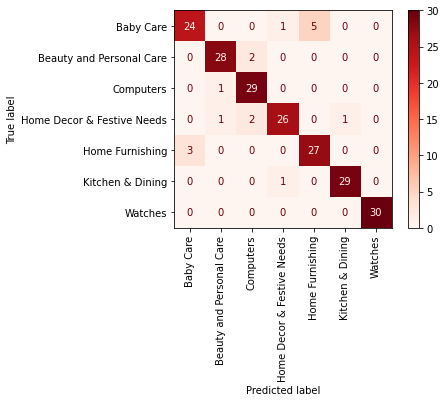

In [337]:
fig, ax = plt.subplots()
confmatrix = metrics.ConfusionMatrixDisplay.from_predictions(y_test, y_test_clf,
                                                             display_labels=[le.inverse_transform([i])[0] for i in range(7)],
                                                             xticks_rotation='vertical', cmap='Reds', ax=ax)

### 7.2.2 ComplementNB

In [374]:
cnb_pipeline = Pipeline(steps=[('vectorizer', CountVectorizer(ngram_range=(1,1), max_df=2/7, min_df=0.03/7)),
                               ('selector', SelectFpr(chi2, alpha=0.01)),
                               ('transformer', TfidfTransformer()),
                               ('selector2', SelectKBest()),
                               ('model', ComplementNB()),
                               ])

In [375]:
modelname = "ComplNB"
param_grid = {'vectorizer__ngram_range' : [(1,1), (1,2)],
              'vectorizer__max_df' : [1.5/7, 2/7, 2.5/7],
              'vectorizer__min_df' : [0.02/7, 0.03/7, 0.05/7],
              'vectorizer__stop_words' : [[], stop_words],
              'selector__alpha' : [0.01],
              'selector2__k' : ['all', 450],
              'model__alpha' : np.linspace(0.001,1,11),
             }

#### NLTK

In [376]:
modelname = "ComplNB"
tok_ver = 'nltk'
data_ver = '_'.join([tok_ver,modelname])

In [377]:
model_dict = gridsearch_evaluation(X_train['nltk'], np.ravel(y_train), cnb_pipeline, param_grid, cv = cv, 
                                   scoring_tple = ('accuracy',), refit = 'accuracy')
model_dict

Fitting 5 folds for each of 792 candidates, totalling 3960 fits


{'estimator': Pipeline(steps=[('vectorizer',
                  CountVectorizer(max_df=0.2857142857142857,
                                  min_df=0.0071428571428571435,
                                  ngram_range=(1, 2), stop_words=[])),
                 ('selector',
                  SelectFpr(alpha=0.01,
                            score_func=<function chi2 at 0x0000028F3EE9A5E0>)),
                 ('transformer', TfidfTransformer()),
                 ('selector2', SelectKBest(k='all')),
                 ('model', ComplementNB(alpha=0.8002))]),
 'eval_method': 'grid',
 'best_grid_params': {'model__alpha': 0.8002,
  'selector2__k': 'all',
  'selector__alpha': 0.01,
  'vectorizer__max_df': 0.2857142857142857,
  'vectorizer__min_df': 0.0071428571428571435,
  'vectorizer__ngram_range': (1, 2),
  'vectorizer__stop_words': []},
 'train_scores': {'accuracy': (0.95625, 0.003834553192477747)},
 'test_scores': {'accuracy': (0.9345238095238095, 0.01248581962107319)},
 'train_time': (0.05733

In [378]:
text_models[data_ver] = model_dict

In [379]:
clf = text_models[data_ver]["estimator"]
y_test_clf = clf.predict((X_test[tok_ver]))
score = metrics.accuracy_score(y_test, y_test_clf)
text_models[data_ver]["finaltest_score"] = score
score

0.9

#### Rapport de Classification

In [380]:
print(classification_report(le.inverse_transform(y_test), le.inverse_transform(y_test_clf)))

                            precision    recall  f1-score   support

                 Baby Care       0.94      0.57      0.71        30
  Beauty and Personal Care       1.00      0.90      0.95        30
                 Computers       0.86      1.00      0.92        30
Home Decor & Festive Needs       0.84      0.87      0.85        30
           Home Furnishing       0.79      1.00      0.88        30
          Kitchen & Dining       0.94      0.97      0.95        30
                   Watches       1.00      1.00      1.00        30

                  accuracy                           0.90       210
                 macro avg       0.91      0.90      0.89       210
              weighted avg       0.91      0.90      0.89       210



#### Confusion Matrix

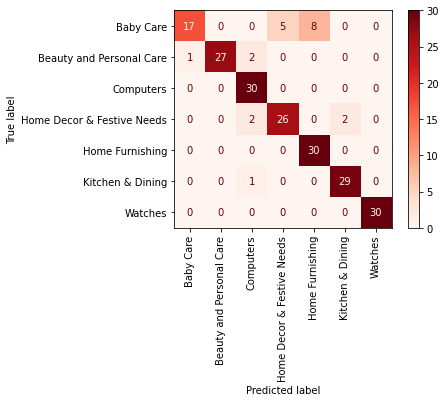

In [381]:
fig, ax = plt.subplots()
confmatrix = metrics.ConfusionMatrixDisplay.from_predictions(y_test, y_test_clf,
                                                             display_labels=[le.inverse_transform([i])[0] for i in range(7)],
                                                             xticks_rotation='vertical', cmap='Reds', ax=ax)

#### SpaCy

In [382]:
tok_ver = 'spacy'
data_ver = '_'.join([tok_ver,modelname])

In [383]:
model_dict = gridsearch_evaluation(X_train['nltk'], np.ravel(y_train), cnb_pipeline, param_grid, cv = cv, 
                                   scoring_tple = ('accuracy',), refit = 'accuracy')
model_dict

Fitting 5 folds for each of 792 candidates, totalling 3960 fits


{'estimator': Pipeline(steps=[('vectorizer',
                  CountVectorizer(max_df=0.2857142857142857,
                                  min_df=0.0071428571428571435,
                                  ngram_range=(1, 2), stop_words=[])),
                 ('selector',
                  SelectFpr(alpha=0.01,
                            score_func=<function chi2 at 0x0000028F3EE9A5E0>)),
                 ('transformer', TfidfTransformer()),
                 ('selector2', SelectKBest(k='all')),
                 ('model', ComplementNB(alpha=0.8002))]),
 'eval_method': 'grid',
 'best_grid_params': {'model__alpha': 0.8002,
  'selector2__k': 'all',
  'selector__alpha': 0.01,
  'vectorizer__max_df': 0.2857142857142857,
  'vectorizer__min_df': 0.0071428571428571435,
  'vectorizer__ngram_range': (1, 2),
  'vectorizer__stop_words': []},
 'train_scores': {'accuracy': (0.95625, 0.003834553192477747)},
 'test_scores': {'accuracy': (0.9345238095238095, 0.01248581962107319)},
 'train_time': (0.05720

In [384]:
text_models[data_ver] = model_dict

In [385]:
clf = text_models[data_ver]["estimator"]
y_test_clf = clf.predict((X_test[tok_ver]))
score = metrics.accuracy_score(y_test, y_test_clf)
text_models[data_ver]["finaltest_score"] = score
score

0.9238095238095239

#### Rapport de Classification

In [386]:
cluster_labels = clf.predict(X_test[tok_ver])
print(classification_report(le.inverse_transform(y_test), le.inverse_transform(cluster_labels)))

                            precision    recall  f1-score   support

                 Baby Care       0.95      0.70      0.81        30
  Beauty and Personal Care       1.00      0.90      0.95        30
                 Computers       0.91      1.00      0.95        30
Home Decor & Festive Needs       0.93      0.87      0.90        30
           Home Furnishing       0.79      1.00      0.88        30
          Kitchen & Dining       0.94      1.00      0.97        30
                   Watches       1.00      1.00      1.00        30

                  accuracy                           0.92       210
                 macro avg       0.93      0.92      0.92       210
              weighted avg       0.93      0.92      0.92       210



#### Confusion Matrix

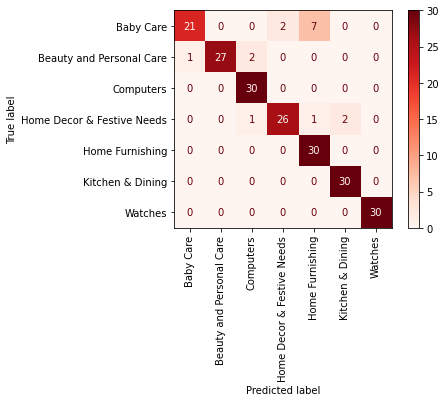

In [387]:
fig, ax = plt.subplots()
confmatrix = metrics.ConfusionMatrixDisplay.from_predictions(y_test, y_test_clf,
                                                             display_labels=[le.inverse_transform([i])[0] for i in range(7)],
                                                             xticks_rotation='vertical', cmap='Reds', ax=ax)

### 7.2.3 MultinomialNB

In [388]:
mnb_pipeline = Pipeline(steps=[('vectorizer', CountVectorizer()),
                               ('selector', SelectFpr(chi2)),
                               ('transformer', TfidfTransformer()),
                               ('selector2', SelectKBest()),
                               ('model', MultinomialNB()),
                               ])

In [389]:
modelname = "MultNB"
param_grid = {'vectorizer__ngram_range' : [(1,1), (1,2)],
              'vectorizer__max_df' : [1.5/7, 2/7, 2.5/7],
              'vectorizer__min_df' : [0.02/7, 0.03/7, 0.05/7],
              'vectorizer__stop_words' : [[], stop_words],
              'selector__alpha' : [0.01],
              'selector2__k' : ['all', 450],
              'model__alpha' : np.linspace(0.0005,0.5,11),
             }

#### NLTK

In [390]:
tok_ver = 'nltk'
data_ver = '_'.join([tok_ver,modelname])

In [391]:
model_dict = gridsearch_evaluation(X_train['nltk'], np.ravel(y_train), mnb_pipeline, param_grid, cv = cv, 
                                   scoring_tple = ('accuracy',), refit = 'accuracy')
model_dict

Fitting 5 folds for each of 792 candidates, totalling 3960 fits


{'estimator': Pipeline(steps=[('vectorizer',
                  CountVectorizer(max_df=0.21428571428571427,
                                  min_df=0.002857142857142857,
                                  ngram_range=(1, 2), stop_words=[])),
                 ('selector',
                  SelectFpr(alpha=0.01,
                            score_func=<function chi2 at 0x0000028F3EE9A5E0>)),
                 ('transformer', TfidfTransformer()),
                 ('selector2', SelectKBest(k='all')),
                 ('model', MultinomialNB(alpha=0.0005))]),
 'eval_method': 'grid',
 'best_grid_params': {'model__alpha': 0.0005,
  'selector2__k': 'all',
  'selector__alpha': 0.01,
  'vectorizer__max_df': 0.21428571428571427,
  'vectorizer__min_df': 0.002857142857142857,
  'vectorizer__ngram_range': (1, 2),
  'vectorizer__stop_words': []},
 'train_scores': {'accuracy': (0.9800595238095238, 0.00437408882639855)},
 'test_scores': {'accuracy': (0.9321428571428572, 0.013363062095621223)},
 'train_tim

In [392]:
text_models[data_ver] = model_dict

In [393]:
clf = text_models[data_ver]["estimator"]
y_test_clf = clf.predict((X_test[tok_ver]))
score = metrics.accuracy_score(y_test, y_test_clf)
text_models[data_ver]["finaltest_score"] = score
score

0.9095238095238095

#### Rapport de Classification

In [394]:
cluster_labels = clf.predict(X_test[tok_ver])
print(classification_report(le.inverse_transform(y_test), le.inverse_transform(cluster_labels)))

                            precision    recall  f1-score   support

                 Baby Care       0.90      0.63      0.75        30
  Beauty and Personal Care       1.00      0.93      0.97        30
                 Computers       0.88      0.97      0.92        30
Home Decor & Festive Needs       0.87      0.87      0.87        30
           Home Furnishing       0.83      1.00      0.91        30
          Kitchen & Dining       0.91      1.00      0.95        30
                   Watches       1.00      0.97      0.98        30

                  accuracy                           0.91       210
                 macro avg       0.91      0.91      0.91       210
              weighted avg       0.91      0.91      0.91       210



#### Confusion Matrix

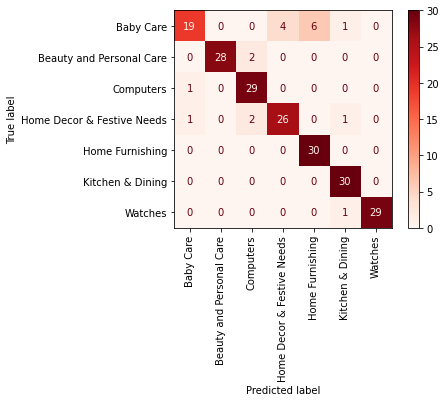

In [395]:
fig, ax = plt.subplots()
confmatrix = metrics.ConfusionMatrixDisplay.from_predictions(y_test, y_test_clf,
                                                             display_labels=[le.inverse_transform([i])[0] for i in range(7)],
                                                             xticks_rotation='vertical', cmap='Reds', ax=ax)

#### Spacy

In [396]:
tok_ver = 'spacy'
data_ver = '_'.join([tok_ver,modelname])

In [397]:
model_dict = gridsearch_evaluation(X_train['nltk'], np.ravel(y_train), mnb_pipeline, param_grid, cv = cv, 
                                   scoring_tple = ('accuracy',), refit = 'accuracy')
model_dict

Fitting 5 folds for each of 792 candidates, totalling 3960 fits


{'estimator': Pipeline(steps=[('vectorizer',
                  CountVectorizer(max_df=0.21428571428571427,
                                  min_df=0.002857142857142857,
                                  ngram_range=(1, 2), stop_words=[])),
                 ('selector',
                  SelectFpr(alpha=0.01,
                            score_func=<function chi2 at 0x0000028F3EE9A5E0>)),
                 ('transformer', TfidfTransformer()),
                 ('selector2', SelectKBest(k='all')),
                 ('model', MultinomialNB(alpha=0.0005))]),
 'eval_method': 'grid',
 'best_grid_params': {'model__alpha': 0.0005,
  'selector2__k': 'all',
  'selector__alpha': 0.01,
  'vectorizer__max_df': 0.21428571428571427,
  'vectorizer__min_df': 0.002857142857142857,
  'vectorizer__ngram_range': (1, 2),
  'vectorizer__stop_words': []},
 'train_scores': {'accuracy': (0.9800595238095238, 0.00437408882639855)},
 'test_scores': {'accuracy': (0.9321428571428572, 0.013363062095621223)},
 'train_tim

In [398]:
text_models[data_ver] = model_dict

In [399]:
clf = text_models[data_ver]["estimator"]
y_test_clf = clf.predict((X_test[tok_ver]))
score = metrics.accuracy_score(y_test, y_test_clf)
text_models[data_ver]["finaltest_score"] = score
score

0.919047619047619

#### Rapport de Classification

In [400]:
cluster_labels = clf.predict(X_test[tok_ver])
print(classification_report(le.inverse_transform(y_test), le.inverse_transform(cluster_labels)))

                            precision    recall  f1-score   support

                 Baby Care       0.92      0.73      0.81        30
  Beauty and Personal Care       1.00      0.93      0.97        30
                 Computers       0.88      0.93      0.90        30
Home Decor & Festive Needs       0.96      0.87      0.91        30
           Home Furnishing       0.81      1.00      0.90        30
          Kitchen & Dining       0.91      1.00      0.95        30
                   Watches       1.00      0.97      0.98        30

                  accuracy                           0.92       210
                 macro avg       0.92      0.92      0.92       210
              weighted avg       0.92      0.92      0.92       210



#### Confusion Matrix

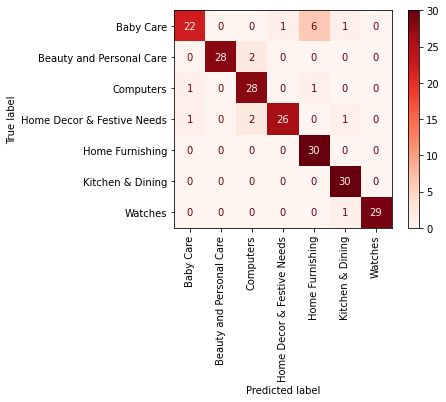

In [401]:
fig, ax = plt.subplots()
confmatrix = metrics.ConfusionMatrixDisplay.from_predictions(y_test, y_test_clf,
                                                             display_labels=[le.inverse_transform([i])[0] for i in range(7)],
                                                             xticks_rotation='vertical', cmap='Reds', ax=ax)

# END